In [1]:
import pickle
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from scipy.signal import medfilt
impo
import os

2024-12-19 15:46:34.398592: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-19 15:46:34.407114: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1734623194.415793 3609823 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1734623194.418359 3609823 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-19 15:46:34.428754: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

In [4]:
def load_pickle(file_path):
    try:
        print(f"Loading: {file_path}")
        with open(file_path, 'rb') as f:
            return pickle.load(f)
    except Exception as e:
        print(f"Error loading {file_path}: {e}")
        return None
path_afib_aflt = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/X_afib_aflt.pkl'
path_norm = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/X_norm.pkl'
path_y_afib_aflt = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/Y_afib_aflt.pkl'
path_y_norm = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/Y_norm.pkl'

X_afib_aflt = load_pickle(path_afib_aflt)
X_norm = load_pickle(path_norm)
Y_afib_aflt = load_pickle(path_y_afib_aflt)
Y_norm = load_pickle(path_y_norm)
if X_afib_aflt is not None:
    print("X_afib_aflt:", type(X_afib_aflt), len(X_afib_aflt))
if X_norm is not None:
    print("X_norm:", type(X_norm), len(X_norm))
if Y_afib_aflt is not None:
    print("Y_afib_aflt:", type(Y_afib_aflt), len(Y_afib_aflt))
if Y_norm is not None:
    print("Y_norm:", type(Y_norm), len(Y_norm))

Loading: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/X_afib_aflt.pkl
Loading: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/X_norm.pkl
Loading: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/Y_afib_aflt.pkl
Loading: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/Y_norm.pkl
X_afib_aflt: <class 'numpy.ndarray'> 1570
X_norm: <class 'numpy.ndarray'> 9069
Y_afib_aflt: <class 'pandas.core.frame.DataFrame'> 1570
Y_norm: <class 'pandas.core.frame.DataFrame'> 9069


In [5]:
labels_norm = np.array([row for row in Y_norm['diagnostic_superclass']])

#  Randomly select 2000 samples
num_samples = 2000
random_indices = np.random.choice(len(X_norm), num_samples, replace=False)

norm_ecgs = X_norm[random_indices]
norm_labels = labels_norm[random_indices]
Y_afib_aflt = Y_afib_aflt[["diagnostic_superclass"]]
Y_afib_aflt["diagnostic_superclass"] = "AF"
Y_afib_aflt = Y_afib_aflt.to_numpy().reshape(-1, 1)
ecg_signals = np.concatenate((norm_ecgs, X_afib_aflt), axis=0)

ecgs_labels = np.concatenate((norm_labels, Y_afib_aflt), axis=0)

print(f"Combined ECG signals shape: {ecg_signals.shape}")
print(f"Combined labels shape: {ecgs_labels.shape}")

Combined ECG signals shape: (3570, 1000, 12)
Combined labels shape: (3570, 1)


In [6]:
# Use only Lead II (second column of ECG signals)
lead_II = ecg_signals[:, :, 1:2]  # Shape: (samples, timesteps, 1)
scaler = StandardScaler()
X_normalized = scaler.fit_transform(lead_II.reshape(-1, 1)).reshape(lead_II.shape)
# Median Filtering
window_size = 5
X_filtered = np.array([medfilt(x.squeeze(), kernel_size=window_size) for x in X_normalized])
X_filtered = X_filtered[..., np.newaxis]  # Reshape to (samples, timesteps, 1)
# Segment the signals
segment_length = 1000
X_segmented = np.array([
    x[i:i + segment_length] for x in X_filtered for i in range(0, len(x) - segment_length + 1, segment_length)
])
# Convert 'NORM' to 0 and 'AF' to 1
ecgs_labels_numeric = np.where(ecgs_labels == 'NORM', 0, 1)

# Step 1: Split into training (64%) and temporary (36%) datasets
X_train, X_temp, y_train, y_temp = train_test_split(X_segmented, ecgs_labels_numeric, 
                                                    test_size=0.36, random_state=42, 
                                                    stratify=ecgs_labels)

# Step 2: Split the temporary dataset into validation (25%) and test (20%) datasets
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, 
                                                test_size=0.5556, random_state=42, 
                                                stratify=y_temp)

# Step 3: Verify the class distributions in each dataset
print("Training set class distribution:", dict(zip(*np.unique(y_train, return_counts=True))))
print("Validation set class distribution:", dict(zip(*np.unique(y_val, return_counts=True))))
print("Test set class distribution:", dict(zip(*np.unique(y_test, return_counts=True))))

Training set class distribution: {np.int64(0): np.int64(1280), np.int64(1): np.int64(1004)}
Validation set class distribution: {np.int64(0): np.int64(320), np.int64(1): np.int64(251)}
Test set class distribution: {np.int64(0): np.int64(400), np.int64(1): np.int64(315)}


In [7]:
mean = np.mean(X_train, axis=(0, 1))
std = np.std(X_train, axis=(0, 1))
ECGs = (X_train - mean) / std

mean_v = np.mean(X_val, axis=(0, 1))
std_v = np.std(X_val, axis=(0, 1))
ECGs_val = (X_val - mean_v) / std_v

mean_t = np.mean(X_test, axis=(0, 1))
std_t = np.std(X_test, axis=(0, 1))
ECGs_test= (X_test - mean_t) / std_t

In [8]:
def compare_real_and_gen_ecg(generated_ecg, ECGs):
    """Plot real and generated ECGs side by side"""
    plt.figure(figsize=(24, 4))
    
    # Plot generated ECG
    plt.subplot(1, 2, 1)
    plt.title("Generated (fake) ECG", fontsize=16)
    plt.plot(generated_ecg[0, :, 0])  # Assuming 1 lead (index 0)
    
    # Plot real ECG
    plt.subplot(1, 2, 2)
    plt.title("Real ECG", fontsize=16)
    rand_idx = np.random.choice(np.arange(len(ECGs)))
    plt.plot(ECGs[rand_idx, :, 0])  # Assuming 1 lead (index 0)
    
    plt.show()
def generate_latent_points(latent_dim, n_samples):
    x_latent = np.random.randn(n_samples, latent_dim)
    return x_latent

def generate_fake_samples(latent_dim, generator, n):
    x_input = generate_latent_points(latent_dim, n)
    labels = np.random.randint(0, 2, n)
    labels = np.expand_dims(labels, axis=-1)
    X = generator.predict([x_input, labels])
    y = np.zeros((n, 1))
    return X, y

def generate_real_samples(ecgsignal, y_train, n):
    indices = np.random.choice(min(ecgsignal.shape[0], y_train.shape[0]), n, replace=False)
    X = ecgsignal[indices]
    y = y_train[indices]
    y = np.expand_dims(y, axis=-1) if len(y.shape) == 1 else y
    return X, y

def smooth_positive_labels(y):
    return y - 0.05 + (tf.random.uniform(y.shape) * 0.1)

def smooth_negative_labels(y):
    return y + (tf.random.uniform(y.shape) * 0.1)

# Updated Gradient Penalty Layer
class GradientPenaltyLayer(tf.keras.layers.Layer):
    def __init__(self, discriminator, **kwargs):
        super(GradientPenaltyLayer, self).__init__(**kwargs)
        self.discriminator = discriminator

    def call(self, real, fake, labels_tensor):
        alpha = tf.random.uniform([real.shape[0], 1, 1], 0.0, 1.0)
        diff = fake - real
        interpolated = real + alpha * diff
        with tf.GradientTape() as tape:
            tape.watch(interpolated)
            pred = self.discriminator([interpolated, labels_tensor])
        grads = tape.gradient(pred, [interpolated])[0]
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2]) + 1e-10)
        gradient_penalty = tf.reduce_mean((norm - 1.0) ** 2)
        return gradient_penalty

def temporal_coherence_loss(real_data, generated_data):
    diff_real = real_data[:, 1:, :] - real_data[:, :-1, :]
    diff_fake = generated_data[:, 1:, :] - generated_data[:, :-1, :]
    return tf.reduce_mean(tf.square(diff_real - diff_fake))

In [9]:
def _inception_module(
    input_tensor,
    stride=1,
    activation="linear",
    use_bottleneck=True,
    kernel_size=40,
    bottleneck_size=16,  # Reduce bottleneck size
    nb_filters=16,       # Reduce the number of filters
):

    if use_bottleneck and int(input_tensor.shape[-1]) > 1:
        input_inception = tf.keras.layers.Conv1D(
            filters=bottleneck_size,
            kernel_size=1,
            padding="same",
            activation=activation,
            use_bias=False,
        )(input_tensor)
    else:
        input_inception = input_tensor

    # Simplify kernel sizes
    kernel_size_s = [kernel_size // (2**i) for i in range(2)]

    conv_list = []

    for i in range(len(kernel_size_s)):
         conv_list.append(
            tf.keras.layers.Conv1D(
                filters=nb_filters,
                kernel_size=kernel_size_s[i],
                strides=stride,
                padding="same",
                activation=activation,
                use_bias=False,
            )(input_inception)
        )

    max_pool_1 = tf.keras.layers.MaxPool1D(pool_size=3, strides=stride, padding="same")(
        input_tensor
    )

    conv_6 = tf.keras.layers.Conv1D(
        filters=nb_filters,
        kernel_size=1,
        padding="same",
        activation=activation,
        use_bias=False,
    )(max_pool_1)

    conv_list.append(conv_6)
    x = tf.keras.layers.Concatenate(axis=2)(conv_list)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation(activation="relu")(x)
    return x
def _shortcut_layer(input_tensor, out_tensor):
    shortcut_y = tf.keras.layers.Conv1D(
        filters=int(out_tensor.shape[-1]), kernel_size=1, padding="same", use_bias=False
    )(input_tensor)
    shortcut_y = tf.keras.layers.BatchNormalization()(shortcut_y)

    x = tf.keras.layers.Add()([shortcut_y, out_tensor])
    x = tf.keras.layers.Activation("relu")(x)
    return x
def self_attention_layer(x, filters):
    f = tf.keras.layers.Conv1D(filters // 8, 1, activation='relu')(x)  # Query
    g = tf.keras.layers.Conv1D(filters // 8, 1, activation='relu')(x)  # Key
    h = tf.keras.layers.Conv1D(filters, 1, activation='relu')(x)       # Value

    attention_map = tf.keras.layers.Softmax()(tf.keras.layers.Dot(axes=[2, 2])([f, g]))
    attention_out = tf.keras.layers.Dot(axes=[2, 1])([attention_map, h])

    return tf.keras.layers.Add()([x, attention_out])  # Residual connection
def feature_matching_loss(real_output, fake_output):
    return tf.reduce_mean(tf.abs(tf.reduce_mean(real_output, axis=0) - tf.reduce_mean(fake_output, axis=0)))

In [10]:
def con_generator(latent_dim=12):
    noise_input = tf.keras.layers.Input(shape=(latent_dim,))
    label_input = tf.keras.layers.Input(shape=(1,), dtype='int32')
    
    # Label embedding
    label_embedding = tf.keras.layers.Embedding(2, latent_dim)(label_input)
    merged_input = tf.keras.layers.Concatenate(axis=1)([noise_input, tf.keras.layers.Flatten()(label_embedding)])
    
    # Fully connected 
    x = tf.keras.layers.Dense(64 * 1000, use_bias=False)(merged_input)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    x = tf.keras.layers.Reshape((1000, 64))(x)
    
    # First 
    x = tf.keras.layers.Conv1DTranspose(512, kernel_size=7, strides=1, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    
    # Second Transposed Convolution Layer
    x = tf.keras.layers.Conv1DTranspose(256, kernel_size=7, strides=1, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    
    # Self-Attention Block
    attention = tf.keras.layers.Attention()([x, x])
    x = tf.keras.layers.Add()([x, attention])
    
    # Third  Convolution Layer
    x = tf.keras.layers.Conv1DTranspose(128, kernel_size=5, strides=1, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    
    # Thfourth  Convolution Layer
    x = tf.keras.layers.Conv1DTranspose(64, kernel_size=5, strides=1, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    
    # Fifth  Convolution Layer
    x = tf.keras.layers.Conv1DTranspose(32, kernel_size=3, strides=1, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)
    
    # Output layer (final resolution)
    output = tf.keras.layers.Conv1DTranspose(1, kernel_size=3, strides=1, padding='same', activation='tanh')(x)
    
    model = tf.keras.models.Model(inputs=[noise_input, label_input], outputs=output)
    return model


In [11]:
def con_discriminator(input_shape=(1000, 1), depth=2, use_residual=True):
    input_layer = tf.keras.layers.Input(shape=input_shape)
    label_input = tf.keras.layers.Input(shape=(1,), dtype='int32')
  
    label_embedding = tf.keras.layers.Embedding(2, np.prod(input_shape))(label_input)
    label_embedding = tf.keras.layers.Reshape(input_shape)(label_embedding)
    merged_input = tf.keras.layers.Concatenate(axis=-1)([input_layer, label_embedding])
    
    x = merged_input
    input_res = merged_input
    feature_outputs = []  # Store intermediate features for feature matching loss

    # Add convolutional and residual blocks
    for d in range(depth):
        x = tf.keras.layers.Conv1D(filters=64 * (d + 1), kernel_size=3, padding="same", activation="relu")(x)
        x = tf.keras.layers.BatchNormalization()(x)
        
        if d % 2 == 1:  # Residual connection every second layer
            x = _shortcut_layer(input_res, x)
            input_res = x
        
        feature_outputs.append(x)  
    
    # Global average pooling for classification
    gap = tf.keras.layers.GlobalAveragePooling1D()(x)
    output_layer = tf.keras.layers.Dense(units=1, activation='sigmoid')(gap)
    
    model = tf.keras.models.Model(inputs=[input_layer, label_input], outputs=[output_layer] + feature_outputs)
    model.compile(
        loss=tf.keras.losses.BinaryCrossentropy(),
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001),
        metrics=['accuracy'],
    )
    return model

In [12]:
latent_dim=12
con_gen = con_generator()
print("Generator architecture:")
print(con_gen.summary())
con_desc = con_discriminator()
print("Discriminator architecture:")
print(con_desc.summary())

I0000 00:00:1734623354.647045 3609823 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22287 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4090, pci bus id: 0000:01:00.0, compute capability: 8.9


Generator architecture:


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 1, 12)     │         24 │ input_layer_1[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer         │ (None, 12)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten (Flatten)   │ (None, 12)        │          0 │ embedding[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 24)        │          0 │ input_layer[0][0… │
│ (Concatenate)       │                   │            │ flatten[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 64000)     │  1,536,000 │ concatenate[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 64000)     │    256,000 │ dense[0][0]       │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 64000)     │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape (Reshape)   │ (None, 1000, 64)  │          0 │ leaky_re_lu[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose    │ (None, 1000, 512) │    229,376 │ reshape[0][0]     │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 1000, 512) │      2,048 │ conv1d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 1000, 512) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_1  │ (None, 1000, 256) │    917,504 │ leaky_re_lu_1[0]… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 1000, 256) │      1,024 │ conv1d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 1000, 256) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attention           │ (None, 1000, 256) │          0 │ leaky_re_lu_2[0]… │
│ (Attention)         │                   │            │ leaky_re_lu_2[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 1000, 256) │          0 │ leaky_re_lu_2[0]… │
│                     │                   │            │ attention[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_2  │ (None, 1000, 128) │    163,840 │ add[0][0]       

 Total params: 3,153,913 (12.03 MB)

 Trainable params: 3,023,929 (11.54 MB)

 Non-trainable params: 129,984 (507.75 KB)

None
Discriminator architecture:


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 1)         │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_1         │ (None, 1, 1000)   │      2,000 │ input_layer_3[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_2       │ (None, 1000, 1)   │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_1 (Reshape) │ (None, 1000, 1)   │          0 │ embedding_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 1000, 2)   │          0 │ input_layer_2[0]… │
│ (Concatenate)       │                   │            │ reshape_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d (Conv1D)     │ (None, 1000, 64)  │        448 │ concatenate_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 1000, 64)  │        256 │ conv1d[0][0]      │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_2 (Conv1D)   │ (None, 1000, 128) │        256 │ concatenate_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_1 (Conv1D)   │ (None, 1000, 128) │     24,704 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 1000, 128) │        512 │ conv1d_2[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 1000, 128) │        512 │ conv1d_1[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 1000, 128) │          0 │ batch_normalizat… │
│                     │                   │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 1000, 128) │          0 │ add_1[0][0]       │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_average_poo… │ (None, 128)       │          0 │ activation[0][0]  │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 1)         │        129 │ global_average_p… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 28,817 (112.57 KB)

 Trainable params: 28,177 (110.07 KB)

 Non-trainable params: 640 (2.50 KB)

None


In [13]:
def augment_ecg(data):
    noise = tf.random.normal(data.shape, mean=0.0, stddev=0.01)
    return data + noise

def wasserstein_loss(y_true, y_pred):
    y_true = tf.reshape(y_true, [-1, 1])  # Ensure shape [batch_size, 1]
    y_pred = tf.reshape(y_pred, [-1, 1])  # Ensure shape [batch_size, 1]
    return tf.reduce_mean(y_true * y_pred)

def apply_gradients_with_clipping(optimizer, gradients, variables, clip_value):
    clipped_gradients = [tf.clip_by_value(grad, -clip_value, clip_value) for grad in gradients]
    optimizer.apply_gradients(zip(clipped_gradients, variables))

def sample_latent_space(batch_size, latent_dim):
    return tf.random.normal([batch_size, latent_dim])

def gradient_penalty(real_data, fake_data, labels, discriminator, lambda_gp=10.0):
 
    alpha = tf.random.uniform(shape=[real_data.shape[0], 1, 1], minval=0.0, maxval=1.0)
    interpolated = alpha * real_data + (1 - alpha) * fake_data
    with tf.GradientTape() as tape:
        tape.watch(interpolated)
        predictions = discriminator([interpolated, labels], training=True)

    gradients = tape.gradient(predictions, interpolated)
    gradient_norm = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2]))
    penalty = tf.reduce_mean((gradient_norm - 1.0) ** 2)
    return lambda_gp * penalty


In [14]:
init_lr_desc = 0.0001
init_lr_gen = 0.0001
opt_desc = tf.keras.optimizers.Adam(learning_rate=init_lr_desc, beta_1=0.5, beta_2=0.9)
opt_gen = tf.keras.optimizers.Adam(learning_rate=init_lr_gen, beta_1=0.5, beta_2=0.9)
gradient_penalty_layer = GradientPenaltyLayer(con_desc)

accu_loss_gan = []
accu_loss_desc = []

batch_size = 64
steps_per_epoch = len(ECGs) // batch_size
half_batch = batch_size // 2
epochs = 3000
from tensorflow.keras.callbacks import Callback
class CustomReduceLROnPlateau(tf.keras.callbacks.Callback):
    def __init__(self, optimizer, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1):
        super(CustomReduceLROnPlateau, self).__init__()
        self.optimizer = optimizer
        self.monitor = monitor
        self.factor = factor
        self.patience = patience
        self.min_lr = min_lr
        self.verbose = verbose
        self.best = np.inf  # Changed from np.Inf to np.inf
        self.wait = 0

    def on_epoch_end(self, epoch, logs=None):
        current = logs.get(self.monitor)
        if current is None:
            return

        if np.less(current, self.best):
            self.best = current
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                # Get the current learning rate value
                old_lr = self.optimizer.learning_rate.numpy()  # Directly access the learning rate
                if old_lr > self.min_lr:
                    new_lr = max(old_lr * self.factor, self.min_lr)
                    # Update the learning rate directly
                    self.optimizer.learning_rate = new_lr
                    if self.verbose > 0:
                        print(f'\nEpoch {epoch + 1}: ReduceLROnPlateau reducing learning rate to {new_lr}.')
                self.wait = 0

# Create instances of the modified CustomReduceLROnPlateau for the generators and discriminators
reduce_lr_gen = CustomReduceLROnPlateau(opt_gen, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1)
reduce_lr_desc = CustomReduceLROnPlateau(opt_desc, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1)


lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.00001, 
    decay_steps=500, 
    decay_rate=0.5, 
    staircase=True
)
opt_gen = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
opt_desc = tf.keras.optimizers.Adam(learning_rate=lr_schedule)

gradient_penalty_layer = GradientPenaltyLayer(con_desc)

Epoch 1/3000


I0000 00:00:1734623400.634797 3609823 cuda_dnn.cc:529] Loaded cuDNN version 90300


Generator loss: 0.6929276585578918
Discriminator loss: 62874900.0
-------------------
Epoch 2/3000
Generator loss: 0.653810977935791
Discriminator loss: 39418292.0
-------------------
Epoch 3/3000
Generator loss: 0.6088874340057373
Discriminator loss: 30162680.0
-------------------
Epoch 4/3000
Generator loss: 0.657505214214325
Discriminator loss: 27707592.0
-------------------
Epoch 5/3000
Generator loss: 0.6355372667312622
Discriminator loss: 28045144.0
-------------------
Epoch 6/3000
Generator loss: 0.5925304293632507
Discriminator loss: 19845088.0
-------------------
Epoch 7/3000
Generator loss: 0.601352334022522
Discriminator loss: 16106024.0
-------------------
Epoch 8/3000
Generator loss: 0.5806812047958374
Discriminator loss: 11607744.0
-------------------
Epoch 9/3000
Generator loss: 0.5794296860694885
Discriminator loss: 12809175.0
-------------------
Epoch 10/3000
Generator loss: 0.616622805595398
Discriminator loss: 18644588.0
-------------------
Epoch 11/3000
Generator lo

I0000 00:00:1734624021.831114 3616181 service.cc:148] XLA service 0x791264004740 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734624021.831133 3616181 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce RTX 4090, Compute Capability 8.9
2024-12-19 16:00:21.838495: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


I0000 00:00:1734624022.098645 3616181 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


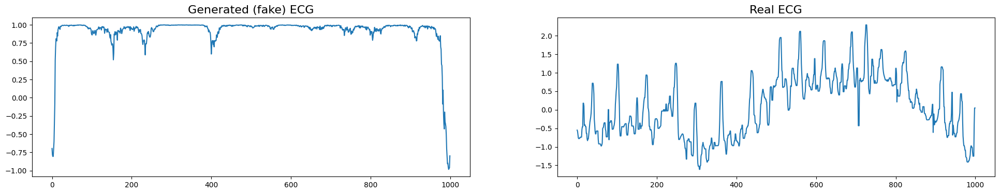

Epoch 51/3000
Generator loss: 0.5456298589706421
Discriminator loss: 10089160.0
-------------------
Epoch 52/3000
Generator loss: 0.5925862789154053
Discriminator loss: 12117285.0
-------------------
Epoch 53/3000
Generator loss: 0.5362266302108765
Discriminator loss: 9199772.0
-------------------
Epoch 54/3000
Generator loss: 0.5111598968505859
Discriminator loss: 9706178.0
-------------------

Epoch 54: ReduceLROnPlateau reducing learning rate to 2.499999936844688e-05.
Epoch 55/3000
Generator loss: 0.5594242811203003
Discriminator loss: 11970284.0
-------------------
Epoch 56/3000
Generator loss: 0.5947310924530029
Discriminator loss: 8992561.0
-------------------
Epoch 57/3000
Generator loss: 0.5979178547859192
Discriminator loss: 10085991.0
-------------------
Epoch 58/3000
Generator loss: 0.5468483567237854
Discriminator loss: 11189948.0
-------------------
Epoch 59/3000
Generator loss: 0.5536627769470215
Discriminator loss: 10742655.0
-------------------
Epoch 60/3000
Generator l

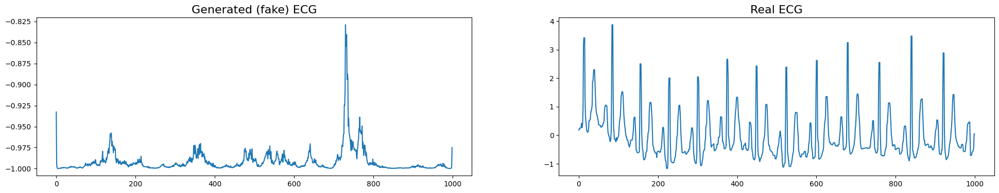

Epoch 101/3000
Generator loss: 0.5521514415740967
Discriminator loss: 8636198.0
-------------------
Epoch 102/3000
Generator loss: 0.5595123171806335
Discriminator loss: 8790946.0
-------------------
Epoch 103/3000
Generator loss: 0.5387458801269531
Discriminator loss: 11296260.0
-------------------
Epoch 104/3000
Generator loss: 0.5524165630340576
Discriminator loss: 11567836.0
-------------------
Epoch 105/3000
Generator loss: 0.5500811338424683
Discriminator loss: 10216730.0
-------------------
Epoch 106/3000
Generator loss: 0.5469533205032349
Discriminator loss: 9102549.0
-------------------
Epoch 107/3000
Generator loss: 0.5156877636909485
Discriminator loss: 9738290.0
-------------------
Epoch 108/3000
Generator loss: 0.5842186212539673
Discriminator loss: 13018912.0
-------------------
Epoch 109/3000
Generator loss: 0.585263729095459
Discriminator loss: 11548329.0
-------------------
Epoch 110/3000
Generator loss: 0.5588339567184448
Discriminator loss: 8776314.0
----------------

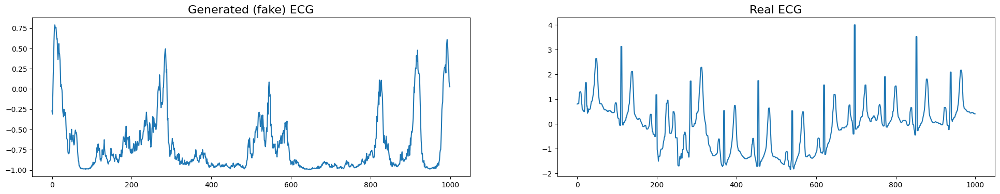

Epoch 151/3000
Generator loss: 0.5563769936561584
Discriminator loss: 10375156.0
-------------------
Epoch 152/3000
Generator loss: 0.5725338459014893
Discriminator loss: 8311299.5
-------------------
Epoch 153/3000
Generator loss: 0.5880135297775269
Discriminator loss: 11159666.0
-------------------
Epoch 154/3000
Generator loss: 0.5726279616355896
Discriminator loss: 8035911.5
-------------------
Epoch 155/3000
Generator loss: 0.5734540820121765
Discriminator loss: 13102122.0
-------------------
Epoch 156/3000
Generator loss: 0.5931503176689148
Discriminator loss: 11504631.0
-------------------
Epoch 157/3000
Generator loss: 0.5765071511268616
Discriminator loss: 10502052.0
-------------------
Epoch 158/3000
Generator loss: 0.5104445219039917
Discriminator loss: 10365422.0
-------------------
Epoch 159/3000
Generator loss: 0.5364046096801758
Discriminator loss: 8869438.0
-------------------
Epoch 160/3000
Generator loss: 0.5702453851699829
Discriminator loss: 11332653.0
-------------

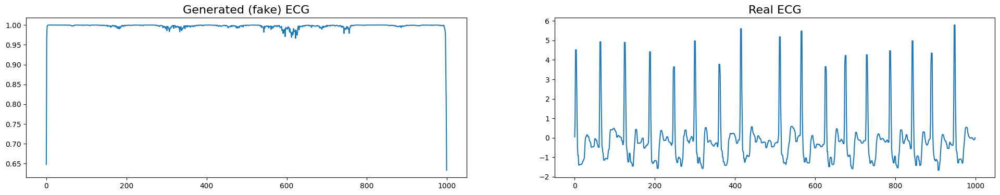

Epoch 201/3000
Generator loss: 0.5352374911308289
Discriminator loss: 9047552.0
-------------------
Epoch 202/3000
Generator loss: 0.5859352350234985
Discriminator loss: 9728920.0
-------------------
Epoch 203/3000
Generator loss: 0.5044852495193481
Discriminator loss: 10011626.0
-------------------
Epoch 204/3000
Generator loss: 0.5558618903160095
Discriminator loss: 10593196.0
-------------------
Epoch 205/3000
Generator loss: 0.5856859683990479
Discriminator loss: 8902320.0
-------------------
Epoch 206/3000
Generator loss: 0.5278213024139404
Discriminator loss: 9584288.0
-------------------
Epoch 207/3000
Generator loss: 0.6053536534309387
Discriminator loss: 10672538.0
-------------------
Epoch 208/3000
Generator loss: 0.5279707908630371
Discriminator loss: 9577369.0
-------------------
Epoch 209/3000
Generator loss: 0.5652688145637512
Discriminator loss: 12351594.0
-------------------
Epoch 210/3000
Generator loss: 0.5569470524787903
Discriminator loss: 8991652.0
----------------

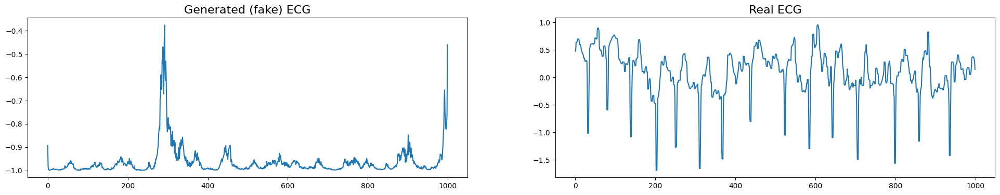

Epoch 251/3000
Generator loss: 0.5552494525909424
Discriminator loss: 12602973.0
-------------------
Epoch 252/3000
Generator loss: 0.525189995765686
Discriminator loss: 8993969.0
-------------------
Epoch 253/3000
Generator loss: 0.5299594402313232
Discriminator loss: 8935821.0
-------------------
Epoch 254/3000
Generator loss: 0.5616418123245239
Discriminator loss: 9703611.0
-------------------
Epoch 255/3000
Generator loss: 0.5440834164619446
Discriminator loss: 10602158.0
-------------------
Epoch 256/3000
Generator loss: 0.5285407304763794
Discriminator loss: 8426729.0
-------------------
Epoch 257/3000
Generator loss: 0.560001790523529
Discriminator loss: 9850743.0
-------------------
Epoch 258/3000
Generator loss: 0.5422694683074951
Discriminator loss: 10666114.0
-------------------
Epoch 259/3000
Generator loss: 0.5865853428840637
Discriminator loss: 10036208.0
-------------------
Epoch 260/3000
Generator loss: 0.5405391454696655
Discriminator loss: 8322986.5
------------------

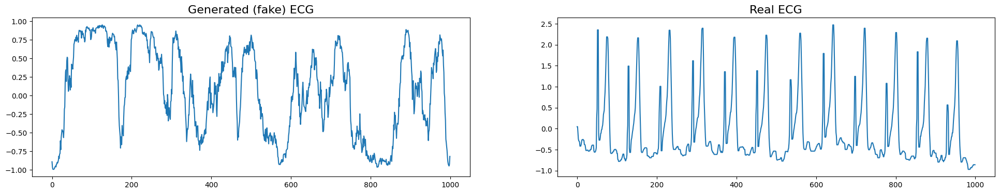

Epoch 301/3000
Generator loss: 0.5180466175079346
Discriminator loss: 12621104.0
-------------------
Epoch 302/3000
Generator loss: 0.5794894695281982
Discriminator loss: 8232699.5
-------------------
Epoch 303/3000
Generator loss: 0.535825252532959
Discriminator loss: 13224676.0
-------------------
Epoch 304/3000
Generator loss: 0.5579829812049866
Discriminator loss: 11704942.0
-------------------
Epoch 305/3000
Generator loss: 0.5194132924079895
Discriminator loss: 9288520.0
-------------------
Epoch 306/3000
Generator loss: 0.5531066656112671
Discriminator loss: 9768284.0
-------------------
Epoch 307/3000
Generator loss: 0.528450608253479
Discriminator loss: 8993737.0
-------------------
Epoch 308/3000
Generator loss: 0.537642776966095
Discriminator loss: 9208811.0
-------------------
Epoch 309/3000
Generator loss: 0.5673283934593201
Discriminator loss: 10375768.0
-------------------
Epoch 310/3000
Generator loss: 0.5549575090408325
Discriminator loss: 9147612.0
-------------------

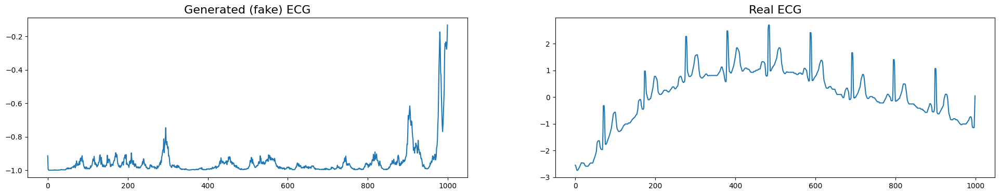

Epoch 351/3000
Generator loss: 0.5673679709434509
Discriminator loss: 10091964.0
-------------------
Epoch 352/3000
Generator loss: 0.5413391590118408
Discriminator loss: 9284306.0
-------------------
Epoch 353/3000
Generator loss: 0.5510040521621704
Discriminator loss: 9268064.0
-------------------
Epoch 354/3000
Generator loss: 0.5638372898101807
Discriminator loss: 10812694.0
-------------------
Epoch 355/3000
Generator loss: 0.5803682208061218
Discriminator loss: 10293195.0
-------------------
Epoch 356/3000
Generator loss: 0.5837769508361816
Discriminator loss: 12705128.0
-------------------
Epoch 357/3000
Generator loss: 0.5748755931854248
Discriminator loss: 11244758.0
-------------------
Epoch 358/3000
Generator loss: 0.543552041053772
Discriminator loss: 10169518.0
-------------------
Epoch 359/3000
Generator loss: 0.5714071989059448
Discriminator loss: 8695608.0
-------------------
Epoch 360/3000
Generator loss: 0.550107479095459
Discriminator loss: 9703320.0
----------------

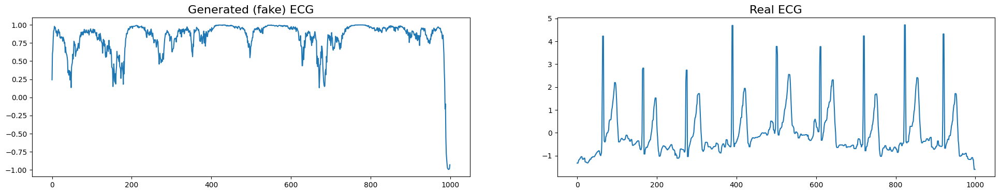

Epoch 401/3000
Generator loss: 0.6135667562484741
Discriminator loss: 11746866.0
-------------------
Epoch 402/3000
Generator loss: 0.5804947018623352
Discriminator loss: 9090937.0
-------------------
Epoch 403/3000
Generator loss: 0.5959453582763672
Discriminator loss: 8514808.0
-------------------
Epoch 404/3000
Generator loss: 0.5246902108192444
Discriminator loss: 9225284.0
-------------------
Epoch 405/3000
Generator loss: 0.5442219972610474
Discriminator loss: 10200081.0
-------------------
Epoch 406/3000
Generator loss: 0.5629919767379761
Discriminator loss: 9981010.0
-------------------
Epoch 407/3000
Generator loss: 0.5509694814682007
Discriminator loss: 9847924.0
-------------------
Epoch 408/3000
Generator loss: 0.5181392431259155
Discriminator loss: 9112460.0
-------------------
Epoch 409/3000
Generator loss: 0.586643397808075
Discriminator loss: 11513334.0
-------------------
Epoch 410/3000
Generator loss: 0.5208855867385864
Discriminator loss: 9161226.0
------------------

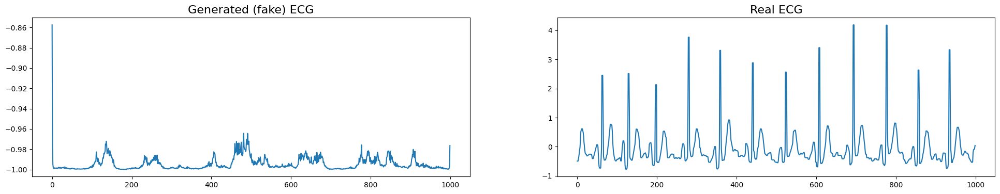

Epoch 451/3000
Generator loss: 0.5859389305114746
Discriminator loss: 11694753.0
-------------------
Epoch 452/3000
Generator loss: 0.5733473300933838
Discriminator loss: 9646283.0
-------------------
Epoch 453/3000
Generator loss: 0.5274500846862793
Discriminator loss: 11075846.0
-------------------
Epoch 454/3000
Generator loss: 0.5432995557785034
Discriminator loss: 9332475.0
-------------------
Epoch 455/3000
Generator loss: 0.5525808334350586
Discriminator loss: 9055644.0
-------------------
Epoch 456/3000
Generator loss: 0.5758264064788818
Discriminator loss: 10215766.0
-------------------
Epoch 457/3000
Generator loss: 0.5705276727676392
Discriminator loss: 13806552.0
-------------------
Epoch 458/3000
Generator loss: 0.5631520748138428
Discriminator loss: 8824972.0
-------------------
Epoch 459/3000
Generator loss: 0.5860051512718201
Discriminator loss: 10042594.0
-------------------
Epoch 460/3000
Generator loss: 0.5682821273803711
Discriminator loss: 9598954.0
---------------

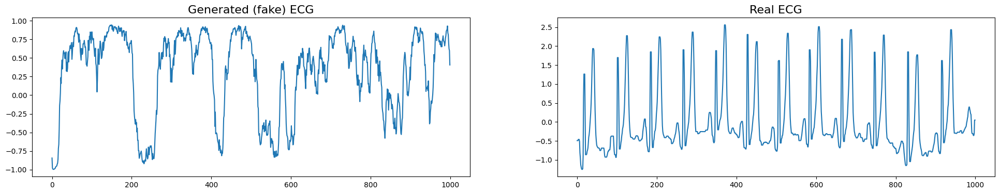

Epoch 501/3000
Generator loss: 0.5548019409179688
Discriminator loss: 8486962.0
-------------------
Epoch 502/3000
Generator loss: 0.5871917009353638
Discriminator loss: 13291674.0
-------------------
Epoch 503/3000
Generator loss: 0.5469345450401306
Discriminator loss: 10993712.0
-------------------
Epoch 504/3000
Generator loss: 0.5680921077728271
Discriminator loss: 12520004.0
-------------------
Epoch 505/3000
Generator loss: 0.5750610828399658
Discriminator loss: 9649978.0
-------------------
Epoch 506/3000
Generator loss: 0.5352660417556763
Discriminator loss: 9930357.0
-------------------
Epoch 507/3000
Generator loss: 0.5816116333007812
Discriminator loss: 11136900.0
-------------------
Epoch 508/3000
Generator loss: 0.5532715916633606
Discriminator loss: 9363331.0
-------------------
Epoch 509/3000
Generator loss: 0.5795754790306091
Discriminator loss: 11863908.0
-------------------
Epoch 510/3000
Generator loss: 0.5306392908096313
Discriminator loss: 10806838.0
--------------

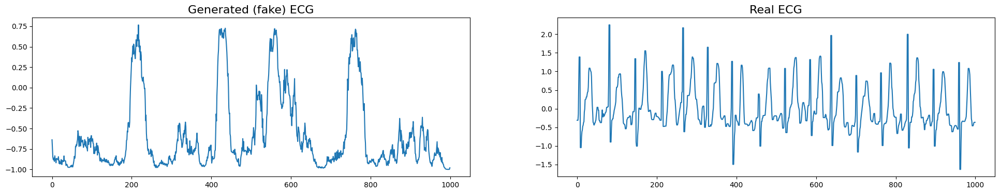

Epoch 551/3000
Generator loss: 0.5707466006278992
Discriminator loss: 10524075.0
-------------------
Epoch 552/3000
Generator loss: 0.516282856464386
Discriminator loss: 10665776.0
-------------------
Epoch 553/3000
Generator loss: 0.5532506108283997
Discriminator loss: 8369040.5
-------------------
Epoch 554/3000
Generator loss: 0.578434407711029
Discriminator loss: 10505783.0
-------------------
Epoch 555/3000
Generator loss: 0.6314700245857239
Discriminator loss: 7972958.0
-------------------
Epoch 556/3000
Generator loss: 0.5589544177055359
Discriminator loss: 10435890.0
-------------------
Epoch 557/3000
Generator loss: 0.5396060943603516
Discriminator loss: 8918338.0
-------------------
Epoch 558/3000
Generator loss: 0.5860497951507568
Discriminator loss: 9726330.0
-------------------
Epoch 559/3000
Generator loss: 0.5469239950180054
Discriminator loss: 8902184.0
-------------------
Epoch 560/3000
Generator loss: 0.5256101489067078
Discriminator loss: 9847320.0
------------------

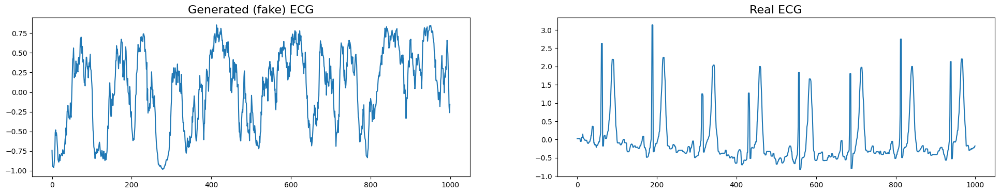

Epoch 601/3000
Generator loss: 0.5555428266525269
Discriminator loss: 11353630.0
-------------------
Epoch 602/3000
Generator loss: 0.6033071279525757
Discriminator loss: 12238905.0
-------------------
Epoch 603/3000
Generator loss: 0.5659884810447693
Discriminator loss: 9874676.0
-------------------
Epoch 604/3000
Generator loss: 0.5214853286743164
Discriminator loss: 13014098.0
-------------------
Epoch 605/3000
Generator loss: 0.5712670087814331
Discriminator loss: 11446084.0
-------------------
Epoch 606/3000
Generator loss: 0.573508620262146
Discriminator loss: 8811408.0
-------------------
Epoch 607/3000
Generator loss: 0.5508543848991394
Discriminator loss: 11609549.0
-------------------
Epoch 608/3000
Generator loss: 0.5427269339561462
Discriminator loss: 10689449.0
-------------------
Epoch 609/3000
Generator loss: 0.5688490867614746
Discriminator loss: 11520899.0
-------------------
Epoch 610/3000
Generator loss: 0.5552651882171631
Discriminator loss: 11295586.0
-------------

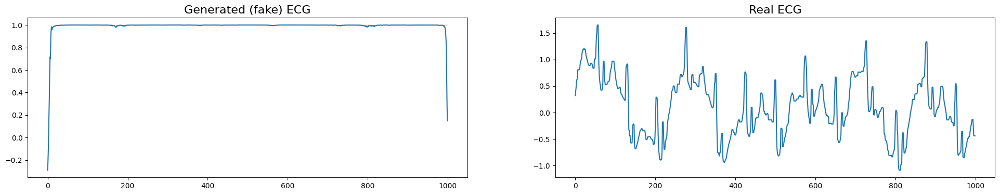

Epoch 651/3000
Generator loss: 0.530292272567749
Discriminator loss: 9052283.0
-------------------
Epoch 652/3000
Generator loss: 0.5479480028152466
Discriminator loss: 10455302.0
-------------------
Epoch 653/3000
Generator loss: 0.5221692323684692
Discriminator loss: 10525098.0
-------------------
Epoch 654/3000
Generator loss: 0.5462825298309326
Discriminator loss: 9181994.0
-------------------
Epoch 655/3000
Generator loss: 0.5418691635131836
Discriminator loss: 8950770.0
-------------------
Epoch 656/3000
Generator loss: 0.5301259756088257
Discriminator loss: 8379704.0
-------------------
Epoch 657/3000
Generator loss: 0.5897977352142334
Discriminator loss: 8937289.0
-------------------
Epoch 658/3000
Generator loss: 0.5528150200843811
Discriminator loss: 10284039.0
-------------------
Epoch 659/3000
Generator loss: 0.5759321451187134
Discriminator loss: 12938955.0
-------------------
Epoch 660/3000
Generator loss: 0.5427053570747375
Discriminator loss: 10288174.0
----------------

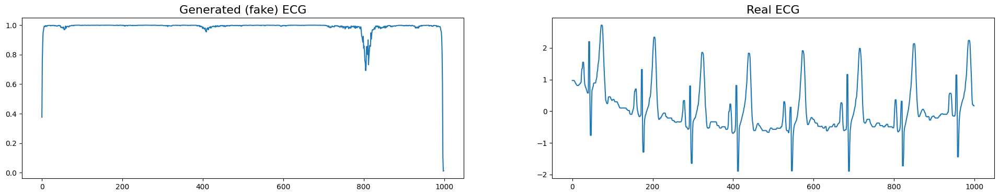

Epoch 701/3000
Generator loss: 0.5898147821426392
Discriminator loss: 11429318.0
-------------------
Epoch 702/3000
Generator loss: 0.5615954995155334
Discriminator loss: 8412584.0
-------------------
Epoch 703/3000
Generator loss: 0.5640546083450317
Discriminator loss: 8338113.5
-------------------
Epoch 704/3000
Generator loss: 0.5380374789237976
Discriminator loss: 11514281.0
-------------------
Epoch 705/3000
Generator loss: 0.5531489849090576
Discriminator loss: 12002012.0
-------------------
Epoch 706/3000
Generator loss: 0.5285825729370117
Discriminator loss: 9456630.0
-------------------
Epoch 707/3000
Generator loss: 0.571882963180542
Discriminator loss: 11469135.0
-------------------
Epoch 708/3000
Generator loss: 0.5240334272384644
Discriminator loss: 11365941.0
-------------------
Epoch 709/3000
Generator loss: 0.5418612957000732
Discriminator loss: 10318598.0
-------------------
Epoch 710/3000
Generator loss: 0.5631848573684692
Discriminator loss: 10221414.0
--------------

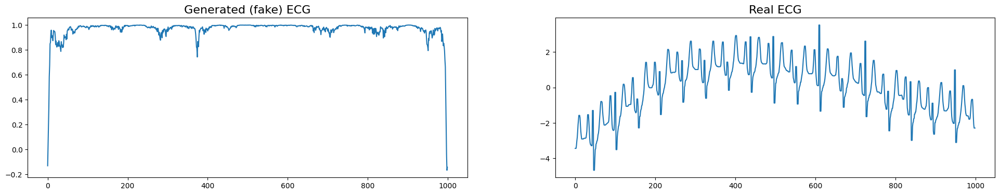

Epoch 751/3000
Generator loss: 0.5060264468193054
Discriminator loss: 7660715.0
-------------------
Epoch 752/3000
Generator loss: 0.5326449275016785
Discriminator loss: 9412053.0
-------------------
Epoch 753/3000
Generator loss: 0.5719375610351562
Discriminator loss: 10172348.0
-------------------
Epoch 754/3000
Generator loss: 0.538884162902832
Discriminator loss: 9744831.0
-------------------
Epoch 755/3000
Generator loss: 0.545143723487854
Discriminator loss: 9791580.0
-------------------
Epoch 756/3000
Generator loss: 0.5440493822097778
Discriminator loss: 10554992.0
-------------------
Epoch 757/3000
Generator loss: 0.5661496520042419
Discriminator loss: 9176620.0
-------------------
Epoch 758/3000
Generator loss: 0.548404335975647
Discriminator loss: 8013604.5
-------------------
Epoch 759/3000
Generator loss: 0.5356932282447815
Discriminator loss: 8119729.5
-------------------
Epoch 760/3000
Generator loss: 0.5620440244674683
Discriminator loss: 8572971.0
-------------------
E

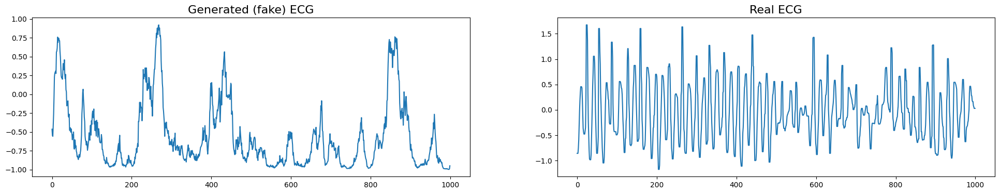

Epoch 801/3000
Generator loss: 0.5728707313537598
Discriminator loss: 8852498.0
-------------------
Epoch 802/3000
Generator loss: 0.5442824363708496
Discriminator loss: 12437163.0
-------------------
Epoch 803/3000
Generator loss: 0.5768132209777832
Discriminator loss: 9614846.0
-------------------
Epoch 804/3000
Generator loss: 0.56873619556427
Discriminator loss: 12001612.0
-------------------
Epoch 805/3000
Generator loss: 0.5530946254730225
Discriminator loss: 10914011.0
-------------------
Epoch 806/3000
Generator loss: 0.5202990770339966
Discriminator loss: 8529832.0
-------------------
Epoch 807/3000
Generator loss: 0.5624933838844299
Discriminator loss: 9455310.0
-------------------
Epoch 808/3000
Generator loss: 0.520804762840271
Discriminator loss: 10346580.0
-------------------
Epoch 809/3000
Generator loss: 0.5593338012695312
Discriminator loss: 9756326.0
-------------------
Epoch 810/3000
Generator loss: 0.6186648607254028
Discriminator loss: 9064508.0
-------------------

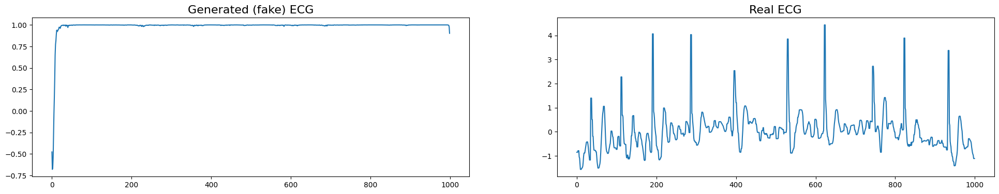

Epoch 851/3000
Generator loss: 0.5732937455177307
Discriminator loss: 9523526.0
-------------------
Epoch 852/3000
Generator loss: 0.5401507616043091
Discriminator loss: 9203716.0
-------------------
Epoch 853/3000
Generator loss: 0.5776374936103821
Discriminator loss: 15574816.0
-------------------
Epoch 854/3000
Generator loss: 0.5564287304878235
Discriminator loss: 10041019.0
-------------------
Epoch 855/3000
Generator loss: 0.5499646663665771
Discriminator loss: 10671495.0
-------------------
Epoch 856/3000
Generator loss: 0.5437207221984863
Discriminator loss: 10509764.0
-------------------
Epoch 857/3000
Generator loss: 0.5603222846984863
Discriminator loss: 7946669.0
-------------------
Epoch 858/3000
Generator loss: 0.5847203135490417
Discriminator loss: 8232188.5
-------------------
Epoch 859/3000
Generator loss: 0.5422526597976685
Discriminator loss: 8661928.0
-------------------
Epoch 860/3000
Generator loss: 0.5632221698760986
Discriminator loss: 9440906.0
----------------

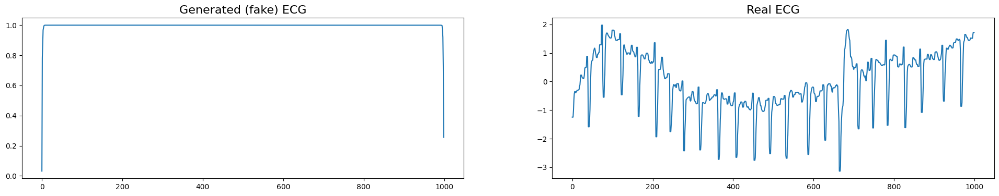

Epoch 901/3000
Generator loss: 0.5451129674911499
Discriminator loss: 9873589.0
-------------------
Epoch 902/3000
Generator loss: 0.5386359691619873
Discriminator loss: 10276592.0
-------------------
Epoch 903/3000
Generator loss: 0.5525668859481812
Discriminator loss: 9917126.0
-------------------
Epoch 904/3000
Generator loss: 0.5471702814102173
Discriminator loss: 10396528.0
-------------------
Epoch 905/3000
Generator loss: 0.5852035880088806
Discriminator loss: 9191266.0
-------------------
Epoch 906/3000
Generator loss: 0.5265441536903381
Discriminator loss: 10661108.0
-------------------
Epoch 907/3000
Generator loss: 0.5935830473899841
Discriminator loss: 9566336.0
-------------------
Epoch 908/3000
Generator loss: 0.5350555181503296
Discriminator loss: 10657664.0
-------------------
Epoch 909/3000
Generator loss: 0.55736243724823
Discriminator loss: 10744876.0
-------------------
Epoch 910/3000
Generator loss: 0.5280836820602417
Discriminator loss: 8483809.0
-----------------

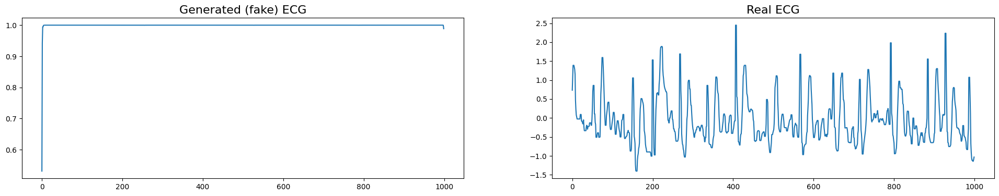

Epoch 951/3000
Generator loss: 0.5349435210227966
Discriminator loss: 7564806.5
-------------------
Epoch 952/3000
Generator loss: 0.5423990488052368
Discriminator loss: 8422492.0
-------------------
Epoch 953/3000
Generator loss: 0.5167853832244873
Discriminator loss: 7987509.5
-------------------
Epoch 954/3000
Generator loss: 0.549858570098877
Discriminator loss: 11194215.0
-------------------
Epoch 955/3000
Generator loss: 0.5203660130500793
Discriminator loss: 8981428.0
-------------------
Epoch 956/3000
Generator loss: 0.5576956868171692
Discriminator loss: 10755615.0
-------------------
Epoch 957/3000
Generator loss: 0.543587327003479
Discriminator loss: 8251238.5
-------------------
Epoch 958/3000
Generator loss: 0.5332179069519043
Discriminator loss: 9996476.0
-------------------
Epoch 959/3000
Generator loss: 0.5740583539009094
Discriminator loss: 7830782.0
-------------------
Epoch 960/3000
Generator loss: 0.5294619798660278
Discriminator loss: 9986291.0
-------------------


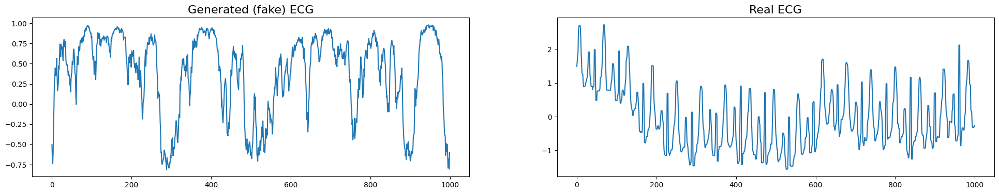

Epoch 1001/3000
Generator loss: 0.5792670249938965
Discriminator loss: 11007428.0
-------------------
Epoch 1002/3000
Generator loss: 0.5380353927612305
Discriminator loss: 10117190.0
-------------------
Epoch 1003/3000
Generator loss: 0.5432634353637695
Discriminator loss: 8957175.0
-------------------
Epoch 1004/3000
Generator loss: 0.5570117831230164
Discriminator loss: 9143584.0
-------------------
Epoch 1005/3000
Generator loss: 0.5203866958618164
Discriminator loss: 10001371.0
-------------------
Epoch 1006/3000
Generator loss: 0.5582263469696045
Discriminator loss: 9200853.0
-------------------
Epoch 1007/3000
Generator loss: 0.5363041162490845
Discriminator loss: 9895582.0
-------------------
Epoch 1008/3000
Generator loss: 0.5317857265472412
Discriminator loss: 9402300.0
-------------------
Epoch 1009/3000
Generator loss: 0.5251102447509766
Discriminator loss: 7838858.5
-------------------
Epoch 1010/3000
Generator loss: 0.5528022050857544
Discriminator loss: 8534917.0
-------

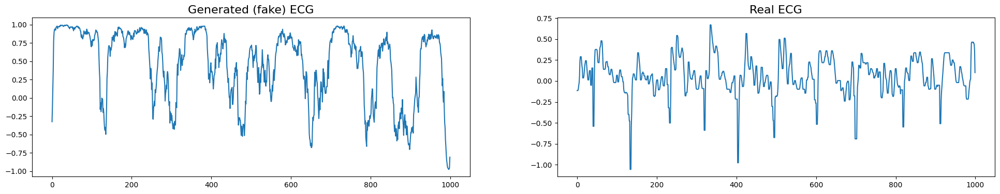

Epoch 1051/3000
Generator loss: 0.5534603595733643
Discriminator loss: 10457619.0
-------------------
Epoch 1052/3000
Generator loss: 0.5739868879318237
Discriminator loss: 9495022.0
-------------------
Epoch 1053/3000
Generator loss: 0.5728192925453186
Discriminator loss: 12276742.0
-------------------
Epoch 1054/3000
Generator loss: 0.5519665479660034
Discriminator loss: 10710406.0
-------------------
Epoch 1055/3000
Generator loss: 0.568528413772583
Discriminator loss: 12645849.0
-------------------
Epoch 1056/3000
Generator loss: 0.5646381378173828
Discriminator loss: 12586959.0
-------------------
Epoch 1057/3000
Generator loss: 0.5415976643562317
Discriminator loss: 8310942.5
-------------------
Epoch 1058/3000
Generator loss: 0.568027913570404
Discriminator loss: 8576536.0
-------------------
Epoch 1059/3000
Generator loss: 0.538199782371521
Discriminator loss: 9463556.0
-------------------
Epoch 1060/3000
Generator loss: 0.591907799243927
Discriminator loss: 9291906.0
---------

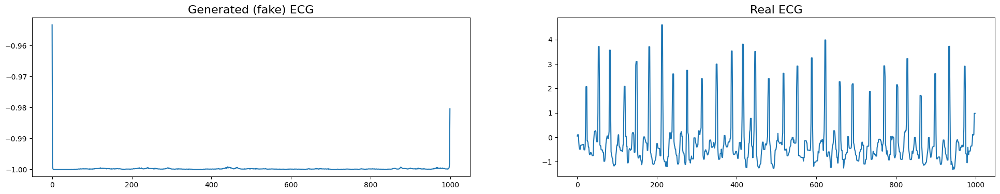

Epoch 1101/3000
Generator loss: 0.6160419583320618
Discriminator loss: 11012540.0
-------------------
Epoch 1102/3000
Generator loss: 0.5512253046035767
Discriminator loss: 8564145.0
-------------------
Epoch 1103/3000
Generator loss: 0.5509003400802612
Discriminator loss: 10666125.0
-------------------
Epoch 1104/3000
Generator loss: 0.5711120367050171
Discriminator loss: 10706234.0
-------------------
Epoch 1105/3000
Generator loss: 0.5455215573310852
Discriminator loss: 11998420.0
-------------------
Epoch 1106/3000
Generator loss: 0.5649611949920654
Discriminator loss: 12259793.0
-------------------
Epoch 1107/3000
Generator loss: 0.5383723974227905
Discriminator loss: 11301615.0
-------------------
Epoch 1108/3000
Generator loss: 0.5747867822647095
Discriminator loss: 9715251.0
-------------------
Epoch 1109/3000
Generator loss: 0.5609292387962341
Discriminator loss: 10053244.0
-------------------
Epoch 1110/3000
Generator loss: 0.5615339875221252
Discriminator loss: 11600063.0
--

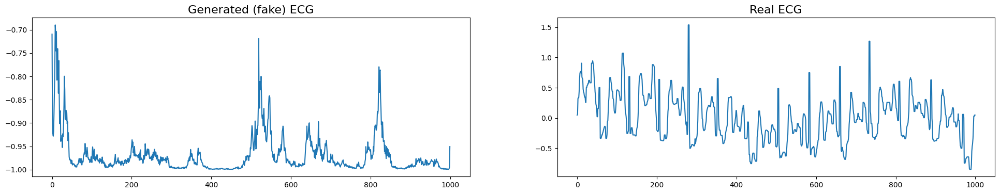

Epoch 1151/3000
Generator loss: 0.5450155735015869
Discriminator loss: 9340770.0
-------------------
Epoch 1152/3000
Generator loss: 0.5751286149024963
Discriminator loss: 10682666.0
-------------------
Epoch 1153/3000
Generator loss: 0.5219035148620605
Discriminator loss: 9375563.0
-------------------
Epoch 1154/3000
Generator loss: 0.5688709616661072
Discriminator loss: 9058821.0
-------------------
Epoch 1155/3000
Generator loss: 0.5821571946144104
Discriminator loss: 9097184.0
-------------------
Epoch 1156/3000
Generator loss: 0.5241492986679077
Discriminator loss: 10433420.0
-------------------
Epoch 1157/3000
Generator loss: 0.5681387186050415
Discriminator loss: 10744214.0
-------------------
Epoch 1158/3000
Generator loss: 0.592268705368042
Discriminator loss: 10969365.0
-------------------
Epoch 1159/3000
Generator loss: 0.5236155986785889
Discriminator loss: 9836246.0
-------------------
Epoch 1160/3000
Generator loss: 0.5800065398216248
Discriminator loss: 8434438.0
-------

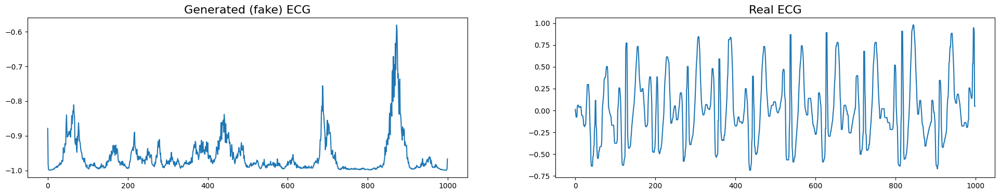

Epoch 1201/3000
Generator loss: 0.5484167337417603
Discriminator loss: 13412073.0
-------------------
Epoch 1202/3000
Generator loss: 0.5367989540100098
Discriminator loss: 9971639.0
-------------------
Epoch 1203/3000
Generator loss: 0.5731911063194275
Discriminator loss: 9547966.0
-------------------
Epoch 1204/3000
Generator loss: 0.5086110830307007
Discriminator loss: 9863026.0
-------------------
Epoch 1205/3000
Generator loss: 0.5456677675247192
Discriminator loss: 7744296.5
-------------------
Epoch 1206/3000
Generator loss: 0.5298523902893066
Discriminator loss: 9012262.0
-------------------
Epoch 1207/3000
Generator loss: 0.6214008331298828
Discriminator loss: 11963055.0
-------------------
Epoch 1208/3000
Generator loss: 0.51572185754776
Discriminator loss: 10524622.0
-------------------
Epoch 1209/3000
Generator loss: 0.6160465478897095
Discriminator loss: 11839106.0
-------------------
Epoch 1210/3000
Generator loss: 0.5775601267814636
Discriminator loss: 9992976.0
--------

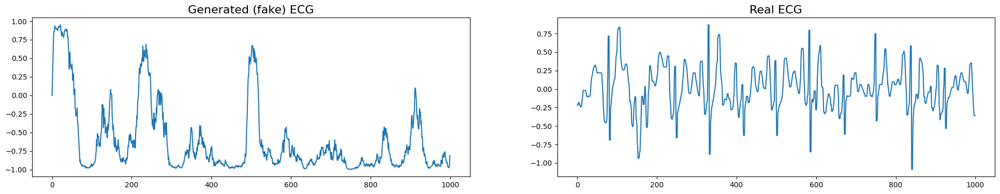

Epoch 1251/3000
Generator loss: 0.586716890335083
Discriminator loss: 10074309.0
-------------------
Epoch 1252/3000
Generator loss: 0.5498721599578857
Discriminator loss: 9833631.0
-------------------
Epoch 1253/3000
Generator loss: 0.5419758558273315
Discriminator loss: 10276359.0
-------------------
Epoch 1254/3000
Generator loss: 0.5432342290878296
Discriminator loss: 11641492.0
-------------------
Epoch 1255/3000
Generator loss: 0.5897004008293152
Discriminator loss: 10928202.0
-------------------
Epoch 1256/3000
Generator loss: 0.5680334568023682
Discriminator loss: 9358006.0
-------------------
Epoch 1257/3000
Generator loss: 0.5955860614776611
Discriminator loss: 10691145.0
-------------------
Epoch 1258/3000
Generator loss: 0.5794995427131653
Discriminator loss: 9931485.0
-------------------
Epoch 1259/3000
Generator loss: 0.5206601619720459
Discriminator loss: 12367034.0
-------------------
Epoch 1260/3000
Generator loss: 0.5585959553718567
Discriminator loss: 12851931.0
----

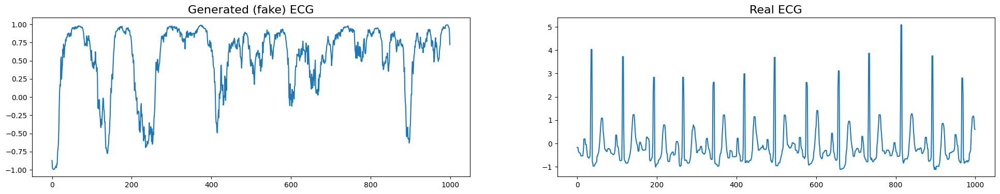

Epoch 1301/3000
Generator loss: 0.5529563426971436
Discriminator loss: 8499324.0
-------------------
Epoch 1302/3000
Generator loss: 0.5349529981613159
Discriminator loss: 10930456.0
-------------------
Epoch 1303/3000
Generator loss: 0.5663788318634033
Discriminator loss: 11893922.0
-------------------
Epoch 1304/3000
Generator loss: 0.5145211219787598
Discriminator loss: 8726116.0
-------------------
Epoch 1305/3000
Generator loss: 0.607180655002594
Discriminator loss: 9067481.0
-------------------
Epoch 1306/3000
Generator loss: 0.5818043351173401
Discriminator loss: 11458824.0
-------------------
Epoch 1307/3000
Generator loss: 0.5385653972625732
Discriminator loss: 8570044.0
-------------------
Epoch 1308/3000
Generator loss: 0.5570622682571411
Discriminator loss: 10534528.0
-------------------
Epoch 1309/3000
Generator loss: 0.5688036680221558
Discriminator loss: 11535026.0
-------------------
Epoch 1310/3000
Generator loss: 0.5350558757781982
Discriminator loss: 11401048.0
-----

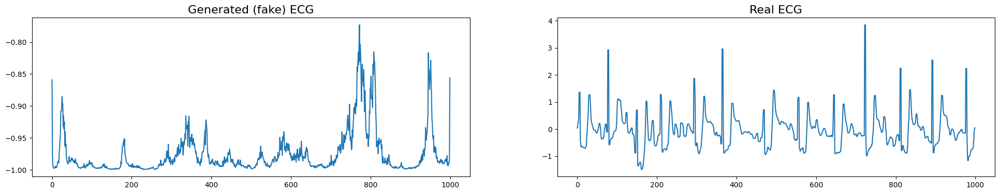

Epoch 1351/3000
Generator loss: 0.5877940058708191
Discriminator loss: 8142372.5
-------------------
Epoch 1352/3000
Generator loss: 0.5589959621429443
Discriminator loss: 9469631.0
-------------------
Epoch 1353/3000
Generator loss: 0.5614153146743774
Discriminator loss: 9747086.0
-------------------
Epoch 1354/3000
Generator loss: 0.5845324993133545
Discriminator loss: 10640310.0
-------------------
Epoch 1355/3000
Generator loss: 0.5563465356826782
Discriminator loss: 11387621.0
-------------------
Epoch 1356/3000
Generator loss: 0.6528346538543701
Discriminator loss: 9955000.0
-------------------
Epoch 1357/3000
Generator loss: 0.6011821031570435
Discriminator loss: 9217944.0
-------------------
Epoch 1358/3000
Generator loss: 0.5464583039283752
Discriminator loss: 11361540.0
-------------------
Epoch 1359/3000
Generator loss: 0.5460995435714722
Discriminator loss: 13081366.0
-------------------
Epoch 1360/3000
Generator loss: 0.5845208168029785
Discriminator loss: 10647633.0
-----

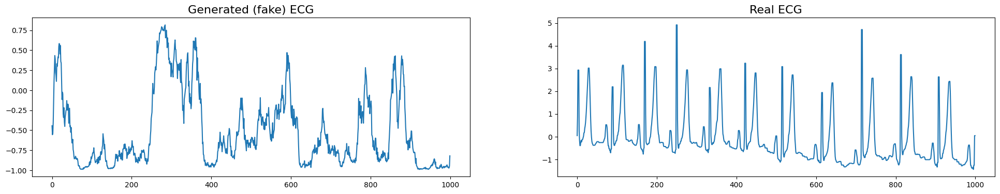

Epoch 1401/3000
Generator loss: 0.5713232755661011
Discriminator loss: 8813033.0
-------------------
Epoch 1402/3000
Generator loss: 0.5209859013557434
Discriminator loss: 9401629.0
-------------------
Epoch 1403/3000
Generator loss: 0.5535324811935425
Discriminator loss: 9276898.0
-------------------
Epoch 1404/3000
Generator loss: 0.5772776007652283
Discriminator loss: 9838042.0
-------------------
Epoch 1405/3000
Generator loss: 0.5512413382530212
Discriminator loss: 10885875.0
-------------------
Epoch 1406/3000
Generator loss: 0.5890545845031738
Discriminator loss: 10829190.0
-------------------
Epoch 1407/3000
Generator loss: 0.563507080078125
Discriminator loss: 9189676.0
-------------------
Epoch 1408/3000
Generator loss: 0.5829395055770874
Discriminator loss: 11083916.0
-------------------
Epoch 1409/3000
Generator loss: 0.5491019487380981
Discriminator loss: 10957552.0
-------------------
Epoch 1410/3000
Generator loss: 0.5546095371246338
Discriminator loss: 9897907.0
-------

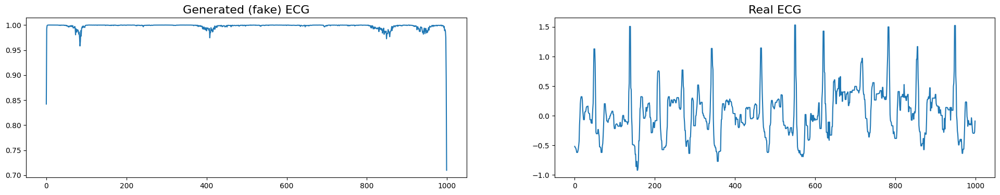

Epoch 1451/3000
Generator loss: 0.4975971579551697
Discriminator loss: 10187389.0
-------------------
Epoch 1452/3000
Generator loss: 0.5631963014602661
Discriminator loss: 11383586.0
-------------------
Epoch 1453/3000
Generator loss: 0.5298639535903931
Discriminator loss: 11060074.0
-------------------
Epoch 1454/3000
Generator loss: 0.527471125125885
Discriminator loss: 8308651.5
-------------------
Epoch 1455/3000
Generator loss: 0.6324527263641357
Discriminator loss: 10386472.0
-------------------
Epoch 1456/3000
Generator loss: 0.5790054798126221
Discriminator loss: 10947444.0
-------------------
Epoch 1457/3000
Generator loss: 0.5874038934707642
Discriminator loss: 9730976.0
-------------------
Epoch 1458/3000
Generator loss: 0.522930383682251
Discriminator loss: 10333114.0
-------------------
Epoch 1459/3000
Generator loss: 0.5416349172592163
Discriminator loss: 10027812.0
-------------------
Epoch 1460/3000
Generator loss: 0.5834800004959106
Discriminator loss: 10004076.0
----

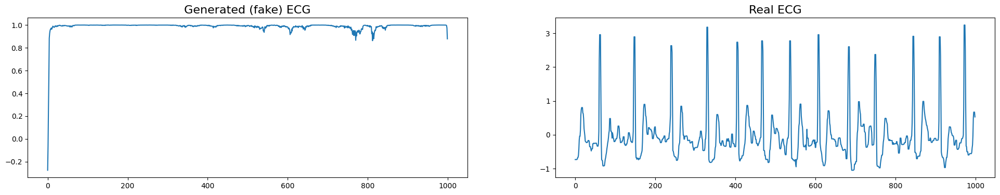

Epoch 1501/3000
Generator loss: 0.5550866723060608
Discriminator loss: 11975452.0
-------------------
Epoch 1502/3000
Generator loss: 0.5333409309387207
Discriminator loss: 8920558.0
-------------------
Epoch 1503/3000
Generator loss: 0.55745530128479
Discriminator loss: 12594546.0
-------------------
Epoch 1504/3000
Generator loss: 0.5396043062210083
Discriminator loss: 8937100.0
-------------------
Epoch 1505/3000
Generator loss: 0.542321503162384
Discriminator loss: 11530022.0
-------------------
Epoch 1506/3000
Generator loss: 0.5425918102264404
Discriminator loss: 10619423.0
-------------------
Epoch 1507/3000
Generator loss: 0.5659817457199097
Discriminator loss: 10585118.0
-------------------
Epoch 1508/3000
Generator loss: 0.5389121770858765
Discriminator loss: 8408416.0
-------------------
Epoch 1509/3000
Generator loss: 0.5344976186752319
Discriminator loss: 9035519.0
-------------------
Epoch 1510/3000
Generator loss: 0.5485092401504517
Discriminator loss: 8851020.0
--------

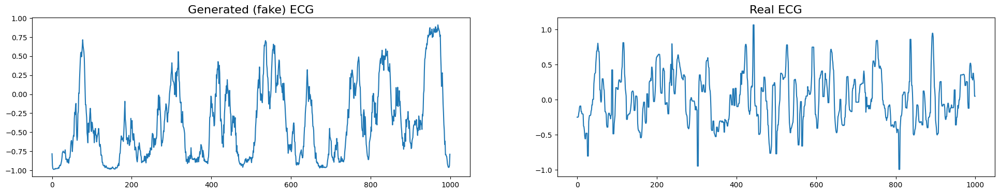

Epoch 1551/3000
Generator loss: 0.5464405417442322
Discriminator loss: 9547808.0
-------------------
Epoch 1552/3000
Generator loss: 0.5802000164985657
Discriminator loss: 13130078.0
-------------------
Epoch 1553/3000
Generator loss: 0.6205791234970093
Discriminator loss: 10440814.0
-------------------
Epoch 1554/3000
Generator loss: 0.5272188782691956
Discriminator loss: 8431582.0
-------------------
Epoch 1555/3000
Generator loss: 0.5712144374847412
Discriminator loss: 12086920.0
-------------------
Epoch 1556/3000
Generator loss: 0.5659372210502625
Discriminator loss: 9740811.0
-------------------
Epoch 1557/3000
Generator loss: 0.5493379831314087
Discriminator loss: 11181862.0
-------------------
Epoch 1558/3000
Generator loss: 0.5770047903060913
Discriminator loss: 11181056.0
-------------------
Epoch 1559/3000
Generator loss: 0.5455689430236816
Discriminator loss: 9022234.0
-------------------
Epoch 1560/3000
Generator loss: 0.5615523457527161
Discriminator loss: 9805191.0
-----

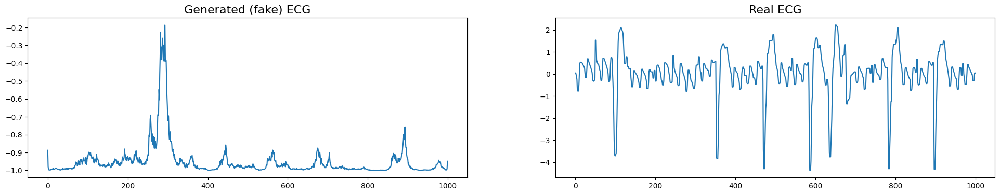

Epoch 1601/3000
Generator loss: 0.5454989671707153
Discriminator loss: 10177241.0
-------------------
Epoch 1602/3000
Generator loss: 0.5518085956573486
Discriminator loss: 10912699.0
-------------------
Epoch 1603/3000
Generator loss: 0.5393977761268616
Discriminator loss: 10696114.0
-------------------
Epoch 1604/3000
Generator loss: 0.5155376195907593
Discriminator loss: 10437362.0
-------------------
Epoch 1605/3000
Generator loss: 0.5101368427276611
Discriminator loss: 9672939.0
-------------------
Epoch 1606/3000
Generator loss: 0.5369069576263428
Discriminator loss: 9387311.0
-------------------
Epoch 1607/3000
Generator loss: 0.5191185474395752
Discriminator loss: 9326804.0
-------------------
Epoch 1608/3000
Generator loss: 0.5565483570098877
Discriminator loss: 9449419.0
-------------------
Epoch 1609/3000
Generator loss: 0.5251244306564331
Discriminator loss: 8926641.0
-------------------
Epoch 1610/3000
Generator loss: 0.5363444089889526
Discriminator loss: 9237109.0
------

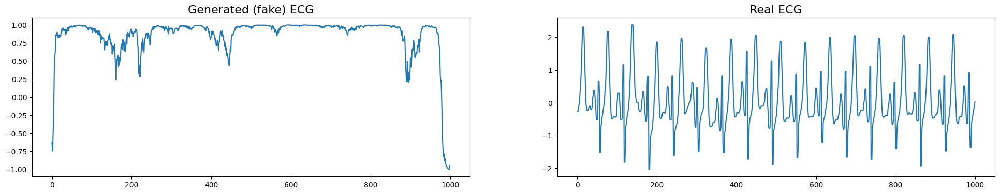

Epoch 1651/3000
Generator loss: 0.5502599477767944
Discriminator loss: 11104588.0
-------------------
Epoch 1652/3000
Generator loss: 0.5730432868003845
Discriminator loss: 8882282.0
-------------------
Epoch 1653/3000
Generator loss: 0.5287538766860962
Discriminator loss: 8929972.0
-------------------
Epoch 1654/3000
Generator loss: 0.5880540609359741
Discriminator loss: 11292866.0
-------------------
Epoch 1655/3000
Generator loss: 0.5862648487091064
Discriminator loss: 10214152.0
-------------------
Epoch 1656/3000
Generator loss: 0.5580545663833618
Discriminator loss: 8525736.0
-------------------
Epoch 1657/3000
Generator loss: 0.5666706562042236
Discriminator loss: 11454014.0
-------------------
Epoch 1658/3000
Generator loss: 0.5581718683242798
Discriminator loss: 11288817.0
-------------------
Epoch 1659/3000
Generator loss: 0.5573956370353699
Discriminator loss: 10316412.0
-------------------
Epoch 1660/3000
Generator loss: 0.5822961330413818
Discriminator loss: 11355156.0
---

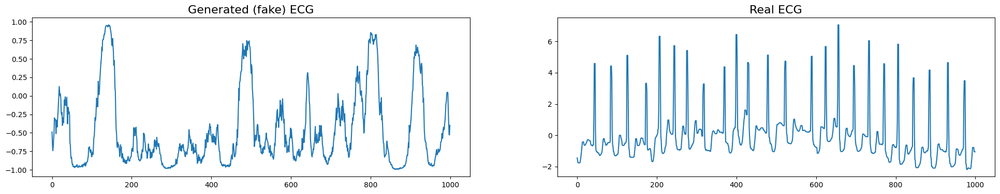

Epoch 1701/3000
Generator loss: 0.5435777902603149
Discriminator loss: 11667586.0
-------------------
Epoch 1702/3000
Generator loss: 0.5897459983825684
Discriminator loss: 10241160.0
-------------------
Epoch 1703/3000
Generator loss: 0.5619308948516846
Discriminator loss: 9517514.0
-------------------
Epoch 1704/3000
Generator loss: 0.5632002949714661
Discriminator loss: 8996628.0
-------------------
Epoch 1705/3000
Generator loss: 0.551050066947937
Discriminator loss: 8936684.0
-------------------
Epoch 1706/3000
Generator loss: 0.5731150507926941
Discriminator loss: 8178377.0
-------------------
Epoch 1707/3000
Generator loss: 0.5078622102737427
Discriminator loss: 8758814.0
-------------------
Epoch 1708/3000
Generator loss: 0.5839660167694092
Discriminator loss: 11749281.0
-------------------
Epoch 1709/3000
Generator loss: 0.5228580832481384
Discriminator loss: 9741547.0
-------------------
Epoch 1710/3000
Generator loss: 0.5473787784576416
Discriminator loss: 11797264.0
-------

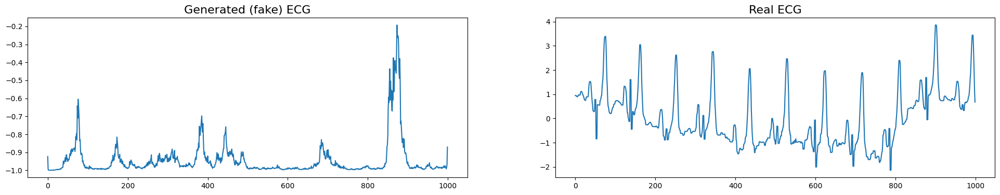

Epoch 1751/3000
Generator loss: 0.5273637771606445
Discriminator loss: 8271976.5
-------------------
Epoch 1752/3000
Generator loss: 0.5453141927719116
Discriminator loss: 9603361.0
-------------------
Epoch 1753/3000
Generator loss: 0.5807726979255676
Discriminator loss: 10717132.0
-------------------
Epoch 1754/3000
Generator loss: 0.5707947611808777
Discriminator loss: 8394393.0
-------------------
Epoch 1755/3000
Generator loss: 0.5343942642211914
Discriminator loss: 10141324.0
-------------------
Epoch 1756/3000
Generator loss: 0.5766362547874451
Discriminator loss: 9509981.0
-------------------
Epoch 1757/3000
Generator loss: 0.5421831011772156
Discriminator loss: 15122834.0
-------------------
Epoch 1758/3000
Generator loss: 0.5080030560493469
Discriminator loss: 8793566.0
-------------------
Epoch 1759/3000
Generator loss: 0.5640082955360413
Discriminator loss: 10918883.0
-------------------
Epoch 1760/3000
Generator loss: 0.5391404032707214
Discriminator loss: 9844710.0
------

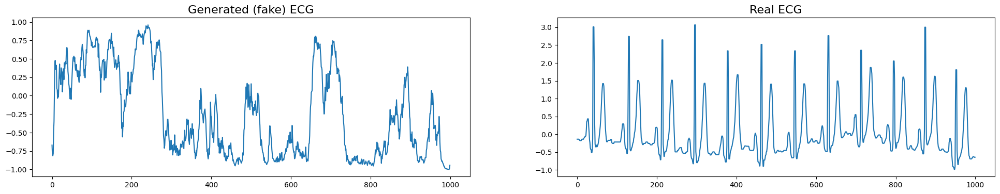

Epoch 1801/3000
Generator loss: 0.5758813619613647
Discriminator loss: 10732541.0
-------------------
Epoch 1802/3000
Generator loss: 0.5657376050949097
Discriminator loss: 12021261.0
-------------------
Epoch 1803/3000
Generator loss: 0.5600399971008301
Discriminator loss: 8714904.0
-------------------
Epoch 1804/3000
Generator loss: 0.5416407585144043
Discriminator loss: 9045516.0
-------------------
Epoch 1805/3000
Generator loss: 0.6096310615539551
Discriminator loss: 9508399.0
-------------------
Epoch 1806/3000
Generator loss: 0.5706939697265625
Discriminator loss: 10015144.0
-------------------
Epoch 1807/3000
Generator loss: 0.5725919008255005
Discriminator loss: 9494483.0
-------------------
Epoch 1808/3000
Generator loss: 0.5961101055145264
Discriminator loss: 10868751.0
-------------------
Epoch 1809/3000
Generator loss: 0.5228821039199829
Discriminator loss: 9641392.0
-------------------
Epoch 1810/3000
Generator loss: 0.5824500918388367
Discriminator loss: 10336954.0
-----

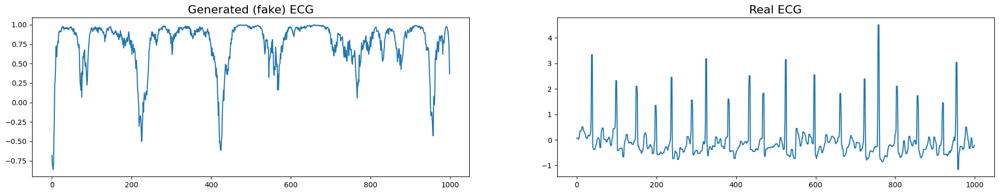

Epoch 1851/3000
Generator loss: 0.5534089803695679
Discriminator loss: 8410065.0
-------------------
Epoch 1852/3000
Generator loss: 0.5363725423812866
Discriminator loss: 8477046.0
-------------------
Epoch 1853/3000
Generator loss: 0.5548979043960571
Discriminator loss: 10007696.0
-------------------
Epoch 1854/3000
Generator loss: 0.5365177392959595
Discriminator loss: 11318012.0
-------------------
Epoch 1855/3000
Generator loss: 0.5247194766998291
Discriminator loss: 9919090.0
-------------------
Epoch 1856/3000
Generator loss: 0.5359162092208862
Discriminator loss: 9074373.0
-------------------
Epoch 1857/3000
Generator loss: 0.5652275681495667
Discriminator loss: 8540861.0
-------------------
Epoch 1858/3000
Generator loss: 0.5528175234794617
Discriminator loss: 9782174.0
-------------------
Epoch 1859/3000
Generator loss: 0.5781386494636536
Discriminator loss: 10268222.0
-------------------
Epoch 1860/3000
Generator loss: 0.5976384878158569
Discriminator loss: 9719546.0
-------

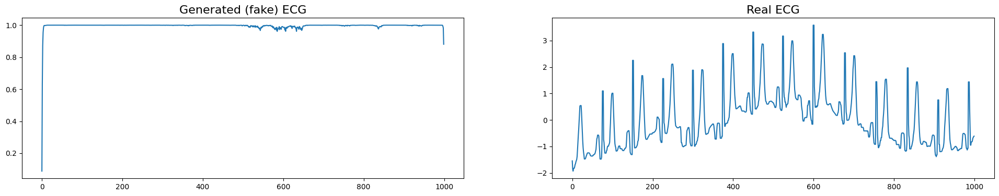

Epoch 1901/3000
Generator loss: 0.5589233636856079
Discriminator loss: 11102548.0
-------------------
Epoch 1902/3000
Generator loss: 0.5612486004829407
Discriminator loss: 9687870.0
-------------------
Epoch 1903/3000
Generator loss: 0.5616792440414429
Discriminator loss: 13161819.0
-------------------
Epoch 1904/3000
Generator loss: 0.5778398513793945
Discriminator loss: 7817277.5
-------------------
Epoch 1905/3000
Generator loss: 0.6009544730186462
Discriminator loss: 9222371.0
-------------------
Epoch 1906/3000
Generator loss: 0.5980890393257141
Discriminator loss: 8652224.0
-------------------
Epoch 1907/3000
Generator loss: 0.5787140130996704
Discriminator loss: 11382632.0
-------------------
Epoch 1908/3000
Generator loss: 0.5433236360549927
Discriminator loss: 12065224.0
-------------------
Epoch 1909/3000
Generator loss: 0.552442729473114
Discriminator loss: 9187646.0
-------------------
Epoch 1910/3000
Generator loss: 0.5448177456855774
Discriminator loss: 8970729.0
-------

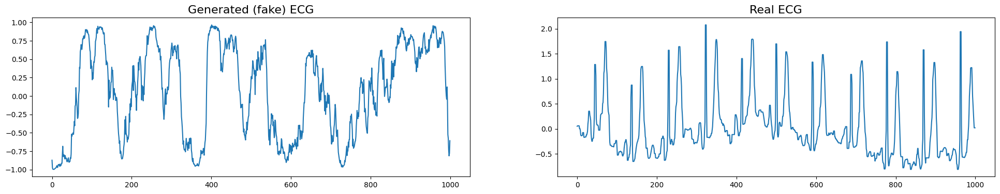

Epoch 1951/3000
Generator loss: 0.6274852156639099
Discriminator loss: 8842854.0
-------------------
Epoch 1952/3000
Generator loss: 0.5157879590988159
Discriminator loss: 10354279.0
-------------------
Epoch 1953/3000
Generator loss: 0.5477426052093506
Discriminator loss: 8893261.0
-------------------
Epoch 1954/3000
Generator loss: 0.5322473645210266
Discriminator loss: 10820739.0
-------------------
Epoch 1955/3000
Generator loss: 0.5515825748443604
Discriminator loss: 12026786.0
-------------------
Epoch 1956/3000
Generator loss: 0.5587576031684875
Discriminator loss: 10982145.0
-------------------
Epoch 1957/3000
Generator loss: 0.5223196148872375
Discriminator loss: 12323844.0
-------------------
Epoch 1958/3000
Generator loss: 0.5373703837394714
Discriminator loss: 9371804.0
-------------------
Epoch 1959/3000
Generator loss: 0.5641081929206848
Discriminator loss: 10246120.0
-------------------
Epoch 1960/3000
Generator loss: 0.5490301847457886
Discriminator loss: 10336574.0
---

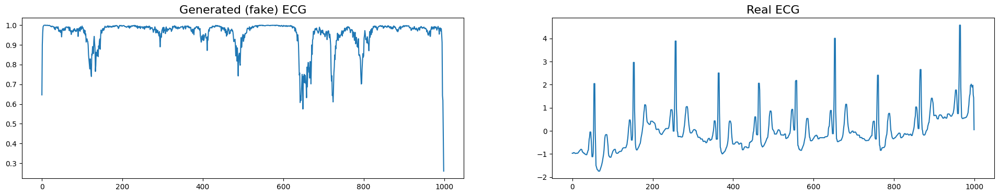

Epoch 2001/3000
Generator loss: 0.5471656322479248
Discriminator loss: 10610030.0
-------------------
Epoch 2002/3000
Generator loss: 0.5535192489624023
Discriminator loss: 9533719.0
-------------------
Epoch 2003/3000
Generator loss: 0.5548031330108643
Discriminator loss: 8944678.0
-------------------
Epoch 2004/3000
Generator loss: 0.554721474647522
Discriminator loss: 9779359.0
-------------------
Epoch 2005/3000
Generator loss: 0.5438578128814697
Discriminator loss: 9381765.0
-------------------
Epoch 2006/3000
Generator loss: 0.5647108554840088
Discriminator loss: 8652218.0
-------------------
Epoch 2007/3000
Generator loss: 0.5776804685592651
Discriminator loss: 8439758.0
-------------------
Epoch 2008/3000
Generator loss: 0.5360405445098877
Discriminator loss: 11590371.0
-------------------
Epoch 2009/3000
Generator loss: 0.5376080274581909
Discriminator loss: 9234548.0
-------------------
Epoch 2010/3000
Generator loss: 0.5218121409416199
Discriminator loss: 9412657.0
---------

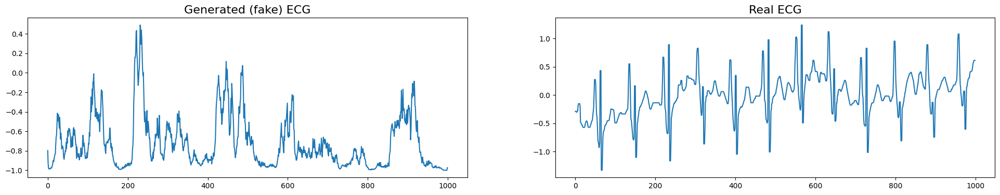

Epoch 2051/3000
Generator loss: 0.5186810493469238
Discriminator loss: 11941522.0
-------------------
Epoch 2052/3000
Generator loss: 0.5617012977600098
Discriminator loss: 9816726.0
-------------------
Epoch 2053/3000
Generator loss: 0.5243124961853027
Discriminator loss: 10247294.0
-------------------
Epoch 2054/3000
Generator loss: 0.5422145128250122
Discriminator loss: 8807321.0
-------------------
Epoch 2055/3000
Generator loss: 0.577038049697876
Discriminator loss: 9513586.0
-------------------
Epoch 2056/3000
Generator loss: 0.5665245056152344
Discriminator loss: 8412782.0
-------------------
Epoch 2057/3000
Generator loss: 0.5299340486526489
Discriminator loss: 11821516.0
-------------------
Epoch 2058/3000
Generator loss: 0.5558606386184692
Discriminator loss: 11764554.0
-------------------
Epoch 2059/3000
Generator loss: 0.5196534991264343
Discriminator loss: 8656821.0
-------------------
Epoch 2060/3000
Generator loss: 0.5738024711608887
Discriminator loss: 14846586.0
------

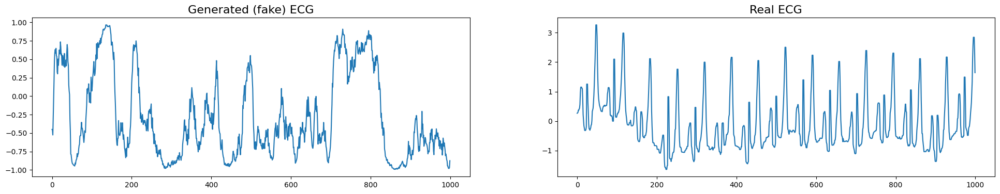

Epoch 2101/3000
Generator loss: 0.5348149538040161
Discriminator loss: 11364321.0
-------------------
Epoch 2102/3000
Generator loss: 0.5375924110412598
Discriminator loss: 10222026.0
-------------------
Epoch 2103/3000
Generator loss: 0.594706118106842
Discriminator loss: 9875839.0
-------------------
Epoch 2104/3000
Generator loss: 0.5650088787078857
Discriminator loss: 9926276.0
-------------------
Epoch 2105/3000
Generator loss: 0.5573632121086121
Discriminator loss: 9708566.0
-------------------
Epoch 2106/3000
Generator loss: 0.5209755897521973
Discriminator loss: 11604128.0
-------------------
Epoch 2107/3000
Generator loss: 0.5644707679748535
Discriminator loss: 14123463.0
-------------------
Epoch 2108/3000
Generator loss: 0.5756739974021912
Discriminator loss: 11821853.0
-------------------
Epoch 2109/3000
Generator loss: 0.5994946956634521
Discriminator loss: 10037070.0
-------------------
Epoch 2110/3000
Generator loss: 0.5064232349395752
Discriminator loss: 10699696.0
----

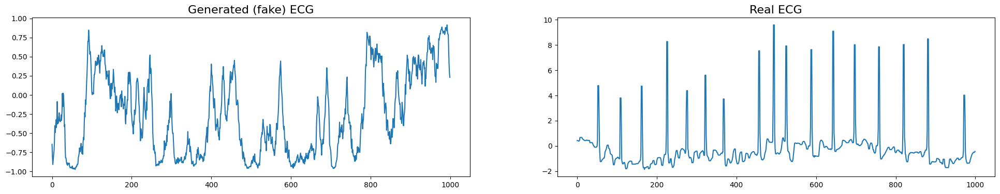

Epoch 2151/3000
Generator loss: 0.5752208232879639
Discriminator loss: 12862053.0
-------------------
Epoch 2152/3000
Generator loss: 0.5444047451019287
Discriminator loss: 9060911.0
-------------------
Epoch 2153/3000
Generator loss: 0.5734724998474121
Discriminator loss: 10237485.0
-------------------
Epoch 2154/3000
Generator loss: 0.5437261462211609
Discriminator loss: 11605151.0
-------------------
Epoch 2155/3000
Generator loss: 0.5475208759307861
Discriminator loss: 7644279.5
-------------------
Epoch 2156/3000
Generator loss: 0.5465527772903442
Discriminator loss: 11654544.0
-------------------
Epoch 2157/3000
Generator loss: 0.5433337688446045
Discriminator loss: 11231792.0
-------------------
Epoch 2158/3000
Generator loss: 0.6018435955047607
Discriminator loss: 9391966.0
-------------------
Epoch 2159/3000
Generator loss: 0.5773444175720215
Discriminator loss: 12346859.0
-------------------
Epoch 2160/3000
Generator loss: 0.5670361518859863
Discriminator loss: 9457215.0
----

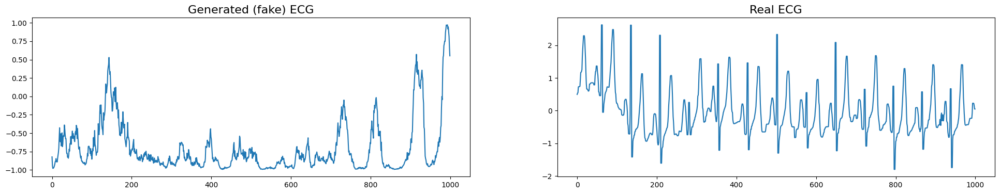

Epoch 2201/3000
Generator loss: 0.536658763885498
Discriminator loss: 10340798.0
-------------------
Epoch 2202/3000
Generator loss: 0.5312361121177673
Discriminator loss: 8954302.0
-------------------
Epoch 2203/3000
Generator loss: 0.534909725189209
Discriminator loss: 10217074.0
-------------------
Epoch 2204/3000
Generator loss: 0.5308566093444824
Discriminator loss: 9813633.0
-------------------
Epoch 2205/3000
Generator loss: 0.5699291825294495
Discriminator loss: 11741109.0
-------------------
Epoch 2206/3000
Generator loss: 0.49696218967437744
Discriminator loss: 9799922.0
-------------------
Epoch 2207/3000
Generator loss: 0.5477044582366943
Discriminator loss: 8755674.0
-------------------
Epoch 2208/3000
Generator loss: 0.5489996671676636
Discriminator loss: 9698251.0
-------------------
Epoch 2209/3000
Generator loss: 0.542299211025238
Discriminator loss: 10225492.0
-------------------
Epoch 2210/3000
Generator loss: 0.5515672564506531
Discriminator loss: 8870287.0
--------

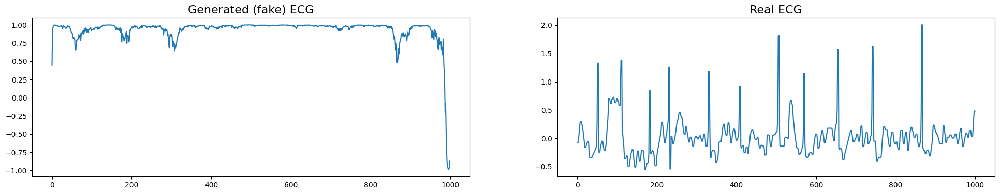

Epoch 2251/3000
Generator loss: 0.5457394123077393
Discriminator loss: 8805454.0
-------------------
Epoch 2252/3000
Generator loss: 0.5221470594406128
Discriminator loss: 8650612.0
-------------------
Epoch 2253/3000
Generator loss: 0.5459125638008118
Discriminator loss: 11916359.0
-------------------
Epoch 2254/3000
Generator loss: 0.5612167716026306
Discriminator loss: 11034628.0
-------------------
Epoch 2255/3000
Generator loss: 0.5394178628921509
Discriminator loss: 9014884.0
-------------------
Epoch 2256/3000
Generator loss: 0.552570104598999
Discriminator loss: 10311482.0
-------------------
Epoch 2257/3000
Generator loss: 0.5179136395454407
Discriminator loss: 10044128.0
-------------------
Epoch 2258/3000
Generator loss: 0.5167102217674255
Discriminator loss: 9664422.0
-------------------
Epoch 2259/3000
Generator loss: 0.5465272068977356
Discriminator loss: 9542814.0
-------------------
Epoch 2260/3000
Generator loss: 0.5383752584457397
Discriminator loss: 10779516.0
------

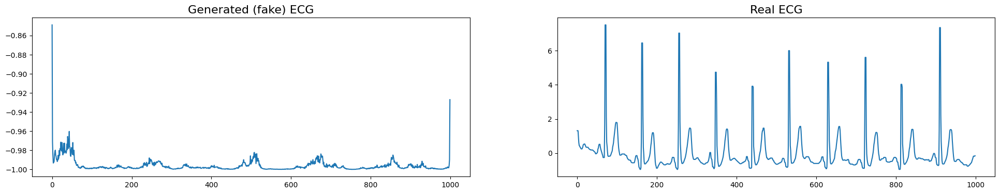

Epoch 2301/3000
Generator loss: 0.5067764520645142
Discriminator loss: 10676870.0
-------------------
Epoch 2302/3000
Generator loss: 0.5329837799072266
Discriminator loss: 9928192.0
-------------------
Epoch 2303/3000
Generator loss: 0.5625306367874146
Discriminator loss: 10222538.0
-------------------
Epoch 2304/3000
Generator loss: 0.5102130174636841
Discriminator loss: 9903514.0
-------------------
Epoch 2305/3000
Generator loss: 0.6101177930831909
Discriminator loss: 11044234.0
-------------------
Epoch 2306/3000
Generator loss: 0.5905060768127441
Discriminator loss: 8262797.0
-------------------
Epoch 2307/3000
Generator loss: 0.5593422651290894
Discriminator loss: 10959990.0
-------------------
Epoch 2308/3000
Generator loss: 0.5501623153686523
Discriminator loss: 9250819.0
-------------------
Epoch 2309/3000
Generator loss: 0.5151076316833496
Discriminator loss: 9104762.0
-------------------
Epoch 2310/3000
Generator loss: 0.5596898794174194
Discriminator loss: 12135441.0
-----

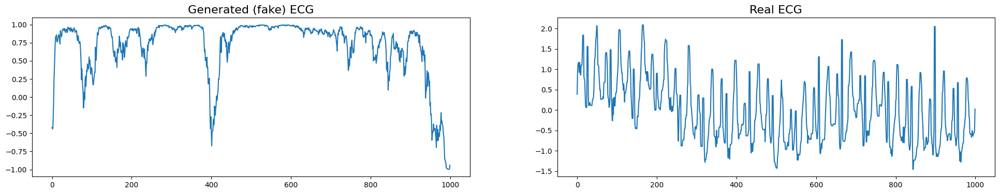

Epoch 2351/3000
Generator loss: 0.560490608215332
Discriminator loss: 11418008.0
-------------------
Epoch 2352/3000
Generator loss: 0.519297182559967
Discriminator loss: 7534970.5
-------------------
Epoch 2353/3000
Generator loss: 0.537013590335846
Discriminator loss: 10606076.0
-------------------
Epoch 2354/3000
Generator loss: 0.5535873174667358
Discriminator loss: 10248255.0
-------------------
Epoch 2355/3000
Generator loss: 0.5516161918640137
Discriminator loss: 8607394.0
-------------------
Epoch 2356/3000
Generator loss: 0.5427782535552979
Discriminator loss: 9914454.0
-------------------
Epoch 2357/3000
Generator loss: 0.5498807430267334
Discriminator loss: 10159538.0
-------------------
Epoch 2358/3000
Generator loss: 0.5996900796890259
Discriminator loss: 12262470.0
-------------------
Epoch 2359/3000
Generator loss: 0.5380501747131348
Discriminator loss: 10550516.0
-------------------
Epoch 2360/3000
Generator loss: 0.5693068504333496
Discriminator loss: 11480031.0
------

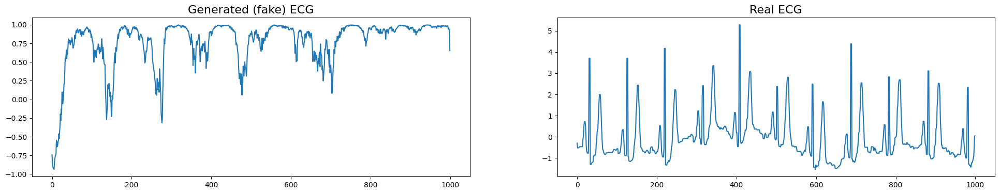

Epoch 2401/3000
Generator loss: 0.5917468667030334
Discriminator loss: 9836550.0
-------------------
Epoch 2402/3000
Generator loss: 0.5634550452232361
Discriminator loss: 11003444.0
-------------------
Epoch 2403/3000
Generator loss: 0.5661066174507141
Discriminator loss: 8267934.5
-------------------
Epoch 2404/3000
Generator loss: 0.5822254419326782
Discriminator loss: 8209192.5
-------------------
Epoch 2405/3000
Generator loss: 0.5469732284545898
Discriminator loss: 9936101.0
-------------------
Epoch 2406/3000
Generator loss: 0.5877289175987244
Discriminator loss: 9646283.0
-------------------
Epoch 2407/3000
Generator loss: 0.5542404651641846
Discriminator loss: 8688134.0
-------------------
Epoch 2408/3000
Generator loss: 0.5189387798309326
Discriminator loss: 8573121.0
-------------------
Epoch 2409/3000
Generator loss: 0.5558730363845825
Discriminator loss: 8648595.0
-------------------
Epoch 2410/3000
Generator loss: 0.5479455590248108
Discriminator loss: 8991921.0
---------

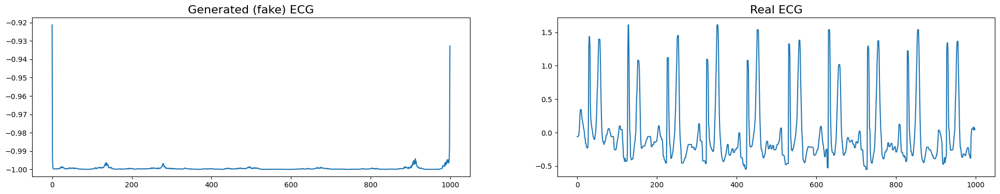

Epoch 2451/3000
Generator loss: 0.5719151496887207
Discriminator loss: 10156104.0
-------------------
Epoch 2452/3000
Generator loss: 0.5479726195335388
Discriminator loss: 6775502.0
-------------------
Epoch 2453/3000
Generator loss: 0.5752237439155579
Discriminator loss: 9912081.0
-------------------
Epoch 2454/3000
Generator loss: 0.5440847873687744
Discriminator loss: 8808902.0
-------------------
Epoch 2455/3000
Generator loss: 0.5693552494049072
Discriminator loss: 9358288.0
-------------------
Epoch 2456/3000
Generator loss: 0.5354137420654297
Discriminator loss: 9476612.0
-------------------
Epoch 2457/3000
Generator loss: 0.5561720132827759
Discriminator loss: 11550020.0
-------------------
Epoch 2458/3000
Generator loss: 0.5507199168205261
Discriminator loss: 8730911.0
-------------------
Epoch 2459/3000
Generator loss: 0.5693756341934204
Discriminator loss: 11555460.0
-------------------
Epoch 2460/3000
Generator loss: 0.5679646730422974
Discriminator loss: 9611808.0
-------

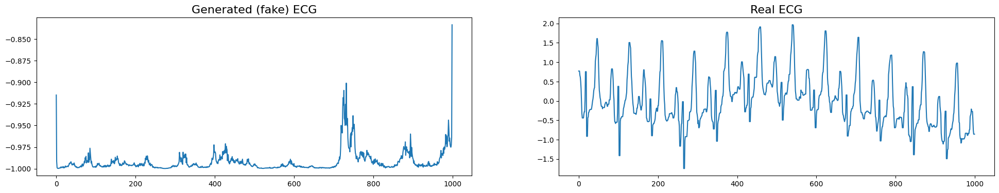

Epoch 2501/3000
Generator loss: 0.5377288460731506
Discriminator loss: 9339786.0
-------------------
Epoch 2502/3000
Generator loss: 0.5545402765274048
Discriminator loss: 10672334.0
-------------------
Epoch 2503/3000
Generator loss: 0.5227185487747192
Discriminator loss: 8649028.0
-------------------
Epoch 2504/3000
Generator loss: 0.58420330286026
Discriminator loss: 9169089.0
-------------------
Epoch 2505/3000
Generator loss: 0.5917046666145325
Discriminator loss: 10532990.0
-------------------
Epoch 2506/3000
Generator loss: 0.5667990446090698
Discriminator loss: 10420472.0
-------------------
Epoch 2507/3000
Generator loss: 0.5605869293212891
Discriminator loss: 10268648.0
-------------------
Epoch 2508/3000
Generator loss: 0.5350586175918579
Discriminator loss: 8503404.0
-------------------
Epoch 2509/3000
Generator loss: 0.5386717915534973
Discriminator loss: 8748932.0
-------------------
Epoch 2510/3000
Generator loss: 0.5521830320358276
Discriminator loss: 11701362.0
-------

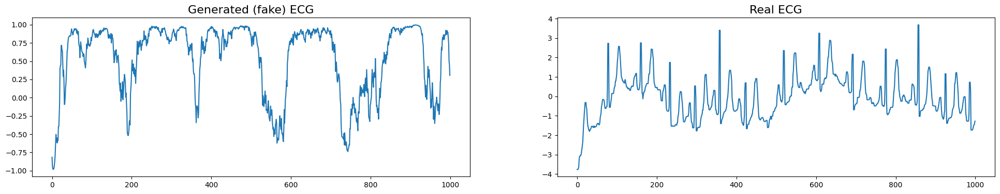

Epoch 2551/3000
Generator loss: 0.5632921457290649
Discriminator loss: 14841674.0
-------------------
Epoch 2552/3000
Generator loss: 0.578944981098175
Discriminator loss: 11679878.0
-------------------
Epoch 2553/3000
Generator loss: 0.524163007736206
Discriminator loss: 7733111.0
-------------------
Epoch 2554/3000
Generator loss: 0.5888669490814209
Discriminator loss: 11339835.0
-------------------
Epoch 2555/3000
Generator loss: 0.5505903363227844
Discriminator loss: 9550353.0
-------------------
Epoch 2556/3000
Generator loss: 0.5587373971939087
Discriminator loss: 7632441.5
-------------------
Epoch 2557/3000
Generator loss: 0.5794374942779541
Discriminator loss: 9909040.0
-------------------
Epoch 2558/3000
Generator loss: 0.5386277437210083
Discriminator loss: 9021491.0
-------------------
Epoch 2559/3000
Generator loss: 0.5494823455810547
Discriminator loss: 10819132.0
-------------------
Epoch 2560/3000
Generator loss: 0.5656837224960327
Discriminator loss: 12134910.0
-------

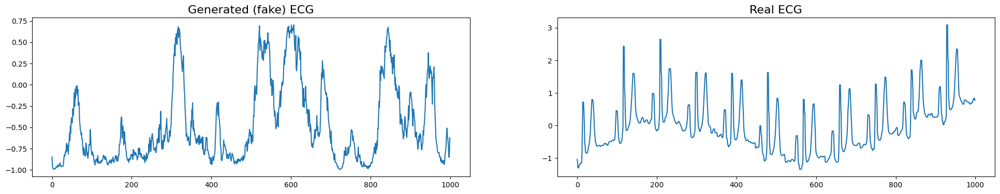

Epoch 2601/3000
Generator loss: 0.5589503049850464
Discriminator loss: 12269231.0
-------------------
Epoch 2602/3000
Generator loss: 0.5698782205581665
Discriminator loss: 9691849.0
-------------------
Epoch 2603/3000
Generator loss: 0.5661357045173645
Discriminator loss: 10303716.0
-------------------
Epoch 2604/3000
Generator loss: 0.5384224653244019
Discriminator loss: 7875129.5
-------------------
Epoch 2605/3000
Generator loss: 0.527156412601471
Discriminator loss: 8485831.0
-------------------
Epoch 2606/3000
Generator loss: 0.5989084243774414
Discriminator loss: 9563338.0
-------------------
Epoch 2607/3000
Generator loss: 0.5480812788009644
Discriminator loss: 10512825.0
-------------------
Epoch 2608/3000
Generator loss: 0.5416126251220703
Discriminator loss: 10203236.0
-------------------
Epoch 2609/3000
Generator loss: 0.577534556388855
Discriminator loss: 9452941.0
-------------------
Epoch 2610/3000
Generator loss: 0.5679870843887329
Discriminator loss: 10178266.0
-------

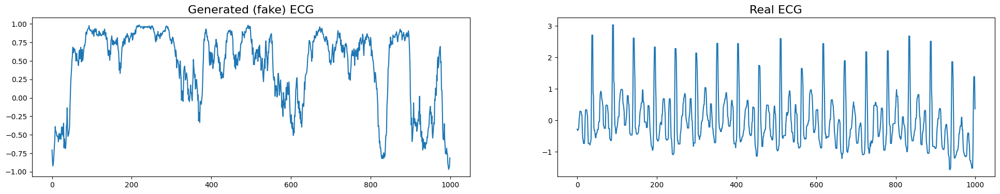

Epoch 2651/3000
Generator loss: 0.5454389452934265
Discriminator loss: 10392138.0
-------------------
Epoch 2652/3000
Generator loss: 0.5158951282501221
Discriminator loss: 8228159.5
-------------------
Epoch 2653/3000
Generator loss: 0.5314664840698242
Discriminator loss: 10006504.0
-------------------
Epoch 2654/3000
Generator loss: 0.535359263420105
Discriminator loss: 8963026.0
-------------------
Epoch 2655/3000
Generator loss: 0.5519022941589355
Discriminator loss: 8847876.0
-------------------
Epoch 2656/3000
Generator loss: 0.557616651058197
Discriminator loss: 9078442.0
-------------------
Epoch 2657/3000
Generator loss: 0.5647516250610352
Discriminator loss: 10186591.0
-------------------
Epoch 2658/3000
Generator loss: 0.5484867095947266
Discriminator loss: 9504318.0
-------------------
Epoch 2659/3000
Generator loss: 0.5378813147544861
Discriminator loss: 10837934.0
-------------------
Epoch 2660/3000
Generator loss: 0.5802668333053589
Discriminator loss: 10653236.0
-------

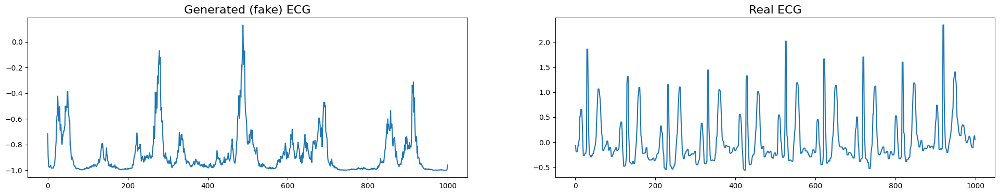

Epoch 2701/3000
Generator loss: 0.5652709007263184
Discriminator loss: 10519504.0
-------------------
Epoch 2702/3000
Generator loss: 0.5945491790771484
Discriminator loss: 14406172.0
-------------------
Epoch 2703/3000
Generator loss: 0.5830278992652893
Discriminator loss: 9937995.0
-------------------
Epoch 2704/3000
Generator loss: 0.5470877885818481
Discriminator loss: 8223864.5
-------------------
Epoch 2705/3000
Generator loss: 0.577415943145752
Discriminator loss: 8692151.0
-------------------
Epoch 2706/3000
Generator loss: 0.49676087498664856
Discriminator loss: 8929574.0
-------------------
Epoch 2707/3000
Generator loss: 0.5525251626968384
Discriminator loss: 10212718.0
-------------------
Epoch 2708/3000
Generator loss: 0.549424409866333
Discriminator loss: 9091461.0
-------------------
Epoch 2709/3000
Generator loss: 0.5193703770637512
Discriminator loss: 10150624.0
-------------------
Epoch 2710/3000
Generator loss: 0.5847102403640747
Discriminator loss: 8318181.5
-------

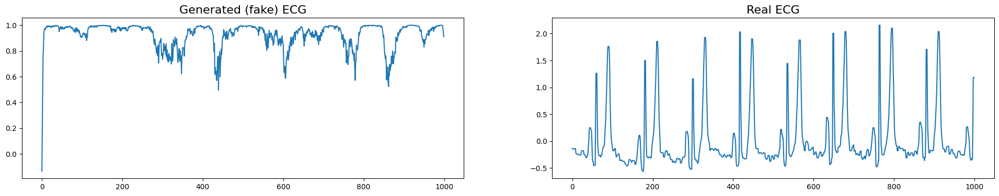

Epoch 2751/3000
Generator loss: 0.5720306634902954
Discriminator loss: 13176548.0
-------------------
Epoch 2752/3000
Generator loss: 0.5358718633651733
Discriminator loss: 10595991.0
-------------------
Epoch 2753/3000
Generator loss: 0.5287243723869324
Discriminator loss: 8571098.0
-------------------
Epoch 2754/3000
Generator loss: 0.4916402995586395
Discriminator loss: 7659135.5
-------------------
Epoch 2755/3000
Generator loss: 0.5797080993652344
Discriminator loss: 9286627.0
-------------------
Epoch 2756/3000
Generator loss: 0.5552971363067627
Discriminator loss: 8975153.0
-------------------
Epoch 2757/3000
Generator loss: 0.5512142181396484
Discriminator loss: 9778282.0
-------------------
Epoch 2758/3000
Generator loss: 0.5652934312820435
Discriminator loss: 10715240.0
-------------------
Epoch 2759/3000
Generator loss: 0.5701016783714294
Discriminator loss: 9918568.0
-------------------
Epoch 2760/3000
Generator loss: 0.5553041696548462
Discriminator loss: 8932398.0
-------

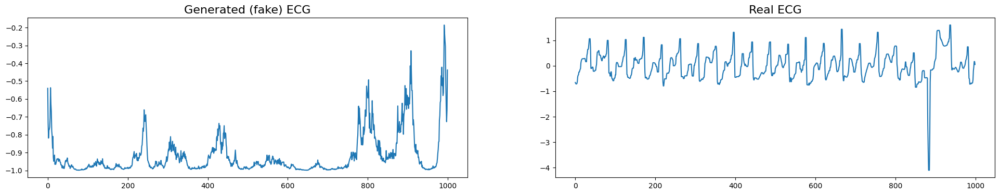

Epoch 2801/3000
Generator loss: 0.5333724021911621
Discriminator loss: 9692265.0
-------------------
Epoch 2802/3000
Generator loss: 0.5576959252357483
Discriminator loss: 10098294.0
-------------------
Epoch 2803/3000
Generator loss: 0.5364805459976196
Discriminator loss: 8159221.5
-------------------
Epoch 2804/3000
Generator loss: 0.5686715245246887
Discriminator loss: 8168731.5
-------------------
Epoch 2805/3000
Generator loss: 0.5462054014205933
Discriminator loss: 11491759.0
-------------------
Epoch 2806/3000
Generator loss: 0.5666341781616211
Discriminator loss: 9838814.0
-------------------
Epoch 2807/3000
Generator loss: 0.5723574757575989
Discriminator loss: 10882446.0
-------------------
Epoch 2808/3000
Generator loss: 0.5563080310821533
Discriminator loss: 11588732.0
-------------------
Epoch 2809/3000
Generator loss: 0.5917428731918335
Discriminator loss: 9254291.0
-------------------
Epoch 2810/3000
Generator loss: 0.5361689925193787
Discriminator loss: 9250164.0
------

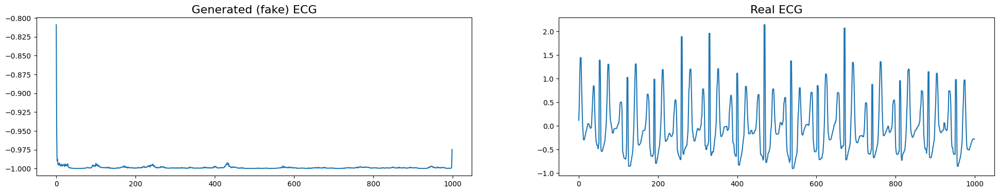

Epoch 2851/3000
Generator loss: 0.5405017137527466
Discriminator loss: 11664440.0
-------------------
Epoch 2852/3000
Generator loss: 0.545918345451355
Discriminator loss: 11543822.0
-------------------
Epoch 2853/3000
Generator loss: 0.5913887023925781
Discriminator loss: 7996709.0
-------------------
Epoch 2854/3000
Generator loss: 0.5361301302909851
Discriminator loss: 8044474.5
-------------------
Epoch 2855/3000
Generator loss: 0.5600199699401855
Discriminator loss: 11316686.0
-------------------
Epoch 2856/3000
Generator loss: 0.5627274513244629
Discriminator loss: 9931540.0
-------------------
Epoch 2857/3000
Generator loss: 0.5681036710739136
Discriminator loss: 10032302.0
-------------------
Epoch 2858/3000
Generator loss: 0.5681205987930298
Discriminator loss: 11365444.0
-------------------
Epoch 2859/3000
Generator loss: 0.557892382144928
Discriminator loss: 11521644.0
-------------------
Epoch 2860/3000
Generator loss: 0.542136013507843
Discriminator loss: 10214808.0
------

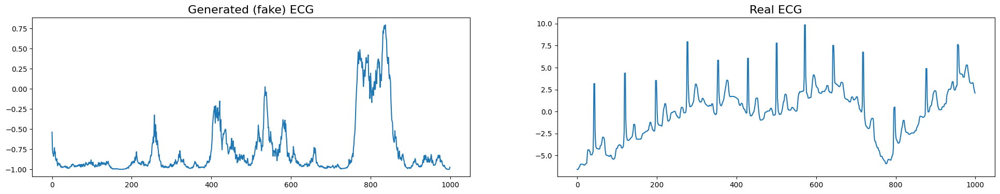

Epoch 2901/3000
Generator loss: 0.5738375782966614
Discriminator loss: 8358382.5
-------------------
Epoch 2902/3000
Generator loss: 0.5353469252586365
Discriminator loss: 10125964.0
-------------------
Epoch 2903/3000
Generator loss: 0.5541020631790161
Discriminator loss: 10272482.0
-------------------
Epoch 2904/3000
Generator loss: 0.5609229207038879
Discriminator loss: 8931093.0
-------------------
Epoch 2905/3000
Generator loss: 0.596076488494873
Discriminator loss: 10297224.0
-------------------
Epoch 2906/3000
Generator loss: 0.511047899723053
Discriminator loss: 8935916.0
-------------------
Epoch 2907/3000
Generator loss: 0.5571351647377014
Discriminator loss: 9358304.0
-------------------
Epoch 2908/3000
Generator loss: 0.5635242462158203
Discriminator loss: 10451599.0
-------------------
Epoch 2909/3000
Generator loss: 0.5655809640884399
Discriminator loss: 12455616.0
-------------------
Epoch 2910/3000
Generator loss: 0.5356606245040894
Discriminator loss: 10389008.0
------

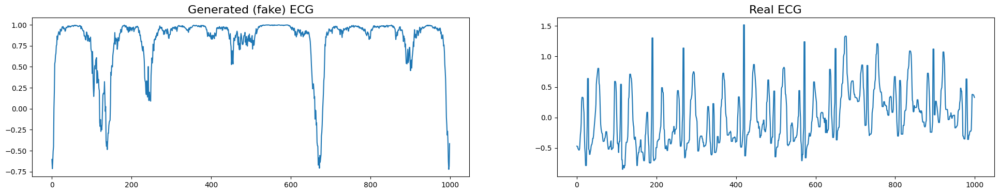

Epoch 2951/3000
Generator loss: 0.5544990301132202
Discriminator loss: 8806291.0
-------------------
Epoch 2952/3000
Generator loss: 0.5539007186889648
Discriminator loss: 11400811.0
-------------------
Epoch 2953/3000
Generator loss: 0.541513204574585
Discriminator loss: 11644239.0
-------------------
Epoch 2954/3000
Generator loss: 0.5592228770256042
Discriminator loss: 7621468.5
-------------------
Epoch 2955/3000
Generator loss: 0.5604931712150574
Discriminator loss: 8755658.0
-------------------
Epoch 2956/3000
Generator loss: 0.5774738788604736
Discriminator loss: 9412701.0
-------------------
Epoch 2957/3000
Generator loss: 0.5539723634719849
Discriminator loss: 12872535.0
-------------------
Epoch 2958/3000
Generator loss: 0.5199246406555176
Discriminator loss: 8598740.0
-------------------
Epoch 2959/3000
Generator loss: 0.6007194519042969
Discriminator loss: 8913225.0
-------------------
Epoch 2960/3000
Generator loss: 0.5273909568786621
Discriminator loss: 11478514.0
-------

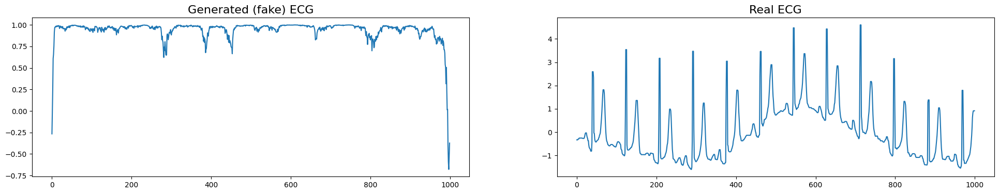

Saved generator weights to: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/inspectionmodel_generator_epoch_3000.weights.h5
Saved discriminator weights to: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/inspectionmodel_discriminator_epoch_3000.weights.h5


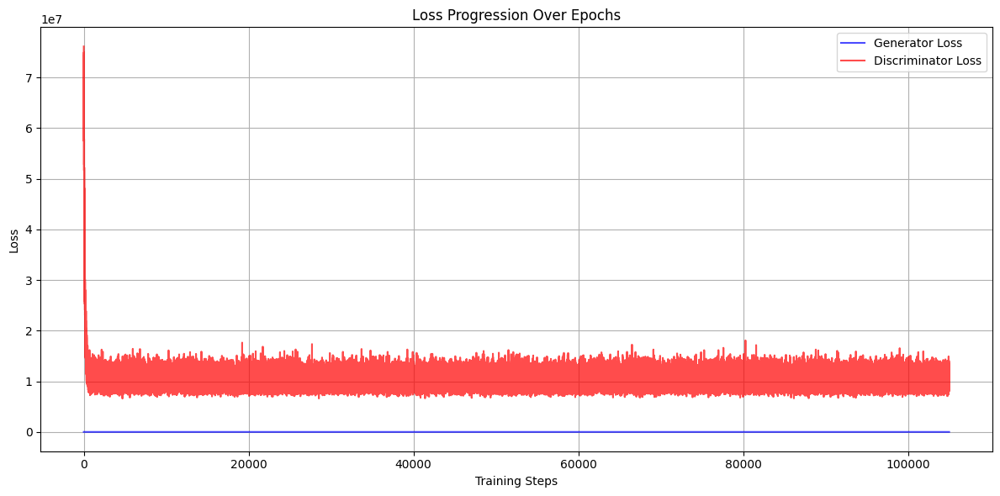

In [15]:
clip_value = 1.0
# Define optimizers with gradient clipping
opt_gen = tf.keras.optimizers.Adam(learning_rate=lr_schedule, clipvalue=clip_value)
opt_desc = tf.keras.optimizers.Adam(learning_rate=lr_schedule, clipvalue=clip_value)

# Updated train step with generator training twice and Wasserstein loss
def train_step(real_data, labels):
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate fake data
        generated_data = con_gen([noise, labels], training=True)

        # Get discriminator outputs
        real_output = con_desc([real_data, labels], training=True)
        fake_output = con_desc([generated_data, labels], training=True)

        # Ensure the outputs are in the correct format
        real_output = real_output[0] if isinstance(real_output, list) else real_output
        fake_output = fake_output[0] if isinstance(fake_output, list) else fake_output

        # Smooth labels for training stability
        y_real_smooth = smooth_positive_labels(tf.ones_like(real_output) * 0.9)  # Same shape as real_output
        y_fake_smooth = smooth_negative_labels(tf.zeros_like(fake_output))  # Same shape as fake_output

        # Apply augmentation to the real ECG data
        augmented_real_data = augment_ecg(real_data)

        # Discriminator Loss with Wasserstein loss
        disc_loss_real = wasserstein_loss(y_real_smooth, real_output)
        disc_loss_fake = wasserstein_loss(y_fake_smooth, fake_output)
        
        # Apply gradient penalty (WGAN)
        loss_gp = gradient_penalty(real_data, generated_data, labels, con_desc)
        disc_loss = disc_loss_real + disc_loss_fake + 3.0 * loss_gp  # Reduced gradient penalty

        # Generator Loss with Wasserstein loss and temporal coherence loss
        gen_loss = wasserstein_loss(tf.ones_like(fake_output), fake_output)

        # Add Temporal Coherence Loss to Generator Loss
        tc_loss = temporal_coherence_loss(real_data, generated_data)
        gen_loss += tc_loss  # Add temporal coherence loss to the generator's total loss
        gen_loss += feature_matching_loss(real_output, fake_output)

    # Compute Gradients
    gradients_of_gen = gen_tape.gradient(gen_loss, con_gen.trainable_variables)
    gradients_of_disc = disc_tape.gradient(disc_loss, con_desc.trainable_variables)

    # Apply Gradients with clipping
    apply_gradients_with_clipping(opt_gen, gradients_of_gen, con_gen.trainable_variables, clip_value)
    apply_gradients_with_clipping(opt_desc, gradients_of_disc, con_desc.trainable_variables, clip_value)

    return gen_loss, disc_loss  # Training Loop with Discriminator-Generator Balance

# Training loop with generator training twice
for epoch in range(epochs):
    print(f"Epoch {epoch + 1}/{epochs}")

    for step in range(steps_per_epoch):
        # Generate real samples
        x_real, y_real = generate_real_samples(ECGs, y_train, batch_size)
        x_real_tensor = tf.convert_to_tensor(x_real, dtype=tf.float32)
        y_real_tensor = tf.convert_to_tensor(y_real, dtype=tf.float32)

        # Perform a training step
        gen_loss, disc_loss = train_step(x_real_tensor, y_real_tensor)

        # Train the generator one more time
        gen_loss, _ = train_step(x_real_tensor, y_real_tensor)  # Train generator twice

        # Store losses for tracking
        accu_loss_gan.append(gen_loss.numpy())
        accu_loss_desc.append(disc_loss.numpy())

    # Print the losses for the epoch
    print(f"Generator loss: {gen_loss.numpy()}")
    print(f"Discriminator loss: {disc_loss.numpy()}")
    print("-------------------")

    # Call the reduce learning rate callback manually after each epoch
    reduce_lr_gen.on_epoch_end(epoch, logs={'loss': gen_loss.numpy()})
    reduce_lr_desc.on_epoch_end(epoch, logs={'loss': disc_loss.numpy()})

    # Save generator and discriminator models periodically
    if (epoch + 1) % 50 == 0:
        res = con_gen.predict([generate_latent_points(latent_dim, 1), tf.convert_to_tensor(np.array([[0]]), dtype=tf.float32)])
        compare_real_and_gen_ecg(res, ECGs)

    # Save weights every 2000 epochs
    if (epoch + 1) % 3000 == 0:
        gen_save_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', f'inspectionmodel_generator_epoch_{epoch + 1}.weights.h5')
        desc_save_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', f'inspectionmodel_discriminator_epoch_{epoch + 1}.weights.h5')

        con_gen.save_weights(gen_save_path)
        con_desc.save_weights(desc_save_path)

        print(f'Saved generator weights to: {gen_save_path}')
        print(f'Saved discriminator weights to: {desc_save_path}')

# Plot Losses After Training
plt.figure(figsize=(12, 6))
plt.plot(accu_loss_gan, label='Generator Loss', color='blue', alpha=0.7)
plt.plot(accu_loss_desc, label='Discriminator Loss', color='red', alpha=0.7)
plt.title('Loss Progression Over Epochs')
plt.xlabel('Training Steps')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


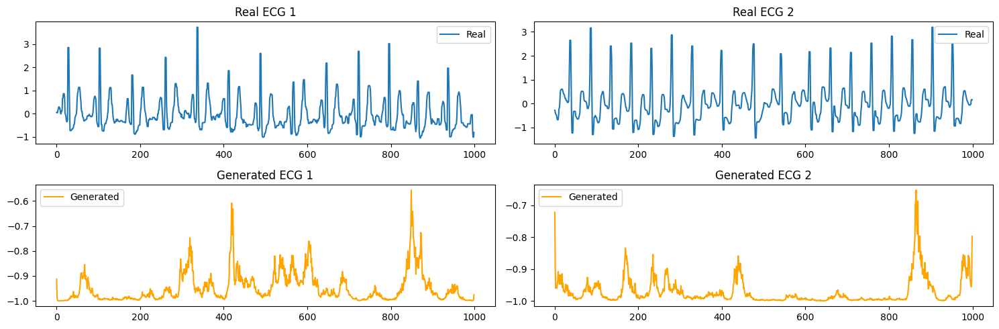

In [26]:
def generate_synthetic_ecgs(generator, latent_dim, labels, num_samples):
    noise = tf.random.normal([num_samples, latent_dim])
    generated_ecgs = generator([noise, labels[:num_samples]], training=False)  # Match label count
    return generated_ecgs.numpy()

# 2. Plot Real vs. Generated ECGs for Comparison
def plot_real_vs_generated(real_ecgs, generated_ecgs, num_samples=2):
    plt.figure(figsize=(15, 5))
    for i in range(num_samples):
        # Plot Real ECG
        plt.subplot(2, num_samples, i + 1)
        plt.plot(tf.reshape(real_ecgs[i], [-1]).numpy(), label="Real")  # Flatten and convert to NumPy
        plt.title(f"Real ECG {i+1}")
        plt.legend()

        # Plot Generated ECG
        plt.subplot(2, num_samples, num_samples + i + 1)
        plt.plot(tf.reshape(generated_ecgs[i], [-1]).numpy(), label="Generated", color='orange')  # Flatten and convert to NumPy
        plt.title(f"Generated ECG {i+1}")
        plt.legend()

    plt.tight_layout()
    plt.show()

# Example Usage
# Evaluation Process
num_samples = 400
test_labels = tf.convert_to_tensor(y_test[:num_samples], dtype=tf.float32)
real_samples = tf.convert_to_tensor(ECGs_test[:num_samples], dtype=tf.float32)

# Generate Synthetic ECGs
synthetic_samples = generate_synthetic_ecgs(con_gen, latent_dim, test_labels, num_samples)

# Visual Comparison
plot_real_vs_generated(real_samples, synthetic_samples)

In [27]:
from sklearn.metrics import mean_squared_error, r2_score
from scipy.linalg import sqrtm

# Load your trained models
gen_model_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', 'inspectionmodel_generator_epoch_3000.weights.h5')
desc_model_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', 'inspectionmodel_discriminator_epoch_3000.weights.h5')

con_gen.load_weights(gen_model_path)
con_desc.load_weights(desc_model_path)

# Latent Dimension and Batch Size
latent_dim = 12
batch_size = 64

# Quantitative Metrics for Generator
def evaluate_generator_quality(real_ecgs, generated_ecgs):
    # Ensure the inputs are NumPy arrays
    real_ecgs_flat = real_ecgs if isinstance(real_ecgs, np.ndarray) else real_ecgs.numpy()
    generated_ecgs_flat = generated_ecgs if isinstance(generated_ecgs, np.ndarray) else generated_ecgs.numpy()
    
    # Flatten the arrays for metric computation
    real_ecgs_flat = real_ecgs_flat.flatten()
    generated_ecgs_flat = generated_ecgs_flat.flatten()
    
    # Compute metrics
    mse = mean_squared_error(real_ecgs_flat, generated_ecgs_flat)
    r2 = r2_score(real_ecgs_flat, generated_ecgs_flat)
    
    print(f"Generator Quality Metrics:")
    print(f"  Mean Squared Error (MSE): {mse:.4f}")
    print(f"  R-Squared (R2): {r2:.4f}")


In [28]:
# Quantitative Metrics
evaluate_generator_quality(real_samples, synthetic_samples)

Generator Quality Metrics:
  Mean Squared Error (MSE): 1.7989
  R-Squared (R2): -0.7421


In [29]:
from tensorflow.keras.models import load_model, Model

# Reload the saved model
saved_model_path = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/feature_extractor_model.h5'
loaded_model = load_model(saved_model_path)
from keras.layers import Input 
# Define the input tensor with the correct shape
input_tensor = Input(shape=(1000, 1))  # Adjust shape based on your input data
model_output = loaded_model(input_tensor)  # Call the model with the new input tensor

# Create the feature extractor using the desired output layer
feature_extractor = Model(inputs=input_tensor, outputs=loaded_model.get_layer('dense_2').output)

# Verify the feature extractor model
feature_extractor.summary()

# Save the feature extractor for later use
feature_extractor_save_path = '/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/feature_extractor_model2.h5'
feature_extractor.save(feature_extractor_save_path)
print(f"Feature extractor saved at {feature_extractor_save_path}")

input_tensor = Input(shape=(1000, 1))  # The input shape is (1000, 1)
feature_extractor_output = loaded_model(input_tensor)  # Use the loaded model to generate output
feature_extractor = Model(inputs=input_tensor, outputs=feature_extractor_output)

# Verify the feature extractor's summary
feature_extractor.summary()

# Now try extracting features
real_ecg_samples = ECGs_test[:100]  # Ensure these are properly formatted
try:
    extracted_features = feature_extractor.predict(real_ecg_samples)
    print("Extracted Features Shape:", extracted_features.shape)
except Exception as e:
    print("Error during feature extraction:", e)

def calculate_fid(real_samples, generated_samples, feature_extractor):
    # Extract features from real and generated samples
    real_features = feature_extractor.predict(real_samples)
    gen_features = feature_extractor.predict(generated_samples)

    # Calculate mean and covariance
    mu_real, sigma_real = np.mean(real_features, axis=0), np.cov(real_features, rowvar=False)
    mu_gen, sigma_gen = np.mean(gen_features, axis=0), np.cov(gen_features, rowvar=False)

    # Ensure covariance matrices are 2D
    sigma_real = np.atleast_2d(sigma_real)
    sigma_gen = np.atleast_2d(sigma_gen)

    # Calculate the difference between the means
    diff = mu_real - mu_gen

    # Calculate the square root of the product of the covariance matrices
    covmean, _ = sqrtm(sigma_real.dot(sigma_gen), disp=False)

    # Ensure the resulting covariance matrix is real (i.e., handle potential complex values)
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    # Calculate FID score
    fid = diff.dot(diff) + np.trace(sigma_real + sigma_gen - 2.0 * covmean)
    return fid


fid_score = calculate_fid(real_samples, synthetic_samples, feature_extractor)
print(f"FID Score: {fid_score}")

Model: "functional_29"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 1000, 1)   │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_6 (Conv1D)   │ (None, 998, 64)   │        256 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 998, 64)   │        256 │ conv1d_6[24][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_6     │ (None, 499, 64)   │          0 │ batch_normalizat… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_6 (Dropout) │ (None, 499, 64)   │          0 │ max_pooling1d_6[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_7 (Conv1D)   │ (None, 497, 32)   │      6,176 │ dropout_6[21][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 497, 32)   │        128 │ conv1d_7[20][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_7     │ (None, 248, 32)   │          0 │ batch_normalizat… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_7 (Dropout) │ (None, 248, 32)   │          0 │ max_pooling1d_7[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_8 (Conv1D)   │ (None, 246, 32)   │      3,104 │ dropout_7[17][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 246, 32)   │        128 │ conv1d_8[16][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_8     │ (None, 123, 32)   │          0 │ batch_normalizat… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_8 (Dropout) │ (None, 123, 32)   │          0 │ max_pooling1d_8[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_9 (Conv1D)   │ (None, 121, 16)   │      1,552 │ dropout_8[13][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 121, 16)   │         64 │ conv1d_9[12][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_9     │ (None, 60, 16)    │          0 │ batch_normalizat… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_9 (Dropout) │ (None, 60, 16)    │          0 │ max_pooling1d_9[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_10 (Conv1D)  │ (None, 58, 16)    │        784 │ dropout_9[9][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 58, 16)    │         64 │ conv1d_10[8][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_10    │ (None, 29, 16)    │          0 │ batch_normalizat

 Total params: 26,736 (104.44 KB)

 Trainable params: 26,384 (103.06 KB)

 Non-trainable params: 352 (1.38 KB)

Feature extractor saved at /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/feature_extractor_model2.h5


Model: "functional_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)      │ (None, 1000, 1)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_1 (Sequential)       │ (None, 1)              │        26,801 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,801 (104.69 KB)

 Trainable params: 26,449 (103.32 KB)

 Non-trainable params: 352 (1.38 KB)

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
Extracted Features Shape: (100, 1)
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
FID Score: 0.17582967298685187


: 

Previous Approch

In [48]:
init_lr_desc = 0.0001
init_lr_gen = 0.0001
opt_desc = tf.keras.optimizers.Adam(learning_rate=init_lr_desc, beta_1=0.5, beta_2=0.9)
opt_gen = tf.keras.optimizers.Adam(learning_rate=init_lr_gen, beta_1=0.5, beta_2=0.9)
gradient_penalty_layer = GradientPenaltyLayer(con_desc)

accu_loss_gan = []
accu_loss_desc = []

batch_size = 64
steps_per_epoch = len(ECGs) // batch_size
half_batch = batch_size // 2
epochs = 5000
from tensorflow.keras.callbacks import Callback
class CustomReduceLROnPlateau(tf.keras.callbacks.Callback):
    def __init__(self, optimizer, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1):
        super(CustomReduceLROnPlateau, self).__init__()
        self.optimizer = optimizer
        self.monitor = monitor
        self.factor = factor
        self.patience = patience
        self.min_lr = min_lr
        self.verbose = verbose
        self.best = np.inf  # Changed from np.Inf to np.inf
        self.wait = 0

    def on_epoch_end(self, epoch, logs=None):
        current = logs.get(self.monitor)
        if current is None:
            return

        if np.less(current, self.best):
            self.best = current
            self.wait = 0
        else:
            self.wait += 1
            if self.wait >= self.patience:
                # Get the current learning rate value
                old_lr = self.optimizer.learning_rate.numpy()  # Directly access the learning rate
                if old_lr > self.min_lr:
                    new_lr = max(old_lr * self.factor, self.min_lr)
                    # Update the learning rate directly
                    self.optimizer.learning_rate = new_lr
                    if self.verbose > 0:
                        print(f'\nEpoch {epoch + 1}: ReduceLROnPlateau reducing learning rate to {new_lr}.')
                self.wait = 0

# Create instances of the modified CustomReduceLROnPlateau for the generators and discriminators
reduce_lr_gen = CustomReduceLROnPlateau(opt_gen, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1)
reduce_lr_desc = CustomReduceLROnPlateau(opt_desc, monitor='loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1)



lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.00001, 
    decay_steps=500, 
    decay_rate=0.5, 
    staircase=True
)
opt_gen = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
opt_desc = tf.keras.optimizers.Adam(learning_rate=lr_schedule)

gradient_penalty_layer = GradientPenaltyLayer(con_desc)

Error configuring GPUs: Physical devices cannot be modified after being initialized
Epoch 1/5000
Generator loss: 0.93622887134552
Discriminator loss: 52858404.0
-------------------
Epoch 2/5000
Generator loss: 0.9429415464401245
Discriminator loss: 47353872.0
-------------------
Epoch 3/5000
Generator loss: 0.9172385931015015
Discriminator loss: 45697008.0
-------------------
Epoch 4/5000
Generator loss: 0.9191393852233887
Discriminator loss: 41886224.0
-------------------
Epoch 5/5000
Generator loss: 0.9271563291549683
Discriminator loss: 40499604.0
-------------------
Epoch 6/5000
Generator loss: 0.913173258304596
Discriminator loss: 39985384.0
-------------------
Epoch 7/5000
Generator loss: 0.8990111351013184
Discriminator loss: 37656300.0
-------------------
Epoch 8/5000
Generator loss: 0.912750780582428
Discriminator loss: 35750772.0
-------------------
Epoch 9/5000
Generator loss: 0.912590503692627
Discriminator loss: 34808176.0
-------------------
Epoch 10/5000
Generator loss: 

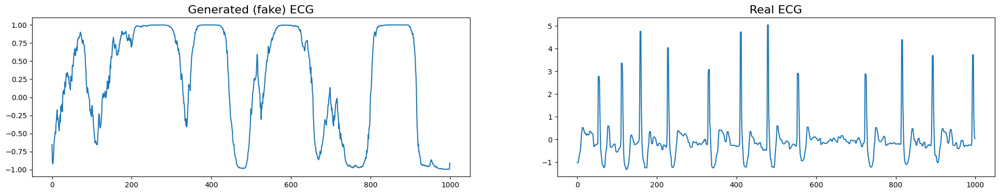

Epoch 51/5000
Generator loss: 0.9080405235290527
Discriminator loss: 29471566.0
-------------------
Epoch 52/5000
Generator loss: 0.934314489364624
Discriminator loss: 29724860.0
-------------------
Epoch 53/5000
Generator loss: 0.9430771470069885
Discriminator loss: 27794240.0
-------------------
Epoch 54/5000
Generator loss: 0.9311738014221191
Discriminator loss: 30864110.0
-------------------
Epoch 55/5000
Generator loss: 0.9320948123931885
Discriminator loss: 29895800.0
-------------------
Epoch 56/5000
Generator loss: 0.9086318016052246
Discriminator loss: 29222342.0
-------------------
Epoch 57/5000
Generator loss: 0.9146412014961243
Discriminator loss: 30311720.0
-------------------
Epoch 58/5000
Generator loss: 0.9061282873153687
Discriminator loss: 29576870.0
-------------------
Epoch 59/5000
Generator loss: 0.9129181504249573
Discriminator loss: 29131688.0
-------------------
Epoch 60/5000
Generator loss: 0.9343094229698181
Discriminator loss: 31233860.0
-------------------
E

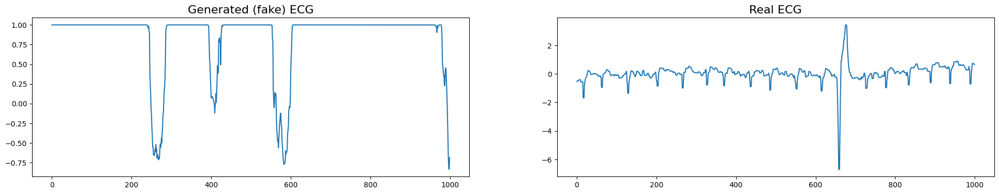

Epoch 101/5000
Generator loss: 0.9614368081092834
Discriminator loss: 28877000.0
-------------------
Epoch 102/5000
Generator loss: 0.9248561859130859
Discriminator loss: 27085978.0
-------------------
Epoch 103/5000
Generator loss: 0.9088823795318604
Discriminator loss: 29696678.0
-------------------
Epoch 104/5000
Generator loss: 0.904014527797699
Discriminator loss: 28646420.0
-------------------
Epoch 105/5000
Generator loss: 0.904956042766571
Discriminator loss: 28889456.0
-------------------
Epoch 106/5000
Generator loss: 0.9350264668464661
Discriminator loss: 30070856.0
-------------------
Epoch 107/5000
Generator loss: 0.8955545425415039
Discriminator loss: 28734422.0
-------------------
Epoch 108/5000
Generator loss: 0.920777440071106
Discriminator loss: 28859474.0
-------------------
Epoch 109/5000
Generator loss: 0.9134962558746338
Discriminator loss: 31359378.0
-------------------
Epoch 110/5000
Generator loss: 0.9120848178863525
Discriminator loss: 29257394.0
-------------

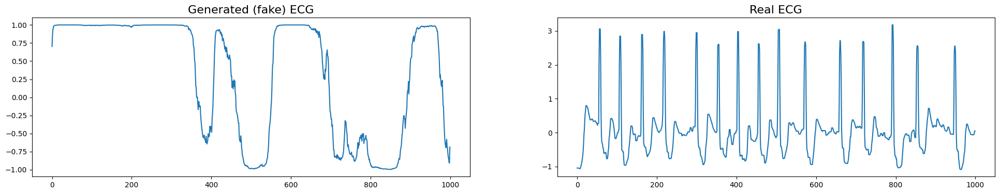

Epoch 151/5000
Generator loss: 0.926593542098999
Discriminator loss: 30131258.0
-------------------
Epoch 152/5000
Generator loss: 0.9379830360412598
Discriminator loss: 29046710.0
-------------------
Epoch 153/5000
Generator loss: 0.9352182745933533
Discriminator loss: 29778314.0
-------------------
Epoch 154/5000
Generator loss: 0.921457052230835
Discriminator loss: 28379732.0
-------------------
Epoch 155/5000
Generator loss: 0.9132629036903381
Discriminator loss: 29179438.0
-------------------
Epoch 156/5000
Generator loss: 0.917905867099762
Discriminator loss: 28624400.0
-------------------
Epoch 157/5000
Generator loss: 0.9224666357040405
Discriminator loss: 29147228.0
-------------------
Epoch 158/5000
Generator loss: 0.8935717344284058
Discriminator loss: 29725830.0
-------------------
Epoch 159/5000
Generator loss: 0.930137574672699
Discriminator loss: 28970374.0
-------------------
Epoch 160/5000
Generator loss: 0.9187302589416504
Discriminator loss: 27155382.0
--------------

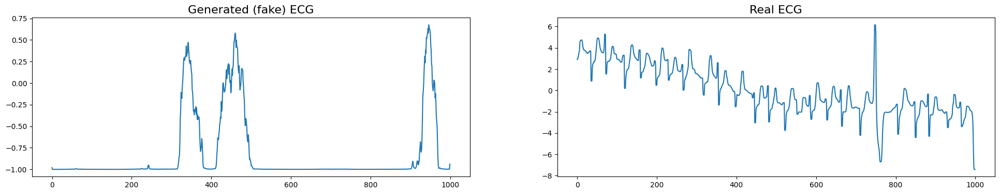

Epoch 201/5000
Generator loss: 0.9365159273147583
Discriminator loss: 28160138.0
-------------------
Epoch 202/5000
Generator loss: 0.9029616713523865
Discriminator loss: 28079816.0
-------------------
Epoch 203/5000
Generator loss: 0.9437379837036133
Discriminator loss: 28735100.0
-------------------
Epoch 204/5000
Generator loss: 0.9051738977432251
Discriminator loss: 28013102.0
-------------------
Epoch 205/5000
Generator loss: 0.921491265296936
Discriminator loss: 29444266.0
-------------------
Epoch 206/5000
Generator loss: 0.8869603872299194
Discriminator loss: 29317858.0
-------------------
Epoch 207/5000
Generator loss: 0.9445903301239014
Discriminator loss: 29099386.0
-------------------
Epoch 208/5000
Generator loss: 0.8882306218147278
Discriminator loss: 27971408.0
-------------------
Epoch 209/5000
Generator loss: 0.9268814921379089
Discriminator loss: 29494242.0
-------------------
Epoch 210/5000
Generator loss: 0.9183539152145386
Discriminator loss: 28011692.0
-----------

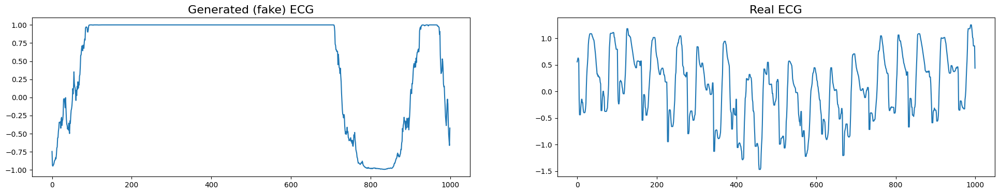

Epoch 251/5000
Generator loss: 0.9054286479949951
Discriminator loss: 30424342.0
-------------------
Epoch 252/5000
Generator loss: 0.9292742013931274
Discriminator loss: 29623478.0
-------------------
Epoch 253/5000
Generator loss: 0.90699303150177
Discriminator loss: 28332704.0
-------------------
Epoch 254/5000
Generator loss: 0.9374566078186035
Discriminator loss: 28997938.0
-------------------
Epoch 255/5000
Generator loss: 0.9357141256332397
Discriminator loss: 29641892.0
-------------------
Epoch 256/5000
Generator loss: 0.9197919964790344
Discriminator loss: 27810158.0
-------------------
Epoch 257/5000
Generator loss: 0.9223728179931641
Discriminator loss: 30363968.0
-------------------
Epoch 258/5000
Generator loss: 0.888859748840332
Discriminator loss: 29408126.0
-------------------
Epoch 259/5000
Generator loss: 0.895601749420166
Discriminator loss: 30575054.0
-------------------
Epoch 260/5000
Generator loss: 0.9061649441719055
Discriminator loss: 28618820.0
--------------

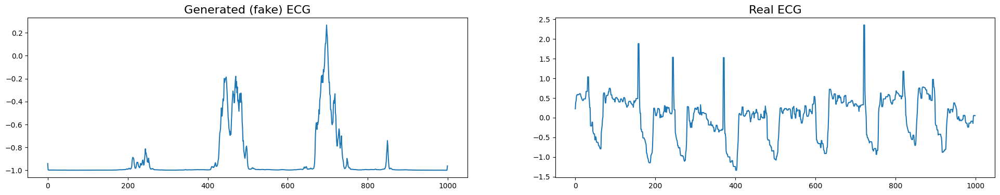

Epoch 301/5000
Generator loss: 0.9462953209877014
Discriminator loss: 30341324.0
-------------------
Epoch 302/5000
Generator loss: 0.9543743133544922
Discriminator loss: 31185308.0
-------------------
Epoch 303/5000
Generator loss: 0.9244149923324585
Discriminator loss: 28594546.0
-------------------
Epoch 304/5000
Generator loss: 0.9433919191360474
Discriminator loss: 29325606.0
-------------------
Epoch 305/5000
Generator loss: 0.8887840509414673
Discriminator loss: 29221466.0
-------------------
Epoch 306/5000
Generator loss: 0.916473388671875
Discriminator loss: 29638658.0
-------------------
Epoch 307/5000
Generator loss: 0.9518961310386658
Discriminator loss: 29095172.0
-------------------
Epoch 308/5000
Generator loss: 0.9673442840576172
Discriminator loss: 29577990.0
-------------------
Epoch 309/5000
Generator loss: 0.9378567934036255
Discriminator loss: 29990606.0
-------------------
Epoch 310/5000
Generator loss: 0.9126724004745483
Discriminator loss: 28443606.0
-----------

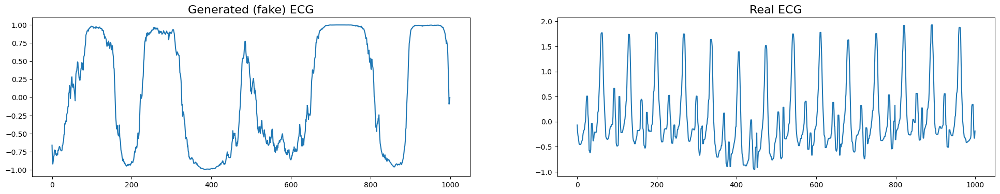

Epoch 351/5000
Generator loss: 0.8912366628646851
Discriminator loss: 28266464.0
-------------------
Epoch 352/5000
Generator loss: 0.9227564334869385
Discriminator loss: 30201884.0
-------------------
Epoch 353/5000
Generator loss: 0.92954421043396
Discriminator loss: 27580478.0
-------------------
Epoch 354/5000
Generator loss: 0.931106686592102
Discriminator loss: 27390042.0
-------------------
Epoch 355/5000
Generator loss: 0.9267889261245728
Discriminator loss: 28563546.0
-------------------
Epoch 356/5000
Generator loss: 0.9409237504005432
Discriminator loss: 29610122.0
-------------------
Epoch 357/5000
Generator loss: 0.9106128811836243
Discriminator loss: 28561014.0
-------------------
Epoch 358/5000
Generator loss: 0.9007786512374878
Discriminator loss: 28605862.0
-------------------
Epoch 359/5000
Generator loss: 0.9039879441261292
Discriminator loss: 28513862.0
-------------------
Epoch 360/5000
Generator loss: 0.9228373765945435
Discriminator loss: 28820192.0
-------------

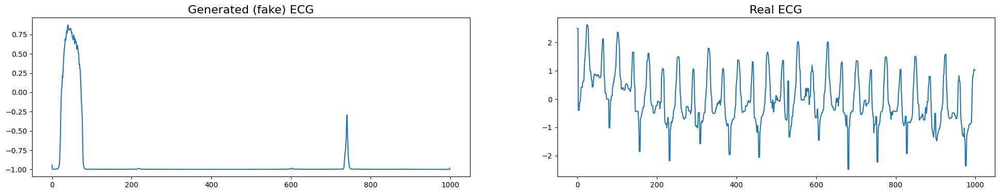

Epoch 401/5000
Generator loss: 0.9039700031280518
Discriminator loss: 28298930.0
-------------------
Epoch 402/5000
Generator loss: 0.915603756904602
Discriminator loss: 28316792.0
-------------------
Epoch 403/5000
Generator loss: 0.9739949703216553
Discriminator loss: 30573488.0
-------------------
Epoch 404/5000
Generator loss: 0.959035336971283
Discriminator loss: 29944772.0
-------------------
Epoch 405/5000
Generator loss: 0.8928326368331909
Discriminator loss: 28912178.0
-------------------
Epoch 406/5000
Generator loss: 0.8865124583244324
Discriminator loss: 30172554.0
-------------------
Epoch 407/5000
Generator loss: 0.8808110356330872
Discriminator loss: 28286744.0
-------------------
Epoch 408/5000
Generator loss: 0.9388150572776794
Discriminator loss: 29306526.0
-------------------
Epoch 409/5000
Generator loss: 0.930067777633667
Discriminator loss: 28557254.0
-------------------
Epoch 410/5000
Generator loss: 0.8998699188232422
Discriminator loss: 27158666.0
-------------

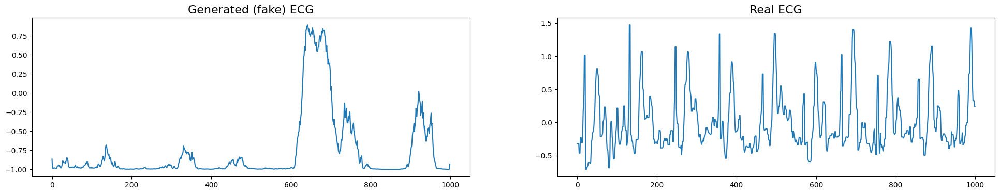

Epoch 451/5000
Generator loss: 0.8982874155044556
Discriminator loss: 30727136.0
-------------------
Epoch 452/5000
Generator loss: 0.9200928211212158
Discriminator loss: 29004694.0
-------------------
Epoch 453/5000
Generator loss: 0.9238549470901489
Discriminator loss: 28534088.0
-------------------
Epoch 454/5000
Generator loss: 0.9023950099945068
Discriminator loss: 30463610.0
-------------------
Epoch 455/5000
Generator loss: 0.8843696117401123
Discriminator loss: 29140964.0
-------------------
Epoch 456/5000
Generator loss: 0.9485279321670532
Discriminator loss: 28098362.0
-------------------
Epoch 457/5000
Generator loss: 0.9024951457977295
Discriminator loss: 28320830.0
-------------------
Epoch 458/5000
Generator loss: 0.9359754323959351
Discriminator loss: 28732934.0
-------------------
Epoch 459/5000
Generator loss: 0.9275705814361572
Discriminator loss: 29757764.0
-------------------
Epoch 460/5000
Generator loss: 0.8972778916358948
Discriminator loss: 28484914.0
----------

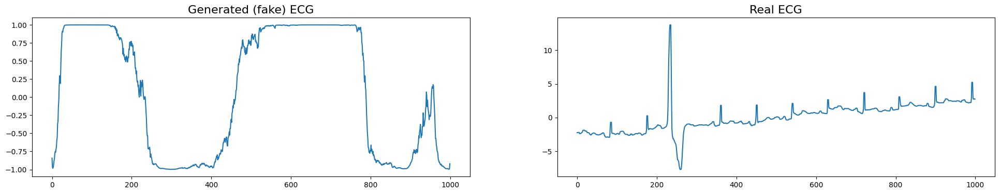

Epoch 501/5000
Generator loss: 0.9659146070480347
Discriminator loss: 31070190.0
-------------------
Epoch 502/5000
Generator loss: 0.9175938963890076
Discriminator loss: 30062840.0
-------------------
Epoch 503/5000
Generator loss: 0.9167401194572449
Discriminator loss: 27942944.0
-------------------
Epoch 504/5000
Generator loss: 0.9566256999969482
Discriminator loss: 29390794.0
-------------------
Epoch 505/5000
Generator loss: 0.8819921016693115
Discriminator loss: 28993316.0
-------------------
Epoch 506/5000
Generator loss: 0.9181663393974304
Discriminator loss: 29562118.0
-------------------
Epoch 507/5000
Generator loss: 0.9369168281555176
Discriminator loss: 30240284.0
-------------------
Epoch 508/5000
Generator loss: 0.9100993275642395
Discriminator loss: 29255888.0
-------------------
Epoch 509/5000
Generator loss: 0.893211841583252
Discriminator loss: 30047234.0
-------------------
Epoch 510/5000
Generator loss: 0.891442060470581
Discriminator loss: 29499320.0
------------

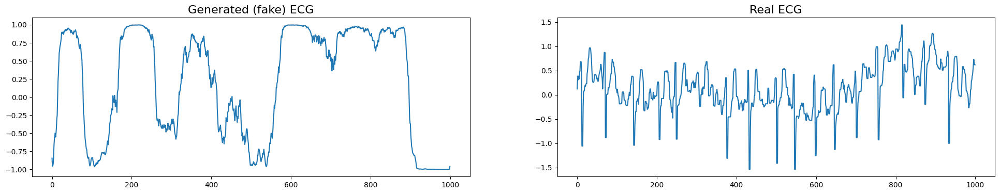

Epoch 551/5000
Generator loss: 0.941865086555481
Discriminator loss: 28576688.0
-------------------
Epoch 552/5000
Generator loss: 0.9107563495635986
Discriminator loss: 28552646.0
-------------------
Epoch 553/5000
Generator loss: 0.9382614493370056
Discriminator loss: 29707064.0
-------------------
Epoch 554/5000
Generator loss: 0.9321708679199219
Discriminator loss: 29427488.0
-------------------
Epoch 555/5000
Generator loss: 0.882381796836853
Discriminator loss: 28396148.0
-------------------
Epoch 556/5000
Generator loss: 0.908275842666626
Discriminator loss: 28864918.0
-------------------
Epoch 557/5000
Generator loss: 0.9101176261901855
Discriminator loss: 29587598.0
-------------------
Epoch 558/5000
Generator loss: 0.8916969299316406
Discriminator loss: 26165828.0
-------------------
Epoch 559/5000
Generator loss: 0.8966001272201538
Discriminator loss: 29114204.0
-------------------
Epoch 560/5000
Generator loss: 0.9424662590026855
Discriminator loss: 28122706.0
-------------

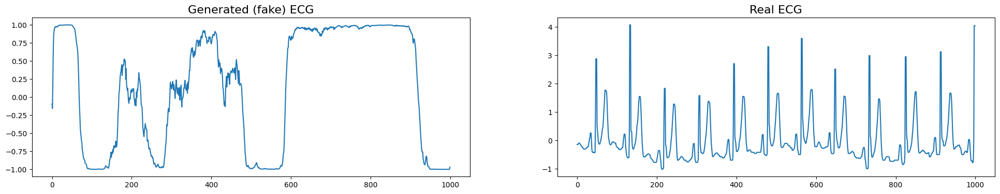

Epoch 601/5000
Generator loss: 0.8822428584098816
Discriminator loss: 28572130.0
-------------------
Epoch 602/5000
Generator loss: 0.9311501979827881
Discriminator loss: 27384962.0
-------------------
Epoch 603/5000
Generator loss: 0.9495950937271118
Discriminator loss: 30196316.0
-------------------
Epoch 604/5000
Generator loss: 0.8947209119796753
Discriminator loss: 29809690.0
-------------------
Epoch 605/5000
Generator loss: 0.9486088752746582
Discriminator loss: 28115252.0
-------------------
Epoch 606/5000
Generator loss: 0.9788118600845337
Discriminator loss: 29442008.0
-------------------
Epoch 607/5000
Generator loss: 0.9478693008422852
Discriminator loss: 28051832.0
-------------------
Epoch 608/5000
Generator loss: 0.9335887432098389
Discriminator loss: 29257784.0
-------------------
Epoch 609/5000
Generator loss: 0.9327636957168579
Discriminator loss: 28895612.0
-------------------
Epoch 610/5000
Generator loss: 0.9195358157157898
Discriminator loss: 27884558.0
----------

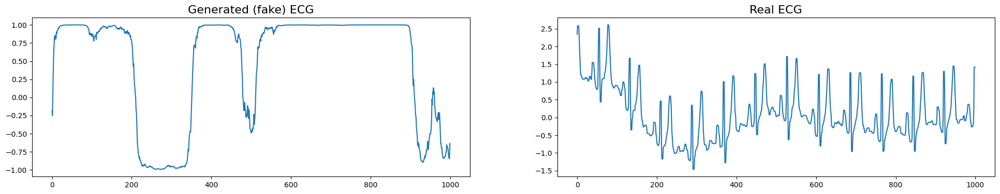

Epoch 651/5000
Generator loss: 0.94596928358078
Discriminator loss: 28770638.0
-------------------
Epoch 652/5000
Generator loss: 0.9058715105056763
Discriminator loss: 27974950.0
-------------------
Epoch 653/5000
Generator loss: 0.9229486584663391
Discriminator loss: 28510538.0
-------------------
Epoch 654/5000
Generator loss: 0.9452584981918335
Discriminator loss: 28227680.0
-------------------
Epoch 655/5000
Generator loss: 0.8978581428527832
Discriminator loss: 29529512.0
-------------------
Epoch 656/5000
Generator loss: 0.9303085803985596
Discriminator loss: 29791510.0
-------------------
Epoch 657/5000
Generator loss: 0.965229332447052
Discriminator loss: 30678038.0
-------------------
Epoch 658/5000
Generator loss: 0.9240812063217163
Discriminator loss: 28255762.0
-------------------
Epoch 659/5000
Generator loss: 0.8954293727874756
Discriminator loss: 29094476.0
-------------------
Epoch 660/5000
Generator loss: 0.9784653186798096
Discriminator loss: 28750682.0
-------------

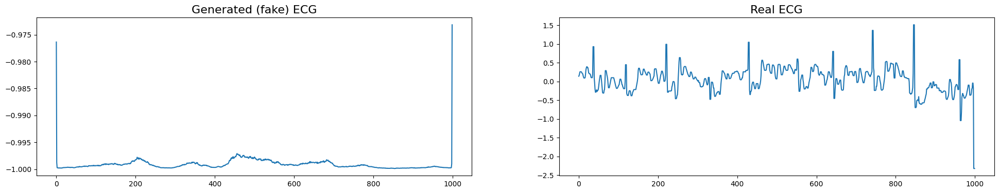

Epoch 701/5000
Generator loss: 0.9513735771179199
Discriminator loss: 30342658.0
-------------------
Epoch 702/5000
Generator loss: 0.9218789935112
Discriminator loss: 29101610.0
-------------------
Epoch 703/5000
Generator loss: 0.9376153945922852
Discriminator loss: 29399924.0
-------------------
Epoch 704/5000
Generator loss: 0.875817060470581
Discriminator loss: 30013172.0
-------------------
Epoch 705/5000
Generator loss: 0.9383089542388916
Discriminator loss: 30398474.0
-------------------
Epoch 706/5000
Generator loss: 0.935238242149353
Discriminator loss: 30452834.0
-------------------
Epoch 707/5000
Generator loss: 0.9133497476577759
Discriminator loss: 27447346.0
-------------------
Epoch 708/5000
Generator loss: 0.9191964864730835
Discriminator loss: 30450554.0
-------------------
Epoch 709/5000
Generator loss: 0.9330867528915405
Discriminator loss: 30658184.0
-------------------
Epoch 710/5000
Generator loss: 0.8944279551506042
Discriminator loss: 28273662.0
---------------

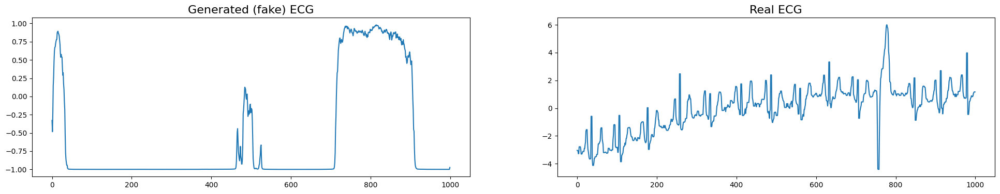

Epoch 751/5000
Generator loss: 0.9121910333633423
Discriminator loss: 28387382.0
-------------------
Epoch 752/5000
Generator loss: 0.8935085535049438
Discriminator loss: 29626966.0
-------------------
Epoch 753/5000
Generator loss: 0.9438921213150024
Discriminator loss: 29976198.0
-------------------
Epoch 754/5000
Generator loss: 0.9254738092422485
Discriminator loss: 29579958.0
-------------------
Epoch 755/5000
Generator loss: 0.9614841341972351
Discriminator loss: 30118266.0
-------------------
Epoch 756/5000
Generator loss: 0.9388720393180847
Discriminator loss: 30870838.0
-------------------
Epoch 757/5000
Generator loss: 0.9340544939041138
Discriminator loss: 30162826.0
-------------------
Epoch 758/5000
Generator loss: 0.901343584060669
Discriminator loss: 29064758.0
-------------------
Epoch 759/5000
Generator loss: 0.9027538895606995
Discriminator loss: 28947530.0
-------------------
Epoch 760/5000
Generator loss: 0.9044762849807739
Discriminator loss: 28325060.0
-----------

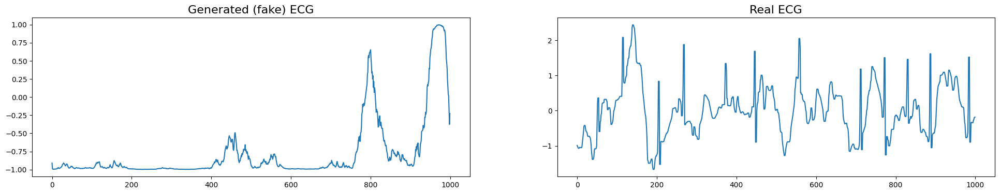

Epoch 801/5000
Generator loss: 0.9186488389968872
Discriminator loss: 29549096.0
-------------------
Epoch 802/5000
Generator loss: 0.9631627798080444
Discriminator loss: 27096086.0
-------------------
Epoch 803/5000
Generator loss: 0.947089672088623
Discriminator loss: 29150834.0
-------------------
Epoch 804/5000
Generator loss: 0.9365906715393066
Discriminator loss: 29162066.0
-------------------
Epoch 805/5000
Generator loss: 0.9304207563400269
Discriminator loss: 30114738.0
-------------------
Epoch 806/5000
Generator loss: 0.9070574641227722
Discriminator loss: 29914598.0
-------------------
Epoch 807/5000
Generator loss: 0.9104259014129639
Discriminator loss: 30497842.0
-------------------
Epoch 808/5000
Generator loss: 0.9081258773803711
Discriminator loss: 28764050.0
-------------------
Epoch 809/5000
Generator loss: 0.9537639021873474
Discriminator loss: 29416262.0
-------------------
Epoch 810/5000
Generator loss: 0.926892876625061
Discriminator loss: 28285146.0
------------

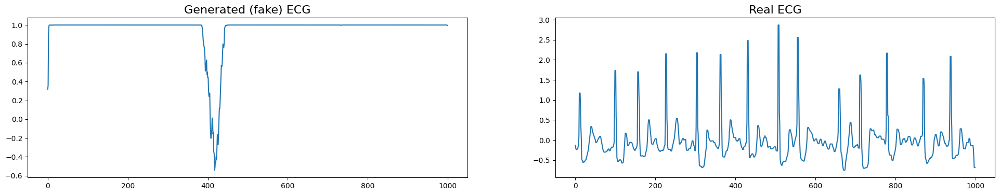

Epoch 851/5000
Generator loss: 0.9059942960739136
Discriminator loss: 30360116.0
-------------------
Epoch 852/5000
Generator loss: 0.9287638068199158
Discriminator loss: 29166518.0
-------------------
Epoch 853/5000
Generator loss: 0.8856388926506042
Discriminator loss: 30344678.0
-------------------
Epoch 854/5000
Generator loss: 0.9117035865783691
Discriminator loss: 28117154.0
-------------------
Epoch 855/5000
Generator loss: 0.9298969507217407
Discriminator loss: 28052456.0
-------------------
Epoch 856/5000
Generator loss: 0.9358954429626465
Discriminator loss: 30368756.0
-------------------
Epoch 857/5000
Generator loss: 0.8801048398017883
Discriminator loss: 28457948.0
-------------------
Epoch 858/5000
Generator loss: 0.956593930721283
Discriminator loss: 28727442.0
-------------------
Epoch 859/5000
Generator loss: 0.914393961429596
Discriminator loss: 27610846.0
-------------------
Epoch 860/5000
Generator loss: 0.904123067855835
Discriminator loss: 30306186.0
-------------

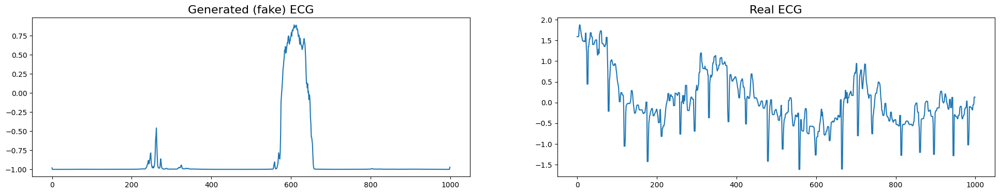

Epoch 901/5000
Generator loss: 0.9337698221206665
Discriminator loss: 29577392.0
-------------------
Epoch 902/5000
Generator loss: 0.9163221120834351
Discriminator loss: 29993984.0
-------------------
Epoch 903/5000
Generator loss: 0.95420241355896
Discriminator loss: 29615600.0
-------------------
Epoch 904/5000
Generator loss: 0.8949334025382996
Discriminator loss: 28945702.0
-------------------
Epoch 905/5000
Generator loss: 0.9365084767341614
Discriminator loss: 29981202.0
-------------------
Epoch 906/5000
Generator loss: 0.9157365560531616
Discriminator loss: 29193914.0
-------------------
Epoch 907/5000
Generator loss: 0.9358022809028625
Discriminator loss: 29179734.0
-------------------
Epoch 908/5000
Generator loss: 0.8720717430114746
Discriminator loss: 28633898.0
-------------------
Epoch 909/5000
Generator loss: 0.9020273089408875
Discriminator loss: 26547596.0
-------------------
Epoch 910/5000
Generator loss: 0.9228988885879517
Discriminator loss: 29078226.0
------------

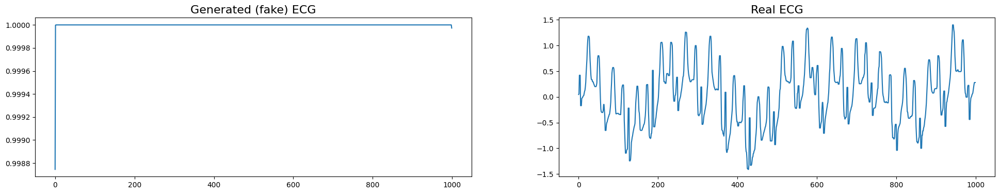

Epoch 951/5000
Generator loss: 0.8943631649017334
Discriminator loss: 29578766.0
-------------------
Epoch 952/5000
Generator loss: 0.9575982093811035
Discriminator loss: 28164980.0
-------------------
Epoch 953/5000
Generator loss: 0.9104723334312439
Discriminator loss: 30908786.0
-------------------
Epoch 954/5000
Generator loss: 0.918883204460144
Discriminator loss: 27801488.0
-------------------
Epoch 955/5000
Generator loss: 0.9322748780250549
Discriminator loss: 30186866.0
-------------------
Epoch 956/5000
Generator loss: 0.913872241973877
Discriminator loss: 28313818.0
-------------------
Epoch 957/5000
Generator loss: 0.9145668148994446
Discriminator loss: 30434942.0
-------------------
Epoch 958/5000
Generator loss: 0.9006257057189941
Discriminator loss: 28185130.0
-------------------
Epoch 959/5000
Generator loss: 0.9196078181266785
Discriminator loss: 28834310.0
-------------------
Epoch 960/5000
Generator loss: 0.9361625909805298
Discriminator loss: 28072494.0
------------

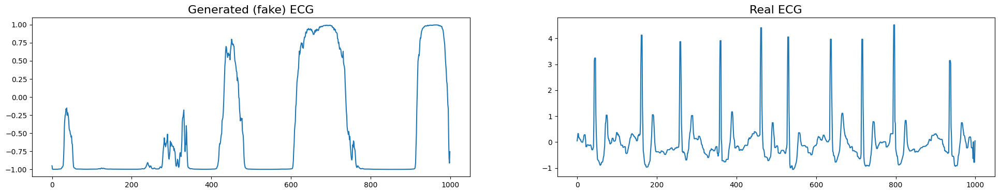

Epoch 1001/5000
Generator loss: 0.9033499956130981
Discriminator loss: 27196122.0
-------------------
Epoch 1002/5000
Generator loss: 0.9398436546325684
Discriminator loss: 28701020.0
-------------------
Epoch 1003/5000
Generator loss: 0.9176706075668335
Discriminator loss: 28853210.0
-------------------
Epoch 1004/5000
Generator loss: 0.9500661492347717
Discriminator loss: 29538572.0
-------------------
Epoch 1005/5000
Generator loss: 0.9282311201095581
Discriminator loss: 28703972.0
-------------------
Epoch 1006/5000
Generator loss: 0.9083448648452759
Discriminator loss: 28186862.0
-------------------
Epoch 1007/5000
Generator loss: 0.9674718379974365
Discriminator loss: 29383266.0
-------------------
Epoch 1008/5000
Generator loss: 0.911329984664917
Discriminator loss: 27999178.0
-------------------
Epoch 1009/5000
Generator loss: 0.9193359613418579
Discriminator loss: 28469180.0
-------------------
Epoch 1010/5000
Generator loss: 0.9110680818557739
Discriminator loss: 29925046.0
-

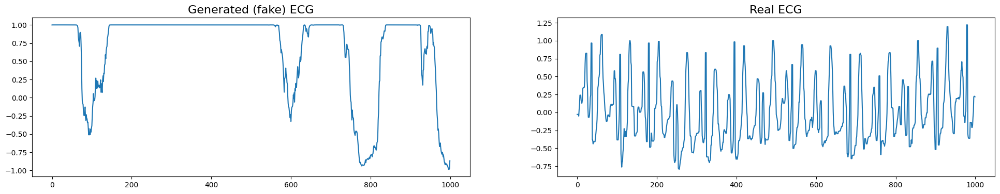

Epoch 1051/5000
Generator loss: 0.9103744029998779
Discriminator loss: 28664782.0
-------------------
Epoch 1052/5000
Generator loss: 0.9185824394226074
Discriminator loss: 28013314.0
-------------------
Epoch 1053/5000
Generator loss: 0.9613940715789795
Discriminator loss: 28156070.0
-------------------
Epoch 1054/5000
Generator loss: 0.8933998346328735
Discriminator loss: 29878802.0
-------------------
Epoch 1055/5000
Generator loss: 0.9054315090179443
Discriminator loss: 27968298.0
-------------------
Epoch 1056/5000
Generator loss: 0.9338864684104919
Discriminator loss: 28333622.0
-------------------
Epoch 1057/5000
Generator loss: 0.9419060945510864
Discriminator loss: 28756902.0
-------------------
Epoch 1058/5000
Generator loss: 0.894465982913971
Discriminator loss: 28522268.0
-------------------
Epoch 1059/5000
Generator loss: 0.9518781304359436
Discriminator loss: 28077510.0
-------------------
Epoch 1060/5000
Generator loss: 0.924700140953064
Discriminator loss: 28360366.0
--

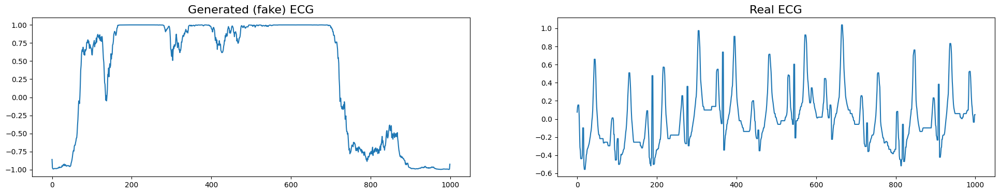

Epoch 1101/5000
Generator loss: 0.8960243463516235
Discriminator loss: 28341200.0
-------------------
Epoch 1102/5000
Generator loss: 0.8999894857406616
Discriminator loss: 28709816.0
-------------------
Epoch 1103/5000
Generator loss: 0.9386705160140991
Discriminator loss: 29661836.0
-------------------
Epoch 1104/5000
Generator loss: 0.9324686527252197
Discriminator loss: 29243074.0
-------------------
Epoch 1105/5000
Generator loss: 0.9507851600646973
Discriminator loss: 30778424.0
-------------------
Epoch 1106/5000
Generator loss: 0.8999669551849365
Discriminator loss: 29549938.0
-------------------
Epoch 1107/5000
Generator loss: 0.8835963010787964
Discriminator loss: 29826746.0
-------------------
Epoch 1108/5000
Generator loss: 0.9078434705734253
Discriminator loss: 28565318.0
-------------------
Epoch 1109/5000
Generator loss: 0.9272066950798035
Discriminator loss: 29828186.0
-------------------
Epoch 1110/5000
Generator loss: 0.9444257020950317
Discriminator loss: 30344870.0


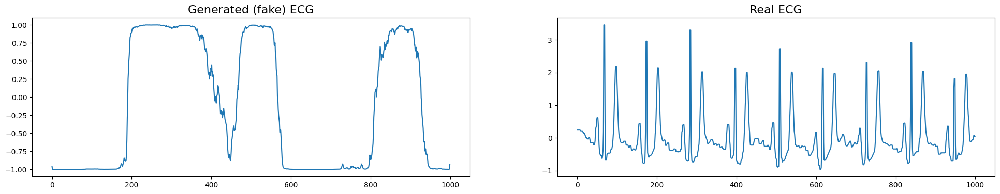

Epoch 1151/5000
Generator loss: 0.8910089731216431
Discriminator loss: 29836874.0
-------------------
Epoch 1152/5000
Generator loss: 0.9239280223846436
Discriminator loss: 29285120.0
-------------------
Epoch 1153/5000
Generator loss: 0.9136788845062256
Discriminator loss: 29598110.0
-------------------
Epoch 1154/5000
Generator loss: 0.9165351390838623
Discriminator loss: 28664098.0
-------------------
Epoch 1155/5000
Generator loss: 0.9212199449539185
Discriminator loss: 30276824.0
-------------------
Epoch 1156/5000
Generator loss: 0.9623289108276367
Discriminator loss: 29054774.0
-------------------
Epoch 1157/5000
Generator loss: 0.9310472011566162
Discriminator loss: 28576304.0
-------------------
Epoch 1158/5000
Generator loss: 0.9432843923568726
Discriminator loss: 29259894.0
-------------------
Epoch 1159/5000
Generator loss: 0.8869661092758179
Discriminator loss: 29279758.0
-------------------
Epoch 1160/5000
Generator loss: 0.8990780115127563
Discriminator loss: 30750530.0


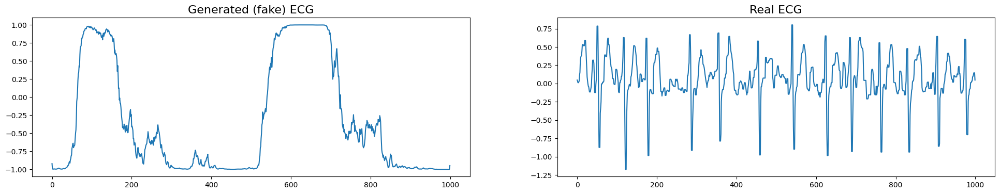

Epoch 1201/5000
Generator loss: 0.9073765873908997
Discriminator loss: 28115130.0
-------------------
Epoch 1202/5000
Generator loss: 0.9597506523132324
Discriminator loss: 28320642.0
-------------------
Epoch 1203/5000
Generator loss: 0.9247075319290161
Discriminator loss: 28214814.0
-------------------
Epoch 1204/5000
Generator loss: 0.9322827458381653
Discriminator loss: 31365510.0
-------------------
Epoch 1205/5000
Generator loss: 0.9016273021697998
Discriminator loss: 28054748.0
-------------------
Epoch 1206/5000
Generator loss: 0.9385786652565002
Discriminator loss: 28251982.0
-------------------
Epoch 1207/5000
Generator loss: 0.9257214069366455
Discriminator loss: 28931102.0
-------------------
Epoch 1208/5000
Generator loss: 0.9050530195236206
Discriminator loss: 29203160.0
-------------------
Epoch 1209/5000
Generator loss: 0.9202443361282349
Discriminator loss: 30747416.0
-------------------
Epoch 1210/5000
Generator loss: 0.9485325217247009
Discriminator loss: 29680628.0


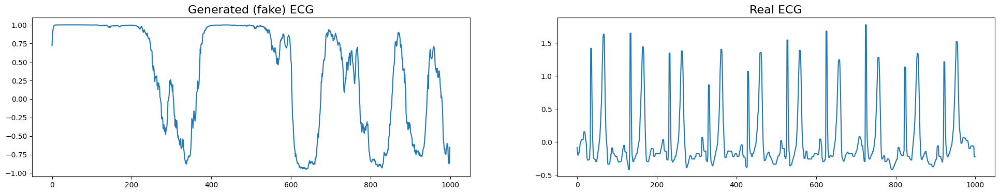

Epoch 1251/5000
Generator loss: 0.9031400084495544
Discriminator loss: 28935326.0
-------------------
Epoch 1252/5000
Generator loss: 0.953249990940094
Discriminator loss: 28531622.0
-------------------
Epoch 1253/5000
Generator loss: 0.9246407747268677
Discriminator loss: 27792044.0
-------------------
Epoch 1254/5000
Generator loss: 0.8891687393188477
Discriminator loss: 28540466.0
-------------------
Epoch 1255/5000
Generator loss: 0.9119817614555359
Discriminator loss: 29469728.0
-------------------
Epoch 1256/5000
Generator loss: 0.9162991046905518
Discriminator loss: 29518790.0
-------------------
Epoch 1257/5000
Generator loss: 0.9238412380218506
Discriminator loss: 29734330.0
-------------------
Epoch 1258/5000
Generator loss: 0.8895988464355469
Discriminator loss: 26809226.0
-------------------
Epoch 1259/5000
Generator loss: 0.9081593751907349
Discriminator loss: 29465048.0
-------------------
Epoch 1260/5000
Generator loss: 0.9157800078392029
Discriminator loss: 30212048.0
-

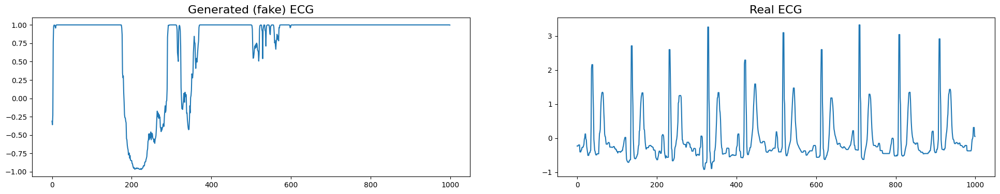

Epoch 1301/5000
Generator loss: 0.93161940574646
Discriminator loss: 29830364.0
-------------------
Epoch 1302/5000
Generator loss: 0.9401170015335083
Discriminator loss: 28724502.0
-------------------
Epoch 1303/5000
Generator loss: 0.9262022376060486
Discriminator loss: 30087662.0
-------------------
Epoch 1304/5000
Generator loss: 0.926563024520874
Discriminator loss: 29207444.0
-------------------
Epoch 1305/5000
Generator loss: 0.8985869884490967
Discriminator loss: 29926040.0
-------------------
Epoch 1306/5000
Generator loss: 0.9230586290359497
Discriminator loss: 29246012.0
-------------------
Epoch 1307/5000
Generator loss: 0.929848313331604
Discriminator loss: 28054470.0
-------------------
Epoch 1308/5000
Generator loss: 0.8874505162239075
Discriminator loss: 29007738.0
-------------------
Epoch 1309/5000
Generator loss: 0.9133692979812622
Discriminator loss: 29064830.0
-------------------
Epoch 1310/5000
Generator loss: 0.8881760835647583
Discriminator loss: 28097570.0
----

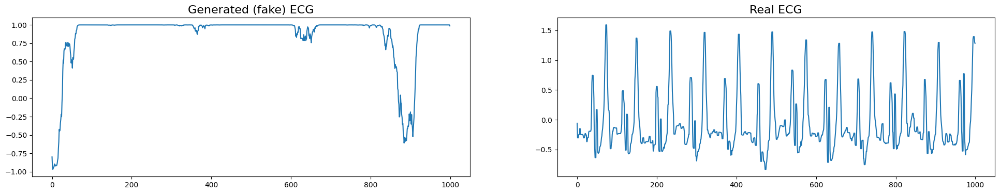

Epoch 1351/5000
Generator loss: 0.9359393119812012
Discriminator loss: 28774610.0
-------------------
Epoch 1352/5000
Generator loss: 0.9115020036697388
Discriminator loss: 29220548.0
-------------------
Epoch 1353/5000
Generator loss: 0.890080988407135
Discriminator loss: 29116556.0
-------------------
Epoch 1354/5000
Generator loss: 0.9238424301147461
Discriminator loss: 30163850.0
-------------------
Epoch 1355/5000
Generator loss: 0.9037595987319946
Discriminator loss: 28913024.0
-------------------
Epoch 1356/5000
Generator loss: 0.9248948097229004
Discriminator loss: 29932052.0
-------------------
Epoch 1357/5000
Generator loss: 0.9126991033554077
Discriminator loss: 29325354.0
-------------------
Epoch 1358/5000
Generator loss: 0.9235330820083618
Discriminator loss: 29878010.0
-------------------
Epoch 1359/5000
Generator loss: 0.8998390436172485
Discriminator loss: 29632190.0
-------------------
Epoch 1360/5000
Generator loss: 0.9221310615539551
Discriminator loss: 27858212.0
-

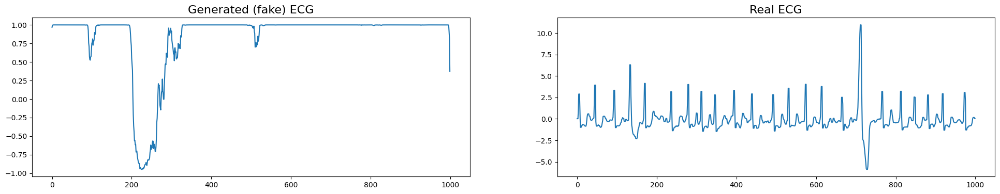

Epoch 1401/5000
Generator loss: 0.9218447208404541
Discriminator loss: 29950982.0
-------------------
Epoch 1402/5000
Generator loss: 0.9293307065963745
Discriminator loss: 28420532.0
-------------------
Epoch 1403/5000
Generator loss: 0.9084924459457397
Discriminator loss: 27376004.0
-------------------
Epoch 1404/5000
Generator loss: 0.8905247449874878
Discriminator loss: 28636424.0
-------------------
Epoch 1405/5000
Generator loss: 0.9138649702072144
Discriminator loss: 28858820.0
-------------------
Epoch 1406/5000
Generator loss: 0.9124962091445923
Discriminator loss: 29487494.0
-------------------
Epoch 1407/5000
Generator loss: 0.911367654800415
Discriminator loss: 29433074.0
-------------------
Epoch 1408/5000
Generator loss: 0.9396932125091553
Discriminator loss: 28956992.0
-------------------
Epoch 1409/5000
Generator loss: 0.8900866508483887
Discriminator loss: 29395694.0
-------------------
Epoch 1410/5000
Generator loss: 0.921189546585083
Discriminator loss: 30349966.0
--

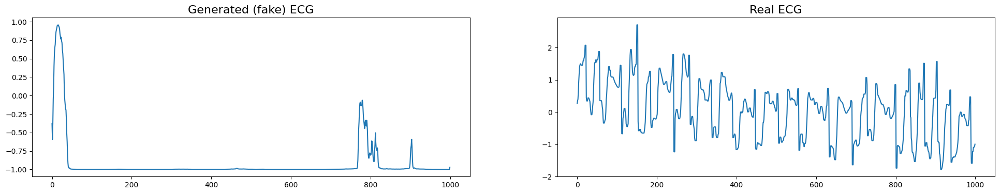

Epoch 1451/5000
Generator loss: 0.8894146084785461
Discriminator loss: 29628290.0
-------------------
Epoch 1452/5000
Generator loss: 0.9136893153190613
Discriminator loss: 28517246.0
-------------------
Epoch 1453/5000
Generator loss: 0.9263628721237183
Discriminator loss: 28724960.0
-------------------
Epoch 1454/5000
Generator loss: 0.9277967214584351
Discriminator loss: 27861206.0
-------------------
Epoch 1455/5000
Generator loss: 0.9377800226211548
Discriminator loss: 29514878.0
-------------------
Epoch 1456/5000
Generator loss: 1.000651240348816
Discriminator loss: 28366016.0
-------------------
Epoch 1457/5000
Generator loss: 0.8927727937698364
Discriminator loss: 28880672.0
-------------------
Epoch 1458/5000
Generator loss: 0.8748241066932678
Discriminator loss: 28121660.0
-------------------
Epoch 1459/5000
Generator loss: 0.9117287397384644
Discriminator loss: 29617934.0
-------------------
Epoch 1460/5000
Generator loss: 0.9722995758056641
Discriminator loss: 27537274.0
-

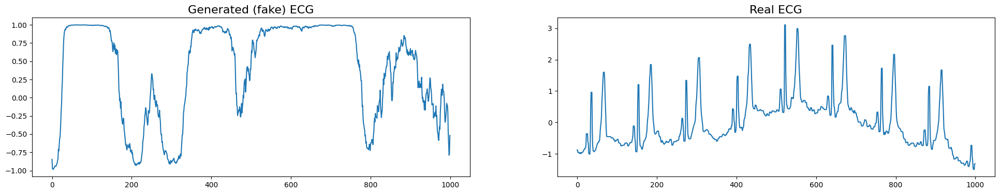

Epoch 1501/5000
Generator loss: 0.8865171670913696
Discriminator loss: 28006726.0
-------------------
Epoch 1502/5000
Generator loss: 0.9211887121200562
Discriminator loss: 30001958.0
-------------------
Epoch 1503/5000
Generator loss: 0.9075033664703369
Discriminator loss: 28786730.0
-------------------
Epoch 1504/5000
Generator loss: 0.9212367534637451
Discriminator loss: 28983886.0
-------------------
Epoch 1505/5000
Generator loss: 0.9582026600837708
Discriminator loss: 29670956.0
-------------------
Epoch 1506/5000
Generator loss: 0.9262932538986206
Discriminator loss: 28452752.0
-------------------
Epoch 1507/5000
Generator loss: 0.9416612386703491
Discriminator loss: 29870734.0
-------------------
Epoch 1508/5000
Generator loss: 0.9510918855667114
Discriminator loss: 30276500.0
-------------------
Epoch 1509/5000
Generator loss: 0.8966087102890015
Discriminator loss: 28152452.0
-------------------
Epoch 1510/5000
Generator loss: 0.9168339967727661
Discriminator loss: 30419210.0


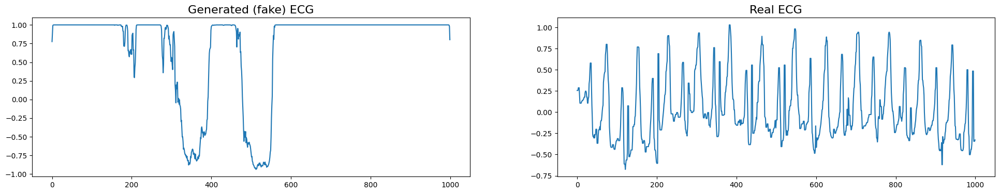

Epoch 1551/5000
Generator loss: 0.9010802507400513
Discriminator loss: 30726620.0
-------------------
Epoch 1552/5000
Generator loss: 0.9183928966522217
Discriminator loss: 28180274.0
-------------------
Epoch 1553/5000
Generator loss: 0.9268213510513306
Discriminator loss: 29728172.0
-------------------
Epoch 1554/5000
Generator loss: 0.9172407388687134
Discriminator loss: 28679778.0
-------------------
Epoch 1555/5000
Generator loss: 0.9255734086036682
Discriminator loss: 30397316.0
-------------------
Epoch 1556/5000
Generator loss: 0.9479411840438843
Discriminator loss: 28709726.0
-------------------
Epoch 1557/5000
Generator loss: 0.9349757432937622
Discriminator loss: 32325038.0
-------------------
Epoch 1558/5000
Generator loss: 0.9552165269851685
Discriminator loss: 29336360.0
-------------------
Epoch 1559/5000
Generator loss: 0.9197916984558105
Discriminator loss: 29697178.0
-------------------
Epoch 1560/5000
Generator loss: 0.9164695739746094
Discriminator loss: 29795132.0


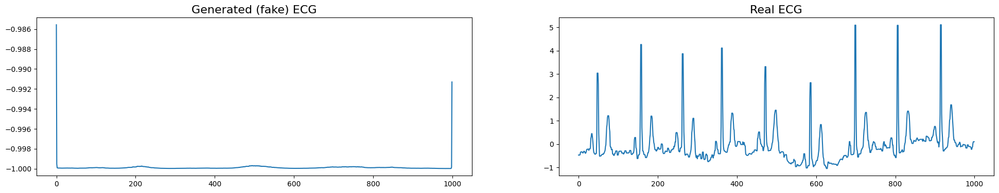

Epoch 1601/5000
Generator loss: 0.9186446666717529
Discriminator loss: 28825022.0
-------------------
Epoch 1602/5000
Generator loss: 0.9065765142440796
Discriminator loss: 30322658.0
-------------------
Epoch 1603/5000
Generator loss: 0.9113763570785522
Discriminator loss: 28077790.0
-------------------
Epoch 1604/5000
Generator loss: 0.9328857064247131
Discriminator loss: 30580976.0
-------------------
Epoch 1605/5000
Generator loss: 0.9279318451881409
Discriminator loss: 28190156.0
-------------------
Epoch 1606/5000
Generator loss: 0.9037909507751465
Discriminator loss: 28907754.0
-------------------
Epoch 1607/5000
Generator loss: 0.9358463287353516
Discriminator loss: 29294862.0
-------------------
Epoch 1608/5000
Generator loss: 0.9475337266921997
Discriminator loss: 28461212.0
-------------------
Epoch 1609/5000
Generator loss: 0.8916165828704834
Discriminator loss: 28418694.0
-------------------
Epoch 1610/5000
Generator loss: 0.9286659955978394
Discriminator loss: 28552544.0


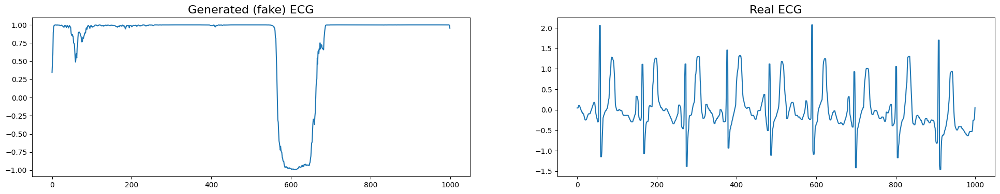

Epoch 1651/5000
Generator loss: 0.9111372232437134
Discriminator loss: 27985646.0
-------------------
Epoch 1652/5000
Generator loss: 0.9546545743942261
Discriminator loss: 29906678.0
-------------------
Epoch 1653/5000
Generator loss: 0.9456875324249268
Discriminator loss: 29607670.0
-------------------
Epoch 1654/5000
Generator loss: 0.9421343207359314
Discriminator loss: 29199752.0
-------------------
Epoch 1655/5000
Generator loss: 0.8910897374153137
Discriminator loss: 29767526.0
-------------------
Epoch 1656/5000
Generator loss: 0.9017642140388489
Discriminator loss: 28527992.0
-------------------
Epoch 1657/5000
Generator loss: 0.9235886335372925
Discriminator loss: 27661418.0
-------------------
Epoch 1658/5000
Generator loss: 0.9493132829666138
Discriminator loss: 28192628.0
-------------------
Epoch 1659/5000
Generator loss: 0.9049820899963379
Discriminator loss: 30535292.0
-------------------
Epoch 1660/5000
Generator loss: 0.8930431604385376
Discriminator loss: 27889370.0


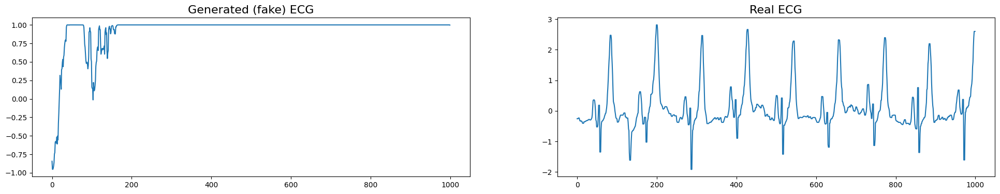

Epoch 1701/5000
Generator loss: 0.9071743488311768
Discriminator loss: 26911142.0
-------------------
Epoch 1702/5000
Generator loss: 0.9148250222206116
Discriminator loss: 29559146.0
-------------------
Epoch 1703/5000
Generator loss: 0.9263525605201721
Discriminator loss: 29953028.0
-------------------
Epoch 1704/5000
Generator loss: 0.9081785678863525
Discriminator loss: 27964466.0
-------------------
Epoch 1705/5000
Generator loss: 0.8996685147285461
Discriminator loss: 31277264.0
-------------------
Epoch 1706/5000
Generator loss: 0.954535186290741
Discriminator loss: 29520926.0
-------------------
Epoch 1707/5000
Generator loss: 0.9086841344833374
Discriminator loss: 31914294.0
-------------------
Epoch 1708/5000
Generator loss: 0.924590528011322
Discriminator loss: 29603566.0
-------------------
Epoch 1709/5000
Generator loss: 0.9380039572715759
Discriminator loss: 30489682.0
-------------------
Epoch 1710/5000
Generator loss: 0.9096539616584778
Discriminator loss: 30205578.0
--

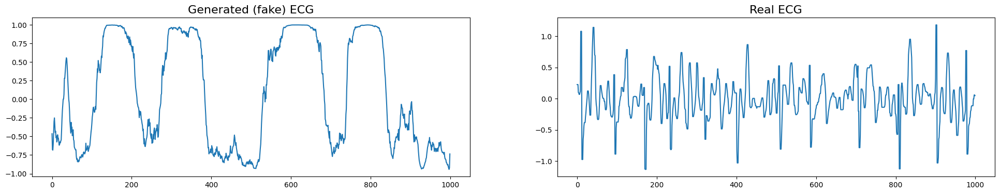

Epoch 1751/5000
Generator loss: 0.9330448508262634
Discriminator loss: 28654664.0
-------------------
Epoch 1752/5000
Generator loss: 0.9436779618263245
Discriminator loss: 28328366.0
-------------------
Epoch 1753/5000
Generator loss: 0.948784589767456
Discriminator loss: 29008410.0
-------------------
Epoch 1754/5000
Generator loss: 0.9112240076065063
Discriminator loss: 28695446.0
-------------------
Epoch 1755/5000
Generator loss: 0.916734516620636
Discriminator loss: 30782046.0
-------------------
Epoch 1756/5000
Generator loss: 0.9735457897186279
Discriminator loss: 28578596.0
-------------------
Epoch 1757/5000
Generator loss: 0.9285213947296143
Discriminator loss: 28621142.0
-------------------
Epoch 1758/5000
Generator loss: 0.9390995502471924
Discriminator loss: 30203180.0
-------------------
Epoch 1759/5000
Generator loss: 0.9310740828514099
Discriminator loss: 29038796.0
-------------------
Epoch 1760/5000
Generator loss: 1.0087666511535645
Discriminator loss: 29314592.0
--

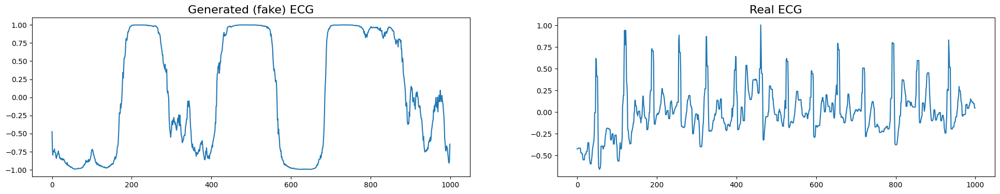

Epoch 1801/5000
Generator loss: 0.8935486078262329
Discriminator loss: 28452510.0
-------------------
Epoch 1802/5000
Generator loss: 0.9098809957504272
Discriminator loss: 29303048.0
-------------------
Epoch 1803/5000
Generator loss: 0.9539703726768494
Discriminator loss: 28752554.0
-------------------
Epoch 1804/5000
Generator loss: 0.9691824913024902
Discriminator loss: 29859218.0
-------------------
Epoch 1805/5000
Generator loss: 0.8953140377998352
Discriminator loss: 31520354.0
-------------------
Epoch 1806/5000
Generator loss: 0.9500574469566345
Discriminator loss: 28625370.0
-------------------
Epoch 1807/5000
Generator loss: 0.9235662817955017
Discriminator loss: 27614102.0
-------------------
Epoch 1808/5000
Generator loss: 0.9146214723587036
Discriminator loss: 28194434.0
-------------------
Epoch 1809/5000
Generator loss: 0.9187507629394531
Discriminator loss: 30319014.0
-------------------
Epoch 1810/5000
Generator loss: 0.8921152949333191
Discriminator loss: 28689980.0


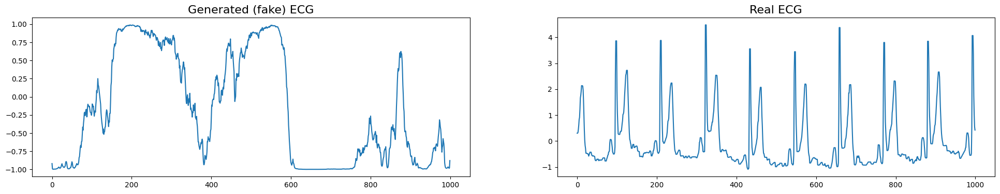

Epoch 1851/5000
Generator loss: 0.9121712446212769
Discriminator loss: 27806690.0
-------------------
Epoch 1852/5000
Generator loss: 0.8940180540084839
Discriminator loss: 29182742.0
-------------------
Epoch 1853/5000
Generator loss: 0.8846396207809448
Discriminator loss: 28057934.0
-------------------
Epoch 1854/5000
Generator loss: 0.8808904886245728
Discriminator loss: 28887128.0
-------------------
Epoch 1855/5000
Generator loss: 0.9092498421669006
Discriminator loss: 28903220.0
-------------------
Epoch 1856/5000
Generator loss: 0.942038893699646
Discriminator loss: 28552358.0
-------------------
Epoch 1857/5000
Generator loss: 0.9859423637390137
Discriminator loss: 30715982.0
-------------------
Epoch 1858/5000
Generator loss: 0.9441525936126709
Discriminator loss: 28956082.0
-------------------
Epoch 1859/5000
Generator loss: 0.919327974319458
Discriminator loss: 28933376.0
-------------------
Epoch 1860/5000
Generator loss: 0.9233247637748718
Discriminator loss: 27836198.0
--

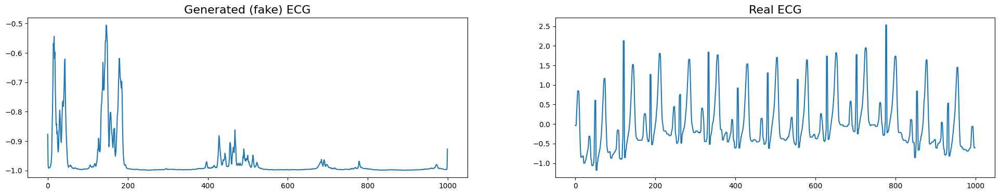

Epoch 1901/5000
Generator loss: 0.9259755611419678
Discriminator loss: 29747314.0
-------------------
Epoch 1902/5000
Generator loss: 0.9377626180648804
Discriminator loss: 28439242.0
-------------------
Epoch 1903/5000
Generator loss: 0.8816089034080505
Discriminator loss: 31436666.0
-------------------
Epoch 1904/5000
Generator loss: 0.9340253472328186
Discriminator loss: 29624072.0
-------------------
Epoch 1905/5000
Generator loss: 0.9388927221298218
Discriminator loss: 29625296.0
-------------------
Epoch 1906/5000
Generator loss: 0.9130446314811707
Discriminator loss: 26822768.0
-------------------
Epoch 1907/5000
Generator loss: 0.8838399052619934
Discriminator loss: 28019778.0
-------------------
Epoch 1908/5000
Generator loss: 0.900968074798584
Discriminator loss: 26606286.0
-------------------
Epoch 1909/5000
Generator loss: 0.9087444543838501
Discriminator loss: 29015396.0
-------------------
Epoch 1910/5000
Generator loss: 0.9410719871520996
Discriminator loss: 29042018.0
-

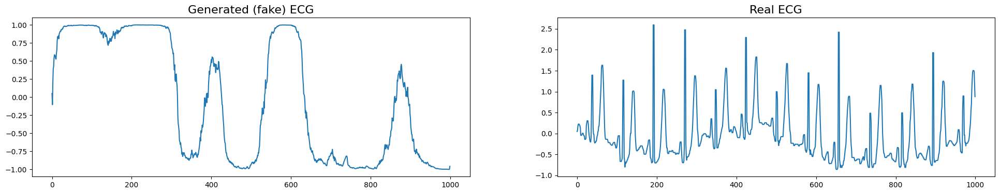

Epoch 1951/5000
Generator loss: 0.9057313203811646
Discriminator loss: 28924538.0
-------------------
Epoch 1952/5000
Generator loss: 0.9341543316841125
Discriminator loss: 29148570.0
-------------------
Epoch 1953/5000
Generator loss: 0.9271384477615356
Discriminator loss: 29516622.0
-------------------
Epoch 1954/5000
Generator loss: 0.8842200040817261
Discriminator loss: 27755960.0
-------------------
Epoch 1955/5000
Generator loss: 0.9730127453804016
Discriminator loss: 29813286.0
-------------------
Epoch 1956/5000
Generator loss: 0.9514302611351013
Discriminator loss: 29538560.0
-------------------
Epoch 1957/5000
Generator loss: 0.8821640014648438
Discriminator loss: 28181564.0
-------------------
Epoch 1958/5000
Generator loss: 0.9810926914215088
Discriminator loss: 28477952.0
-------------------
Epoch 1959/5000
Generator loss: 0.9033925533294678
Discriminator loss: 29263520.0
-------------------
Epoch 1960/5000
Generator loss: 0.9417417049407959
Discriminator loss: 29730596.0


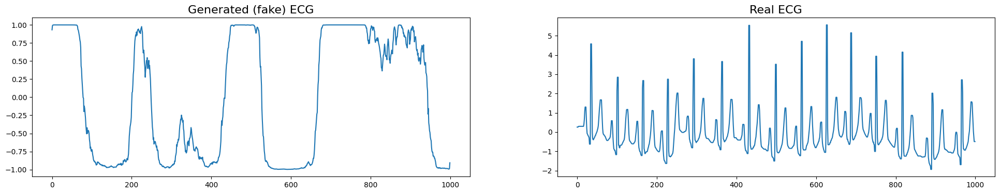

Epoch 2001/5000
Generator loss: 0.8914411067962646
Discriminator loss: 28989980.0
-------------------
Epoch 2002/5000
Generator loss: 0.9114627838134766
Discriminator loss: 29511050.0
-------------------
Epoch 2003/5000
Generator loss: 0.9187037944793701
Discriminator loss: 28954454.0
-------------------
Epoch 2004/5000
Generator loss: 0.8938143849372864
Discriminator loss: 28939990.0
-------------------
Epoch 2005/5000
Generator loss: 0.9368529319763184
Discriminator loss: 29257952.0
-------------------
Epoch 2006/5000
Generator loss: 0.903884768486023
Discriminator loss: 29099804.0
-------------------
Epoch 2007/5000
Generator loss: 0.9524576663970947
Discriminator loss: 29383910.0
-------------------
Epoch 2008/5000
Generator loss: 0.888468861579895
Discriminator loss: 27476180.0
-------------------
Epoch 2009/5000
Generator loss: 0.9164286851882935
Discriminator loss: 27882776.0
-------------------
Epoch 2010/5000
Generator loss: 0.9279584884643555
Discriminator loss: 28153438.0
--

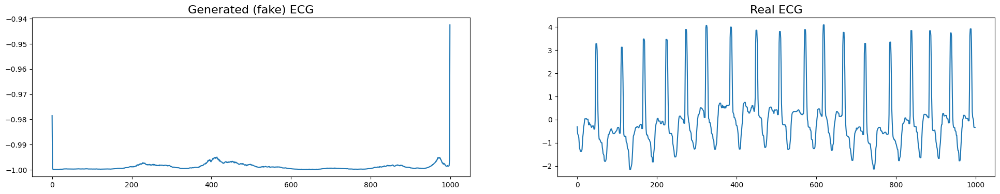

Epoch 2051/5000
Generator loss: 0.904462456703186
Discriminator loss: 29270746.0
-------------------
Epoch 2052/5000
Generator loss: 0.9077272415161133
Discriminator loss: 28150694.0
-------------------
Epoch 2053/5000
Generator loss: 0.9447920322418213
Discriminator loss: 28929392.0
-------------------
Epoch 2054/5000
Generator loss: 0.9243110418319702
Discriminator loss: 28330148.0
-------------------
Epoch 2055/5000
Generator loss: 0.9229750633239746
Discriminator loss: 28928810.0
-------------------
Epoch 2056/5000
Generator loss: 0.9244436025619507
Discriminator loss: 30247022.0
-------------------
Epoch 2057/5000
Generator loss: 0.90360426902771
Discriminator loss: 27769386.0
-------------------
Epoch 2058/5000
Generator loss: 0.9035845994949341
Discriminator loss: 30448294.0
-------------------
Epoch 2059/5000
Generator loss: 0.9521836042404175
Discriminator loss: 29151896.0
-------------------
Epoch 2060/5000
Generator loss: 0.9202727675437927
Discriminator loss: 28982300.0
---

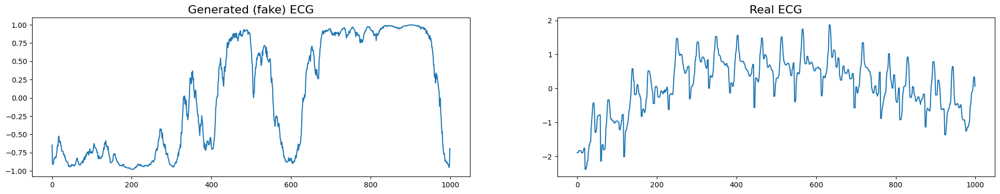

Epoch 2101/5000
Generator loss: 0.899643063545227
Discriminator loss: 29303108.0
-------------------
Epoch 2102/5000
Generator loss: 0.9421753883361816
Discriminator loss: 31335734.0
-------------------
Epoch 2103/5000
Generator loss: 0.9103718996047974
Discriminator loss: 29792624.0
-------------------
Epoch 2104/5000
Generator loss: 0.8970948457717896
Discriminator loss: 30810746.0
-------------------
Epoch 2105/5000
Generator loss: 0.9344128370285034
Discriminator loss: 29758414.0
-------------------
Epoch 2106/5000
Generator loss: 0.9159530401229858
Discriminator loss: 28963664.0
-------------------
Epoch 2107/5000
Generator loss: 0.9436144828796387
Discriminator loss: 28771112.0
-------------------
Epoch 2108/5000
Generator loss: 0.9298250675201416
Discriminator loss: 30063602.0
-------------------
Epoch 2109/5000
Generator loss: 0.9228949546813965
Discriminator loss: 27690346.0
-------------------
Epoch 2110/5000
Generator loss: 0.9111101627349854
Discriminator loss: 28377302.0
-

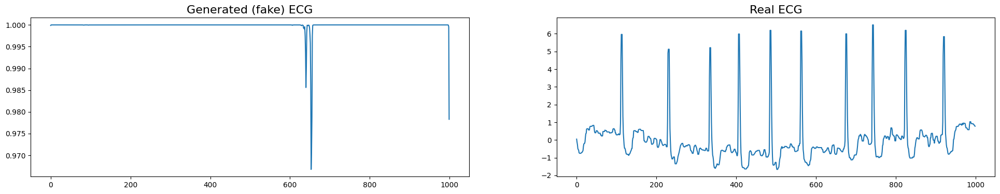

Epoch 2151/5000
Generator loss: 0.9134654998779297
Discriminator loss: 30637150.0
-------------------
Epoch 2152/5000
Generator loss: 0.9276100397109985
Discriminator loss: 30658454.0
-------------------
Epoch 2153/5000
Generator loss: 0.89850914478302
Discriminator loss: 28285814.0
-------------------
Epoch 2154/5000
Generator loss: 0.9089668989181519
Discriminator loss: 27763306.0
-------------------
Epoch 2155/5000
Generator loss: 0.8730243444442749
Discriminator loss: 27097424.0
-------------------
Epoch 2156/5000
Generator loss: 0.9149295091629028
Discriminator loss: 32162636.0
-------------------
Epoch 2157/5000
Generator loss: 0.895863950252533
Discriminator loss: 29329148.0
-------------------
Epoch 2158/5000
Generator loss: 0.9615282416343689
Discriminator loss: 31354844.0
-------------------
Epoch 2159/5000
Generator loss: 0.9010422229766846
Discriminator loss: 27869846.0
-------------------
Epoch 2160/5000
Generator loss: 0.9709893465042114
Discriminator loss: 29602966.0
---

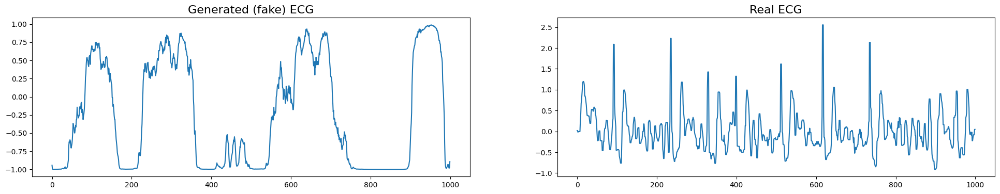

Epoch 2201/5000
Generator loss: 0.948312520980835
Discriminator loss: 30886904.0
-------------------
Epoch 2202/5000
Generator loss: 0.9132246971130371
Discriminator loss: 28028936.0
-------------------
Epoch 2203/5000
Generator loss: 0.8983445167541504
Discriminator loss: 28325780.0
-------------------
Epoch 2204/5000
Generator loss: 0.9898172616958618
Discriminator loss: 28362932.0
-------------------
Epoch 2205/5000
Generator loss: 0.8953758478164673
Discriminator loss: 27958502.0
-------------------
Epoch 2206/5000
Generator loss: 0.9404160976409912
Discriminator loss: 28402614.0
-------------------
Epoch 2207/5000
Generator loss: 0.9533569812774658
Discriminator loss: 29098350.0
-------------------
Epoch 2208/5000
Generator loss: 0.8988922834396362
Discriminator loss: 29697914.0
-------------------
Epoch 2209/5000
Generator loss: 0.9328138828277588
Discriminator loss: 30751982.0
-------------------
Epoch 2210/5000
Generator loss: 0.9037842750549316
Discriminator loss: 28101534.0
-

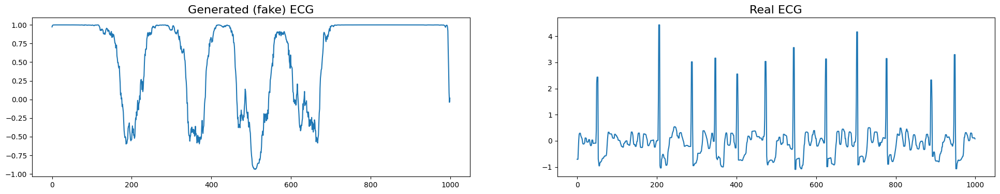

Epoch 2251/5000
Generator loss: 0.9230241775512695
Discriminator loss: 28697222.0
-------------------
Epoch 2252/5000
Generator loss: 0.9361622929573059
Discriminator loss: 28922590.0
-------------------
Epoch 2253/5000
Generator loss: 0.9481483697891235
Discriminator loss: 28341678.0
-------------------
Epoch 2254/5000
Generator loss: 0.9234654903411865
Discriminator loss: 29332978.0
-------------------
Epoch 2255/5000
Generator loss: 0.9206811189651489
Discriminator loss: 29244662.0
-------------------
Epoch 2256/5000
Generator loss: 0.8933377861976624
Discriminator loss: 27546578.0
-------------------
Epoch 2257/5000
Generator loss: 0.9196564555168152
Discriminator loss: 30140734.0
-------------------
Epoch 2258/5000
Generator loss: 0.9048309326171875
Discriminator loss: 28134586.0
-------------------
Epoch 2259/5000
Generator loss: 0.9024174213409424
Discriminator loss: 28866074.0
-------------------
Epoch 2260/5000
Generator loss: 0.881770670413971
Discriminator loss: 28813796.0
-

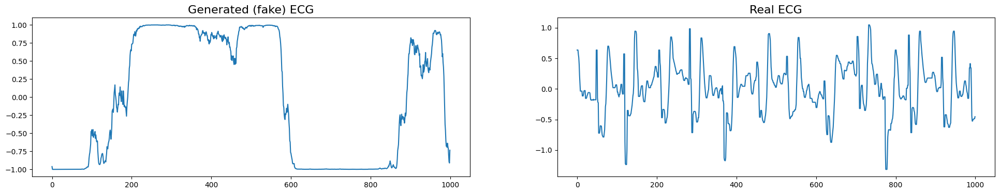

Epoch 2301/5000
Generator loss: 0.906995952129364
Discriminator loss: 29216696.0
-------------------
Epoch 2302/5000
Generator loss: 0.9006301164627075
Discriminator loss: 30380346.0
-------------------
Epoch 2303/5000
Generator loss: 0.9030773639678955
Discriminator loss: 30031268.0
-------------------
Epoch 2304/5000
Generator loss: 0.9174960851669312
Discriminator loss: 29396598.0
-------------------
Epoch 2305/5000
Generator loss: 0.8846433162689209
Discriminator loss: 27144290.0
-------------------
Epoch 2306/5000
Generator loss: 0.9273678660392761
Discriminator loss: 30280826.0
-------------------
Epoch 2307/5000
Generator loss: 0.9625502228736877
Discriminator loss: 28913420.0
-------------------
Epoch 2308/5000
Generator loss: 0.923136830329895
Discriminator loss: 28445434.0
-------------------
Epoch 2309/5000
Generator loss: 0.9099694490432739
Discriminator loss: 29199922.0
-------------------
Epoch 2310/5000
Generator loss: 0.9290915727615356
Discriminator loss: 28346804.0
--

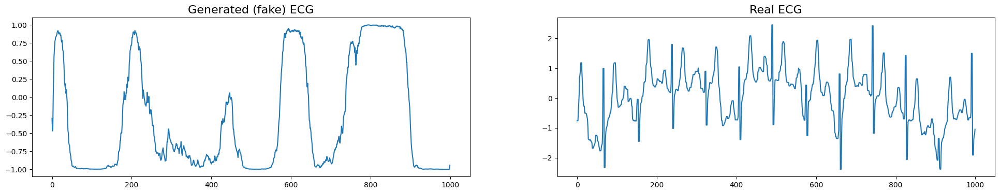

Epoch 2351/5000
Generator loss: 0.9197934865951538
Discriminator loss: 27897298.0
-------------------
Epoch 2352/5000
Generator loss: 0.9778554439544678
Discriminator loss: 29484118.0
-------------------
Epoch 2353/5000
Generator loss: 0.9183349609375
Discriminator loss: 27132200.0
-------------------
Epoch 2354/5000
Generator loss: 0.928633451461792
Discriminator loss: 29284520.0
-------------------
Epoch 2355/5000
Generator loss: 0.9619754552841187
Discriminator loss: 28849634.0
-------------------
Epoch 2356/5000
Generator loss: 0.9454754590988159
Discriminator loss: 29846490.0
-------------------
Epoch 2357/5000
Generator loss: 0.9479622840881348
Discriminator loss: 30387572.0
-------------------
Epoch 2358/5000
Generator loss: 0.9172858595848083
Discriminator loss: 27918044.0
-------------------
Epoch 2359/5000
Generator loss: 0.9071964025497437
Discriminator loss: 29209976.0
-------------------
Epoch 2360/5000
Generator loss: 0.9299932718276978
Discriminator loss: 29514320.0
----

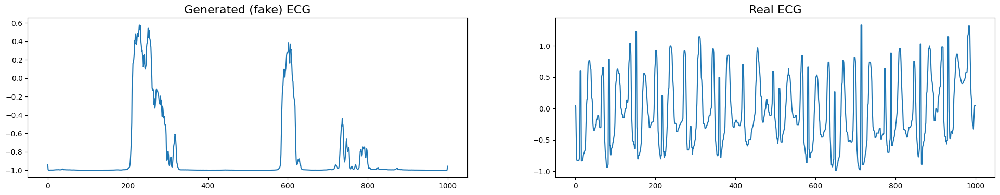

Epoch 2401/5000
Generator loss: 0.9279159307479858
Discriminator loss: 28946474.0
-------------------
Epoch 2402/5000
Generator loss: 0.9489394426345825
Discriminator loss: 29479016.0
-------------------
Epoch 2403/5000
Generator loss: 0.9155598878860474
Discriminator loss: 30095294.0
-------------------
Epoch 2404/5000
Generator loss: 0.9144836664199829
Discriminator loss: 28300946.0
-------------------
Epoch 2405/5000
Generator loss: 0.8991233110427856
Discriminator loss: 28317458.0
-------------------
Epoch 2406/5000
Generator loss: 0.9136006832122803
Discriminator loss: 27997242.0
-------------------
Epoch 2407/5000
Generator loss: 0.9371585845947266
Discriminator loss: 30648728.0
-------------------
Epoch 2408/5000
Generator loss: 0.938539445400238
Discriminator loss: 29622178.0
-------------------
Epoch 2409/5000
Generator loss: 0.9280425906181335
Discriminator loss: 30680402.0
-------------------
Epoch 2410/5000
Generator loss: 0.9147835969924927
Discriminator loss: 29808874.0
-

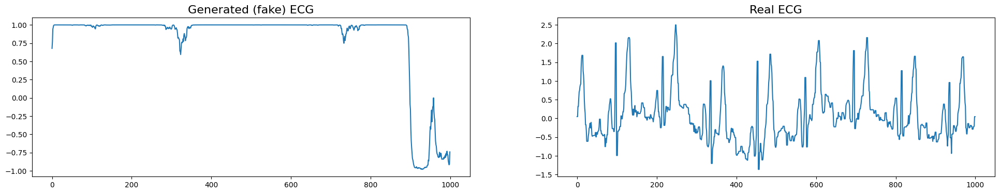

Epoch 2451/5000
Generator loss: 0.9095069169998169
Discriminator loss: 30001634.0
-------------------
Epoch 2452/5000
Generator loss: 0.9168391227722168
Discriminator loss: 29876276.0
-------------------
Epoch 2453/5000
Generator loss: 0.9033583402633667
Discriminator loss: 30192848.0
-------------------
Epoch 2454/5000
Generator loss: 0.9201955795288086
Discriminator loss: 30706136.0
-------------------
Epoch 2455/5000
Generator loss: 0.901408314704895
Discriminator loss: 29191122.0
-------------------
Epoch 2456/5000
Generator loss: 0.9071953296661377
Discriminator loss: 28811414.0
-------------------
Epoch 2457/5000
Generator loss: 0.9303051233291626
Discriminator loss: 28383668.0
-------------------
Epoch 2458/5000
Generator loss: 0.8885791897773743
Discriminator loss: 28436900.0
-------------------
Epoch 2459/5000
Generator loss: 0.9012214541435242
Discriminator loss: 28114916.0
-------------------
Epoch 2460/5000
Generator loss: 0.8799452185630798
Discriminator loss: 29709662.0
-

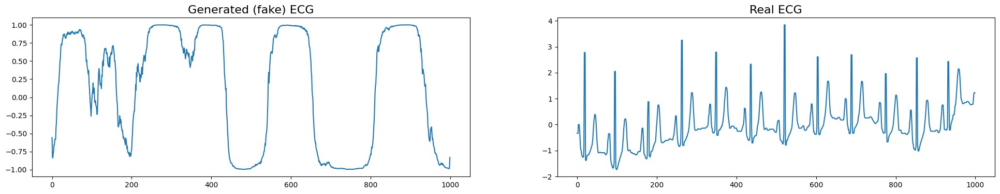

Epoch 2501/5000
Generator loss: 0.9122462272644043
Discriminator loss: 29558998.0
-------------------
Epoch 2502/5000
Generator loss: 0.9392831325531006
Discriminator loss: 28551824.0
-------------------
Epoch 2503/5000
Generator loss: 0.9238075613975525
Discriminator loss: 28768186.0
-------------------
Epoch 2504/5000
Generator loss: 0.9058068990707397
Discriminator loss: 30301266.0
-------------------
Epoch 2505/5000
Generator loss: 0.8870226144790649
Discriminator loss: 25312880.0
-------------------
Epoch 2506/5000
Generator loss: 0.9344325065612793
Discriminator loss: 28591862.0
-------------------
Epoch 2507/5000
Generator loss: 0.9103816747665405
Discriminator loss: 30332282.0
-------------------
Epoch 2508/5000
Generator loss: 0.926846981048584
Discriminator loss: 30339306.0
-------------------
Epoch 2509/5000
Generator loss: 0.9233416318893433
Discriminator loss: 29594822.0
-------------------
Epoch 2510/5000
Generator loss: 0.8945214748382568
Discriminator loss: 30458938.0
-

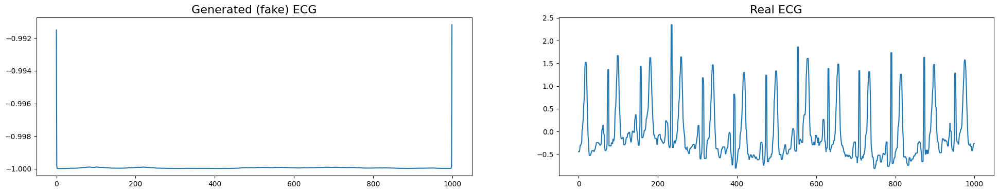

Epoch 2551/5000
Generator loss: 0.9481344223022461
Discriminator loss: 29013224.0
-------------------
Epoch 2552/5000
Generator loss: 0.9362867474555969
Discriminator loss: 29370224.0
-------------------
Epoch 2553/5000
Generator loss: 0.9025872945785522
Discriminator loss: 28527824.0
-------------------
Epoch 2554/5000
Generator loss: 0.8810277581214905
Discriminator loss: 28636026.0
-------------------
Epoch 2555/5000
Generator loss: 0.9311376810073853
Discriminator loss: 28780034.0
-------------------
Epoch 2556/5000
Generator loss: 0.9361239671707153
Discriminator loss: 27777638.0
-------------------
Epoch 2557/5000
Generator loss: 0.9456980228424072
Discriminator loss: 29213822.0
-------------------
Epoch 2558/5000
Generator loss: 0.904809296131134
Discriminator loss: 30436496.0
-------------------
Epoch 2559/5000
Generator loss: 0.9316744208335876
Discriminator loss: 30239986.0
-------------------
Epoch 2560/5000
Generator loss: 0.9082470536231995
Discriminator loss: 29931050.0
-

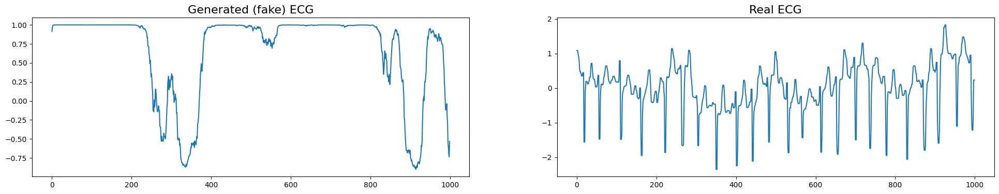

Epoch 2601/5000
Generator loss: 0.9114446640014648
Discriminator loss: 28013120.0
-------------------
Epoch 2602/5000
Generator loss: 0.9225353002548218
Discriminator loss: 29451284.0
-------------------
Epoch 2603/5000
Generator loss: 0.9187347292900085
Discriminator loss: 28162934.0
-------------------
Epoch 2604/5000
Generator loss: 0.9370659589767456
Discriminator loss: 29792582.0
-------------------
Epoch 2605/5000
Generator loss: 0.9059642553329468
Discriminator loss: 29430358.0
-------------------
Epoch 2606/5000
Generator loss: 0.9067652225494385
Discriminator loss: 28919154.0
-------------------
Epoch 2607/5000
Generator loss: 0.9135228991508484
Discriminator loss: 29053358.0
-------------------
Epoch 2608/5000
Generator loss: 0.9172720909118652
Discriminator loss: 30390950.0
-------------------
Epoch 2609/5000
Generator loss: 0.8900394439697266
Discriminator loss: 29305790.0
-------------------
Epoch 2610/5000
Generator loss: 0.9019519686698914
Discriminator loss: 30178946.0


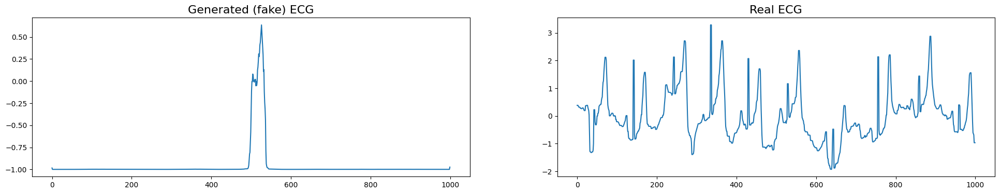

Epoch 2651/5000
Generator loss: 0.9056265354156494
Discriminator loss: 29283896.0
-------------------
Epoch 2652/5000
Generator loss: 0.8777099847793579
Discriminator loss: 28920332.0
-------------------
Epoch 2653/5000
Generator loss: 0.9150745868682861
Discriminator loss: 29162924.0
-------------------
Epoch 2654/5000
Generator loss: 0.9424581527709961
Discriminator loss: 27440858.0
-------------------
Epoch 2655/5000
Generator loss: 0.8933082818984985
Discriminator loss: 31130384.0
-------------------
Epoch 2656/5000
Generator loss: 0.9050686955451965
Discriminator loss: 28491906.0
-------------------
Epoch 2657/5000
Generator loss: 0.9368898868560791
Discriminator loss: 30205328.0
-------------------
Epoch 2658/5000
Generator loss: 0.9154660105705261
Discriminator loss: 28268342.0
-------------------
Epoch 2659/5000
Generator loss: 0.904393196105957
Discriminator loss: 30374564.0
-------------------
Epoch 2660/5000
Generator loss: 0.9181081056594849
Discriminator loss: 30215286.0
-

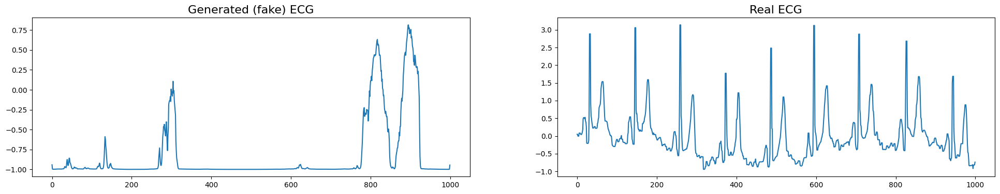

Epoch 2701/5000
Generator loss: 0.908358097076416
Discriminator loss: 28303976.0
-------------------
Epoch 2702/5000
Generator loss: 0.9358372092247009
Discriminator loss: 28489182.0
-------------------
Epoch 2703/5000
Generator loss: 0.8680728673934937
Discriminator loss: 27467930.0
-------------------
Epoch 2704/5000
Generator loss: 0.9047002792358398
Discriminator loss: 27945166.0
-------------------
Epoch 2705/5000
Generator loss: 0.9215524792671204
Discriminator loss: 31071074.0
-------------------
Epoch 2706/5000
Generator loss: 0.9179969429969788
Discriminator loss: 28517638.0
-------------------
Epoch 2707/5000
Generator loss: 0.9045802354812622
Discriminator loss: 30224948.0
-------------------
Epoch 2708/5000
Generator loss: 0.93795245885849
Discriminator loss: 29275118.0
-------------------
Epoch 2709/5000
Generator loss: 0.8812772035598755
Discriminator loss: 30015210.0
-------------------
Epoch 2710/5000
Generator loss: 0.9106932282447815
Discriminator loss: 29343746.0
---

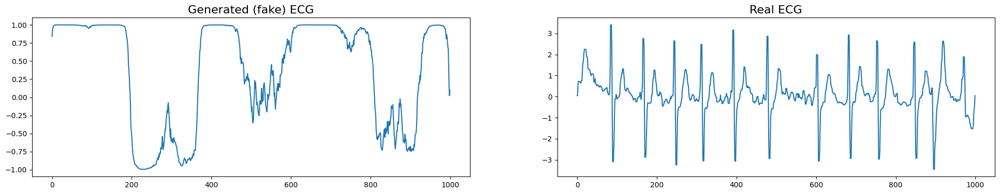

Epoch 2751/5000
Generator loss: 0.913131833076477
Discriminator loss: 28814414.0
-------------------
Epoch 2752/5000
Generator loss: 0.9416924118995667
Discriminator loss: 31122126.0
-------------------
Epoch 2753/5000
Generator loss: 0.925632894039154
Discriminator loss: 28590164.0
-------------------
Epoch 2754/5000
Generator loss: 0.9151419997215271
Discriminator loss: 29928802.0
-------------------
Epoch 2755/5000
Generator loss: 0.9056718945503235
Discriminator loss: 28289420.0
-------------------
Epoch 2756/5000
Generator loss: 0.9005980491638184
Discriminator loss: 28985420.0
-------------------
Epoch 2757/5000
Generator loss: 0.9285163283348083
Discriminator loss: 29415826.0
-------------------
Epoch 2758/5000
Generator loss: 0.9394350647926331
Discriminator loss: 29070282.0
-------------------
Epoch 2759/5000
Generator loss: 0.8981618285179138
Discriminator loss: 30282946.0
-------------------
Epoch 2760/5000
Generator loss: 0.9286502599716187
Discriminator loss: 28881362.0
--

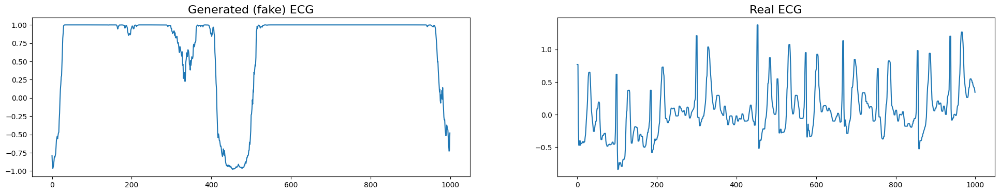

Epoch 2801/5000
Generator loss: 0.8982150554656982
Discriminator loss: 27709688.0
-------------------
Epoch 2802/5000
Generator loss: 0.9336216449737549
Discriminator loss: 30516854.0
-------------------
Epoch 2803/5000
Generator loss: 0.9264214634895325
Discriminator loss: 29145320.0
-------------------
Epoch 2804/5000
Generator loss: 0.9179891347885132
Discriminator loss: 30617522.0
-------------------
Epoch 2805/5000
Generator loss: 0.9324348568916321
Discriminator loss: 27453926.0
-------------------
Epoch 2806/5000
Generator loss: 0.9017406105995178
Discriminator loss: 28256732.0
-------------------
Epoch 2807/5000
Generator loss: 0.9086222052574158
Discriminator loss: 27545738.0
-------------------
Epoch 2808/5000
Generator loss: 0.9271204471588135
Discriminator loss: 29457226.0
-------------------
Epoch 2809/5000
Generator loss: 0.9193739295005798
Discriminator loss: 29062616.0
-------------------
Epoch 2810/5000
Generator loss: 0.920393705368042
Discriminator loss: 30103712.0
-

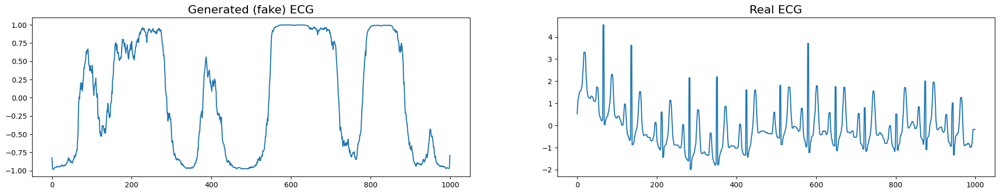

Epoch 2851/5000
Generator loss: 0.9180329442024231
Discriminator loss: 29616994.0
-------------------
Epoch 2852/5000
Generator loss: 0.8937726020812988
Discriminator loss: 28752134.0
-------------------
Epoch 2853/5000
Generator loss: 0.9148744344711304
Discriminator loss: 31319678.0
-------------------
Epoch 2854/5000
Generator loss: 0.9065383672714233
Discriminator loss: 29386892.0
-------------------
Epoch 2855/5000
Generator loss: 0.9277722835540771
Discriminator loss: 29117262.0
-------------------
Epoch 2856/5000
Generator loss: 0.9051661491394043
Discriminator loss: 29211680.0
-------------------
Epoch 2857/5000
Generator loss: 0.9083198308944702
Discriminator loss: 29532152.0
-------------------
Epoch 2858/5000
Generator loss: 0.9036624431610107
Discriminator loss: 30040638.0
-------------------
Epoch 2859/5000
Generator loss: 0.9607075452804565
Discriminator loss: 28956188.0
-------------------
Epoch 2860/5000
Generator loss: 0.8991629481315613
Discriminator loss: 29705720.0


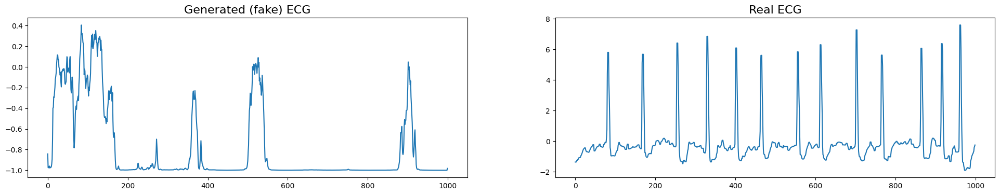

Epoch 2901/5000
Generator loss: 0.9617391228675842
Discriminator loss: 27932222.0
-------------------
Epoch 2902/5000
Generator loss: 0.8914511203765869
Discriminator loss: 29779868.0
-------------------
Epoch 2903/5000
Generator loss: 0.8994244337081909
Discriminator loss: 27171946.0
-------------------
Epoch 2904/5000
Generator loss: 0.9209566116333008
Discriminator loss: 29481308.0
-------------------
Epoch 2905/5000
Generator loss: 0.9156124591827393
Discriminator loss: 27753488.0
-------------------
Epoch 2906/5000
Generator loss: 0.9309569001197815
Discriminator loss: 28557860.0
-------------------
Epoch 2907/5000
Generator loss: 0.9253565073013306
Discriminator loss: 29077544.0
-------------------
Epoch 2908/5000
Generator loss: 0.9225634932518005
Discriminator loss: 29371214.0
-------------------
Epoch 2909/5000
Generator loss: 0.973835825920105
Discriminator loss: 29673830.0
-------------------
Epoch 2910/5000
Generator loss: 0.9245880842208862
Discriminator loss: 28391396.0
-

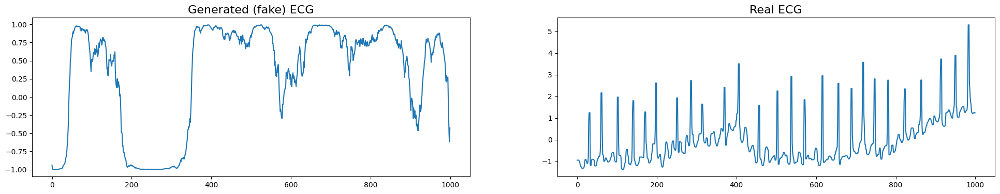

Epoch 2951/5000
Generator loss: 0.9111533164978027
Discriminator loss: 28040294.0
-------------------
Epoch 2952/5000
Generator loss: 0.9726204872131348
Discriminator loss: 28988648.0
-------------------
Epoch 2953/5000
Generator loss: 0.9134809374809265
Discriminator loss: 28964780.0
-------------------
Epoch 2954/5000
Generator loss: 0.9266458749771118
Discriminator loss: 29256992.0
-------------------
Epoch 2955/5000
Generator loss: 0.9160036444664001
Discriminator loss: 29808838.0
-------------------
Epoch 2956/5000
Generator loss: 0.9270933866500854
Discriminator loss: 30077438.0
-------------------
Epoch 2957/5000
Generator loss: 0.9234480857849121
Discriminator loss: 29286566.0
-------------------
Epoch 2958/5000
Generator loss: 0.9014574289321899
Discriminator loss: 27809330.0
-------------------
Epoch 2959/5000
Generator loss: 0.9280577898025513
Discriminator loss: 28341284.0
-------------------
Epoch 2960/5000
Generator loss: 0.8973489999771118
Discriminator loss: 29839122.0


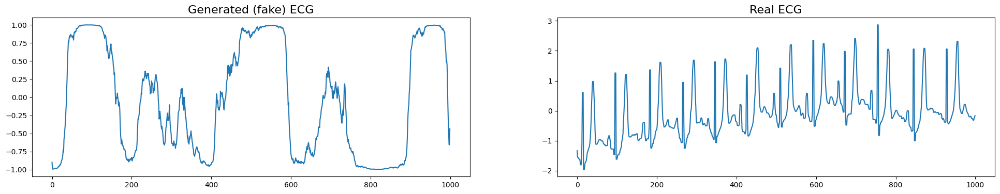

Epoch 3001/5000
Generator loss: 0.9213591814041138
Discriminator loss: 29905170.0
-------------------
Epoch 3002/5000
Generator loss: 0.9599430561065674
Discriminator loss: 30261618.0
-------------------
Epoch 3003/5000
Generator loss: 0.9230928421020508
Discriminator loss: 28154266.0
-------------------
Epoch 3004/5000
Generator loss: 0.9529879689216614
Discriminator loss: 27131144.0
-------------------
Epoch 3005/5000
Generator loss: 0.9091814756393433
Discriminator loss: 28996490.0
-------------------
Epoch 3006/5000
Generator loss: 0.8957324624061584
Discriminator loss: 29614326.0
-------------------
Epoch 3007/5000
Generator loss: 0.8907859921455383
Discriminator loss: 29431038.0
-------------------
Epoch 3008/5000
Generator loss: 0.9265199303627014
Discriminator loss: 29021786.0
-------------------
Epoch 3009/5000
Generator loss: 0.9318065643310547
Discriminator loss: 28875998.0
-------------------
Epoch 3010/5000
Generator loss: 0.941896915435791
Discriminator loss: 29853510.0
-

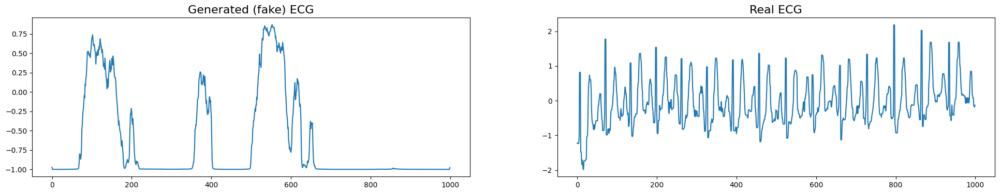

Epoch 3051/5000
Generator loss: 0.9446136951446533
Discriminator loss: 29220638.0
-------------------
Epoch 3052/5000
Generator loss: 0.9289275407791138
Discriminator loss: 28751434.0
-------------------
Epoch 3053/5000
Generator loss: 0.9116957187652588
Discriminator loss: 28584854.0
-------------------
Epoch 3054/5000
Generator loss: 0.9607847332954407
Discriminator loss: 30863718.0
-------------------
Epoch 3055/5000
Generator loss: 0.8992825150489807
Discriminator loss: 32184320.0
-------------------
Epoch 3056/5000
Generator loss: 0.920620322227478
Discriminator loss: 30310598.0
-------------------
Epoch 3057/5000
Generator loss: 0.920589029788971
Discriminator loss: 30332270.0
-------------------
Epoch 3058/5000
Generator loss: 0.9073607921600342
Discriminator loss: 29331434.0
-------------------
Epoch 3059/5000
Generator loss: 0.8993614912033081
Discriminator loss: 30691664.0
-------------------
Epoch 3060/5000
Generator loss: 0.9453157782554626
Discriminator loss: 29435420.0
--

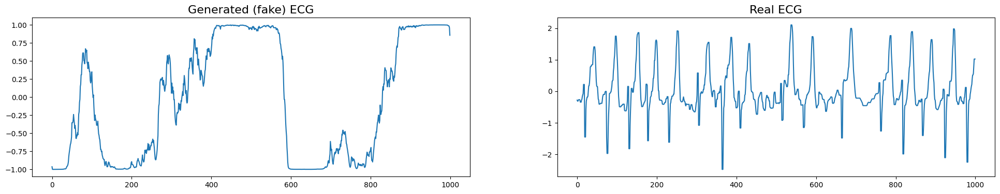

Epoch 3101/5000
Generator loss: 0.9160757064819336
Discriminator loss: 29223266.0
-------------------
Epoch 3102/5000
Generator loss: 0.9237980842590332
Discriminator loss: 30727546.0
-------------------
Epoch 3103/5000
Generator loss: 0.93403160572052
Discriminator loss: 27972926.0
-------------------
Epoch 3104/5000
Generator loss: 0.9122978448867798
Discriminator loss: 28040066.0
-------------------
Epoch 3105/5000
Generator loss: 0.9426265358924866
Discriminator loss: 28999832.0
-------------------
Epoch 3106/5000
Generator loss: 0.9149933457374573
Discriminator loss: 28356182.0
-------------------
Epoch 3107/5000
Generator loss: 0.9368232488632202
Discriminator loss: 29434546.0
-------------------
Epoch 3108/5000
Generator loss: 0.9305427074432373
Discriminator loss: 27705358.0
-------------------
Epoch 3109/5000
Generator loss: 0.9240871667861938
Discriminator loss: 29808596.0
-------------------
Epoch 3110/5000
Generator loss: 0.915164589881897
Discriminator loss: 29641220.0
---

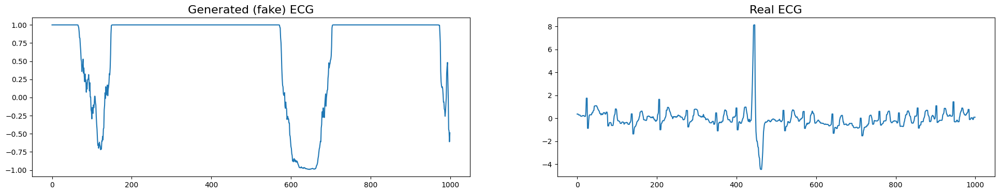

Epoch 3151/5000
Generator loss: 0.9192569255828857
Discriminator loss: 29057450.0
-------------------
Epoch 3152/5000
Generator loss: 0.8982101082801819
Discriminator loss: 28430474.0
-------------------
Epoch 3153/5000
Generator loss: 0.9074774980545044
Discriminator loss: 28797752.0
-------------------
Epoch 3154/5000
Generator loss: 0.9466304779052734
Discriminator loss: 28559942.0
-------------------
Epoch 3155/5000
Generator loss: 0.8961148858070374
Discriminator loss: 29580944.0
-------------------
Epoch 3156/5000
Generator loss: 0.9054766893386841
Discriminator loss: 28397894.0
-------------------
Epoch 3157/5000
Generator loss: 0.9300546646118164
Discriminator loss: 27169556.0
-------------------
Epoch 3158/5000
Generator loss: 0.9212440252304077
Discriminator loss: 28624964.0
-------------------
Epoch 3159/5000
Generator loss: 0.9724571704864502
Discriminator loss: 31464566.0
-------------------
Epoch 3160/5000
Generator loss: 0.9359754323959351
Discriminator loss: 30118094.0


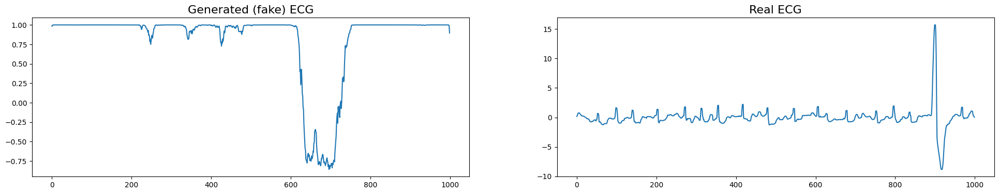

Epoch 3201/5000
Generator loss: 0.9194462299346924
Discriminator loss: 30423482.0
-------------------
Epoch 3202/5000
Generator loss: 0.911068320274353
Discriminator loss: 28759166.0
-------------------
Epoch 3203/5000
Generator loss: 0.925316572189331
Discriminator loss: 29274738.0
-------------------
Epoch 3204/5000
Generator loss: 0.9130818843841553
Discriminator loss: 28778792.0
-------------------
Epoch 3205/5000
Generator loss: 0.9011500477790833
Discriminator loss: 30578564.0
-------------------
Epoch 3206/5000
Generator loss: 0.9088694453239441
Discriminator loss: 29199596.0
-------------------
Epoch 3207/5000
Generator loss: 0.8918061256408691
Discriminator loss: 29660372.0
-------------------
Epoch 3208/5000
Generator loss: 0.9375219345092773
Discriminator loss: 28208312.0
-------------------
Epoch 3209/5000
Generator loss: 0.9278552532196045
Discriminator loss: 29358116.0
-------------------
Epoch 3210/5000
Generator loss: 0.9000900983810425
Discriminator loss: 27898062.0
--

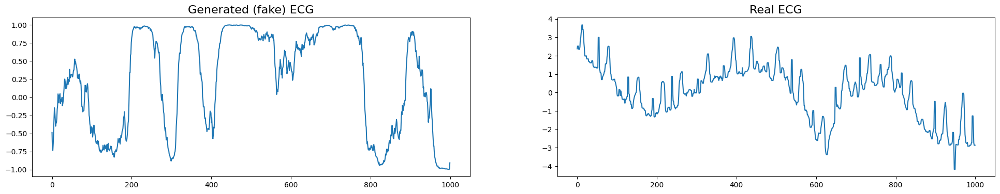

Epoch 3251/5000
Generator loss: 0.9420082569122314
Discriminator loss: 27508412.0
-------------------
Epoch 3252/5000
Generator loss: 0.9285473823547363
Discriminator loss: 32269250.0
-------------------
Epoch 3253/5000
Generator loss: 0.9025455713272095
Discriminator loss: 29863304.0
-------------------
Epoch 3254/5000
Generator loss: 0.9394853711128235
Discriminator loss: 29448458.0
-------------------
Epoch 3255/5000
Generator loss: 0.9393506050109863
Discriminator loss: 28399606.0
-------------------
Epoch 3256/5000
Generator loss: 0.9133754968643188
Discriminator loss: 29536918.0
-------------------
Epoch 3257/5000
Generator loss: 0.8955186605453491
Discriminator loss: 26591756.0
-------------------
Epoch 3258/5000
Generator loss: 0.9243286848068237
Discriminator loss: 29090522.0
-------------------
Epoch 3259/5000
Generator loss: 0.9445914030075073
Discriminator loss: 29083748.0
-------------------
Epoch 3260/5000
Generator loss: 0.9159034490585327
Discriminator loss: 26913222.0


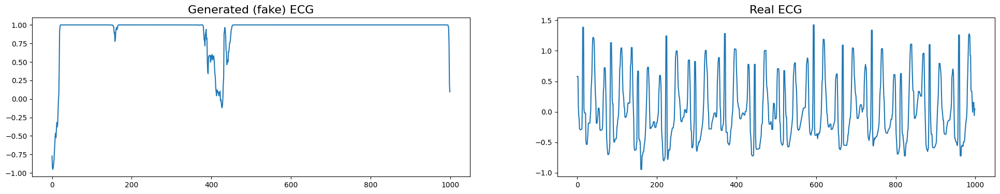

Epoch 3301/5000
Generator loss: 0.9411629438400269
Discriminator loss: 28915134.0
-------------------
Epoch 3302/5000
Generator loss: 0.9057742953300476
Discriminator loss: 28598762.0
-------------------
Epoch 3303/5000
Generator loss: 0.8986983299255371
Discriminator loss: 29743682.0
-------------------
Epoch 3304/5000
Generator loss: 0.9321786165237427
Discriminator loss: 29336650.0
-------------------
Epoch 3305/5000
Generator loss: 0.9069413542747498
Discriminator loss: 27087998.0
-------------------
Epoch 3306/5000
Generator loss: 0.9096698760986328
Discriminator loss: 29913302.0
-------------------
Epoch 3307/5000
Generator loss: 0.9031990170478821
Discriminator loss: 29064692.0
-------------------
Epoch 3308/5000
Generator loss: 0.9048495292663574
Discriminator loss: 29749786.0
-------------------
Epoch 3309/5000
Generator loss: 0.9406955242156982
Discriminator loss: 28805070.0
-------------------
Epoch 3310/5000
Generator loss: 0.9159472584724426
Discriminator loss: 31080500.0


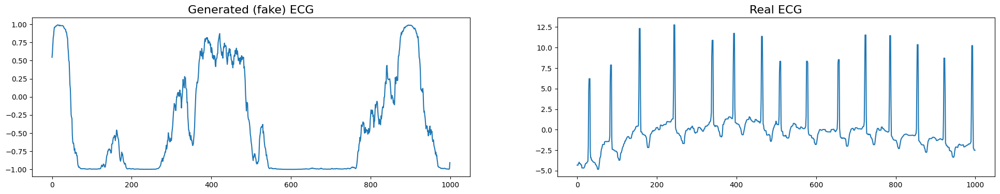

Epoch 3351/5000
Generator loss: 0.9315059185028076
Discriminator loss: 30175112.0
-------------------
Epoch 3352/5000
Generator loss: 0.9965639710426331
Discriminator loss: 29894624.0
-------------------
Epoch 3353/5000
Generator loss: 0.9084923267364502
Discriminator loss: 27962300.0
-------------------
Epoch 3354/5000
Generator loss: 0.9423479437828064
Discriminator loss: 28727234.0
-------------------
Epoch 3355/5000
Generator loss: 0.9265487790107727
Discriminator loss: 28283318.0
-------------------
Epoch 3356/5000
Generator loss: 0.9089270830154419
Discriminator loss: 28337372.0
-------------------
Epoch 3357/5000
Generator loss: 0.930446207523346
Discriminator loss: 28884274.0
-------------------
Epoch 3358/5000
Generator loss: 0.9242016077041626
Discriminator loss: 27869630.0
-------------------
Epoch 3359/5000
Generator loss: 0.9114053249359131
Discriminator loss: 28499278.0
-------------------
Epoch 3360/5000
Generator loss: 0.9208177328109741
Discriminator loss: 29132612.0
-

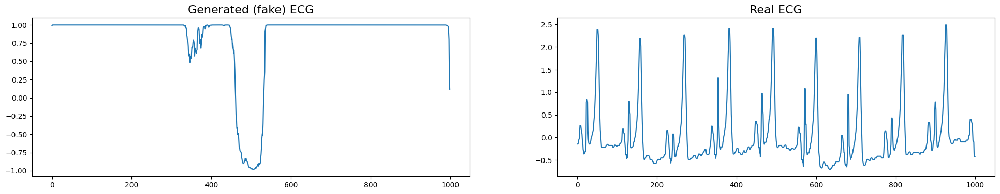

Epoch 3401/5000
Generator loss: 0.9088493585586548
Discriminator loss: 28837122.0
-------------------
Epoch 3402/5000
Generator loss: 0.9295151233673096
Discriminator loss: 28809666.0
-------------------
Epoch 3403/5000
Generator loss: 0.9074775576591492
Discriminator loss: 29536730.0
-------------------
Epoch 3404/5000
Generator loss: 0.9255549311637878
Discriminator loss: 28683250.0
-------------------
Epoch 3405/5000
Generator loss: 0.9180546998977661
Discriminator loss: 29923070.0
-------------------
Epoch 3406/5000
Generator loss: 0.9528303146362305
Discriminator loss: 29062832.0
-------------------
Epoch 3407/5000
Generator loss: 0.9214175939559937
Discriminator loss: 27916184.0
-------------------
Epoch 3408/5000
Generator loss: 0.9277404546737671
Discriminator loss: 29848124.0
-------------------
Epoch 3409/5000
Generator loss: 0.9316428303718567
Discriminator loss: 28394750.0
-------------------
Epoch 3410/5000
Generator loss: 0.912170946598053
Discriminator loss: 28068020.0
-

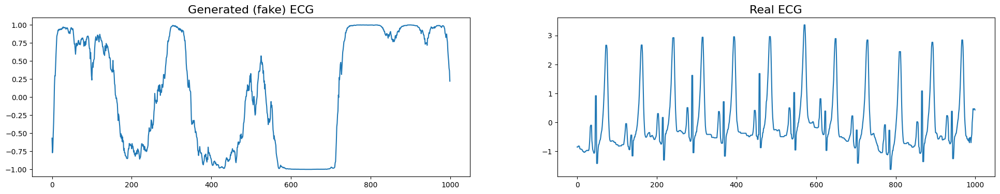

Epoch 3451/5000
Generator loss: 0.9073429703712463
Discriminator loss: 28871768.0
-------------------
Epoch 3452/5000
Generator loss: 0.9246941208839417
Discriminator loss: 29414718.0
-------------------
Epoch 3453/5000
Generator loss: 0.9202885627746582
Discriminator loss: 27517262.0
-------------------
Epoch 3454/5000
Generator loss: 0.9289722442626953
Discriminator loss: 27881458.0
-------------------
Epoch 3455/5000
Generator loss: 0.9011068344116211
Discriminator loss: 29291030.0
-------------------
Epoch 3456/5000
Generator loss: 0.9089385271072388
Discriminator loss: 28243208.0
-------------------
Epoch 3457/5000
Generator loss: 0.9153209924697876
Discriminator loss: 28764128.0
-------------------
Epoch 3458/5000
Generator loss: 0.9077076315879822
Discriminator loss: 28469754.0
-------------------
Epoch 3459/5000
Generator loss: 0.951980471611023
Discriminator loss: 28301198.0
-------------------
Epoch 3460/5000
Generator loss: 0.9094076156616211
Discriminator loss: 28633198.0
-

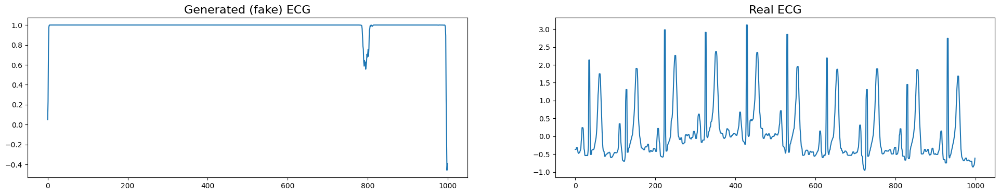

Epoch 3501/5000
Generator loss: 0.9197074174880981
Discriminator loss: 29828924.0
-------------------
Epoch 3502/5000
Generator loss: 0.9538437128067017
Discriminator loss: 30079258.0
-------------------
Epoch 3503/5000
Generator loss: 0.9036495089530945
Discriminator loss: 28592690.0
-------------------
Epoch 3504/5000
Generator loss: 0.8795650005340576
Discriminator loss: 29418938.0
-------------------
Epoch 3505/5000
Generator loss: 0.8933879137039185
Discriminator loss: 29437652.0
-------------------
Epoch 3506/5000
Generator loss: 0.9004364013671875
Discriminator loss: 29796930.0
-------------------
Epoch 3507/5000
Generator loss: 0.8925763368606567
Discriminator loss: 29368034.0
-------------------
Epoch 3508/5000
Generator loss: 0.9179697036743164
Discriminator loss: 29110856.0
-------------------
Epoch 3509/5000
Generator loss: 0.9278402924537659
Discriminator loss: 28760984.0
-------------------
Epoch 3510/5000
Generator loss: 0.941970944404602
Discriminator loss: 28444952.0
-

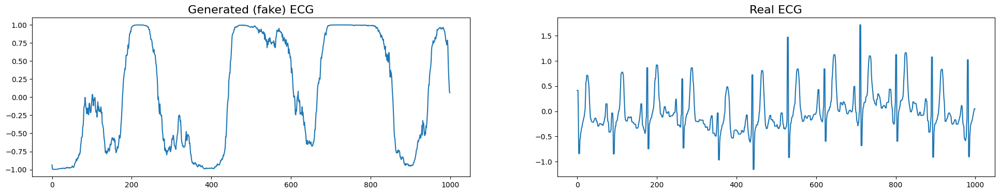

Epoch 3551/5000
Generator loss: 0.9686546325683594
Discriminator loss: 30175782.0
-------------------
Epoch 3552/5000
Generator loss: 0.9247773289680481
Discriminator loss: 29163188.0
-------------------
Epoch 3553/5000
Generator loss: 0.9388511776924133
Discriminator loss: 29800166.0
-------------------
Epoch 3554/5000
Generator loss: 0.9045805931091309
Discriminator loss: 29881370.0
-------------------
Epoch 3555/5000
Generator loss: 0.9360305070877075
Discriminator loss: 30053732.0
-------------------
Epoch 3556/5000
Generator loss: 0.887924313545227
Discriminator loss: 28606450.0
-------------------
Epoch 3557/5000
Generator loss: 0.8957711458206177
Discriminator loss: 29107370.0
-------------------
Epoch 3558/5000
Generator loss: 0.9441353678703308
Discriminator loss: 28314422.0
-------------------
Epoch 3559/5000
Generator loss: 0.9199104309082031
Discriminator loss: 28371632.0
-------------------
Epoch 3560/5000
Generator loss: 0.947185754776001
Discriminator loss: 28884104.0
--

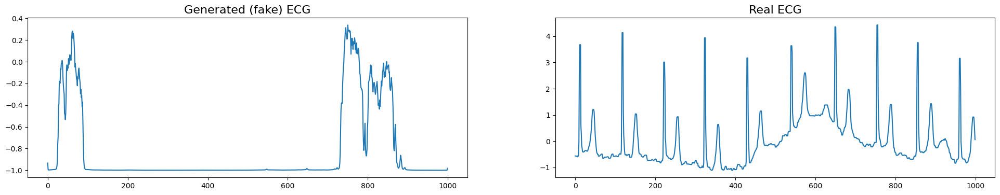

Epoch 3601/5000
Generator loss: 0.913293719291687
Discriminator loss: 28230110.0
-------------------
Epoch 3602/5000
Generator loss: 0.9297049641609192
Discriminator loss: 29547752.0
-------------------
Epoch 3603/5000
Generator loss: 0.9262442588806152
Discriminator loss: 29509832.0
-------------------
Epoch 3604/5000
Generator loss: 0.9199965000152588
Discriminator loss: 26694722.0
-------------------
Epoch 3605/5000
Generator loss: 0.9068952798843384
Discriminator loss: 30580958.0
-------------------
Epoch 3606/5000
Generator loss: 0.9098441004753113
Discriminator loss: 29419278.0
-------------------
Epoch 3607/5000
Generator loss: 0.9453563690185547
Discriminator loss: 29720182.0
-------------------
Epoch 3608/5000
Generator loss: 0.9158626198768616
Discriminator loss: 28686586.0
-------------------
Epoch 3609/5000
Generator loss: 0.9322398900985718
Discriminator loss: 30339770.0
-------------------
Epoch 3610/5000
Generator loss: 0.9296256303787231
Discriminator loss: 27130982.0
-

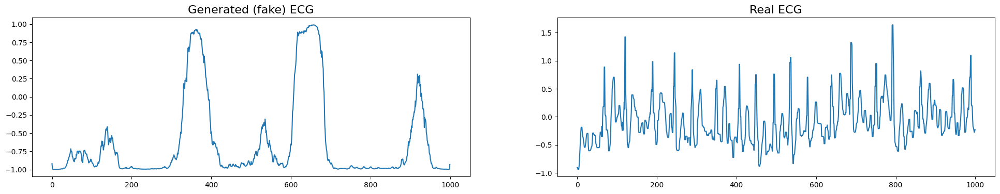

Epoch 3651/5000
Generator loss: 0.9218820333480835
Discriminator loss: 29716892.0
-------------------
Epoch 3652/5000
Generator loss: 0.9504280090332031
Discriminator loss: 27705502.0
-------------------
Epoch 3653/5000
Generator loss: 0.9483315348625183
Discriminator loss: 30100402.0
-------------------
Epoch 3654/5000
Generator loss: 0.9037461280822754
Discriminator loss: 29388906.0
-------------------
Epoch 3655/5000
Generator loss: 0.9585371017456055
Discriminator loss: 30691688.0
-------------------
Epoch 3656/5000
Generator loss: 0.8757065534591675
Discriminator loss: 27947594.0
-------------------
Epoch 3657/5000
Generator loss: 0.9454634189605713
Discriminator loss: 29535766.0
-------------------
Epoch 3658/5000
Generator loss: 0.9051524996757507
Discriminator loss: 28551566.0
-------------------
Epoch 3659/5000
Generator loss: 0.885219395160675
Discriminator loss: 30067210.0
-------------------
Epoch 3660/5000
Generator loss: 0.9279592633247375
Discriminator loss: 29285462.0
-

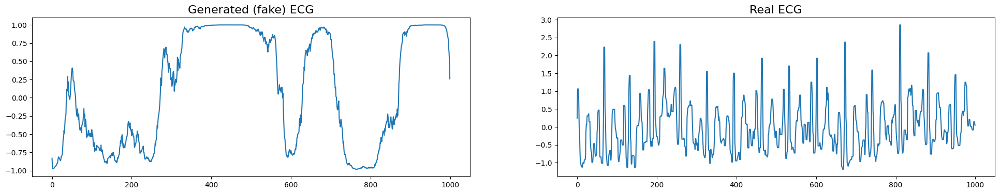

Epoch 3701/5000
Generator loss: 0.8967398405075073
Discriminator loss: 29284750.0
-------------------
Epoch 3702/5000
Generator loss: 0.9555277824401855
Discriminator loss: 26063962.0
-------------------
Epoch 3703/5000
Generator loss: 0.9036132097244263
Discriminator loss: 28976730.0
-------------------
Epoch 3704/5000
Generator loss: 0.9086638689041138
Discriminator loss: 28297642.0
-------------------
Epoch 3705/5000
Generator loss: 0.9073230624198914
Discriminator loss: 28912294.0
-------------------
Epoch 3706/5000
Generator loss: 0.9417473077774048
Discriminator loss: 28153966.0
-------------------
Epoch 3707/5000
Generator loss: 0.9120768904685974
Discriminator loss: 29325836.0
-------------------
Epoch 3708/5000
Generator loss: 0.9082614183425903
Discriminator loss: 28252546.0
-------------------
Epoch 3709/5000
Generator loss: 0.9323801398277283
Discriminator loss: 27990764.0
-------------------
Epoch 3710/5000
Generator loss: 0.918013870716095
Discriminator loss: 28119134.0
-

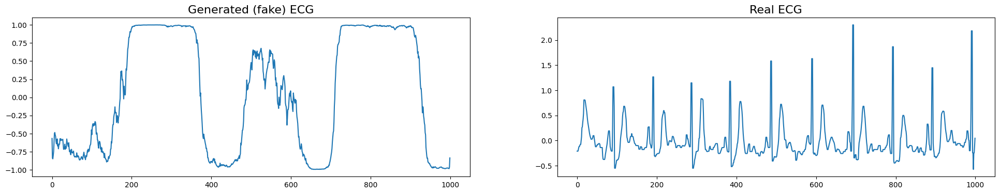

Epoch 3751/5000
Generator loss: 0.9433901309967041
Discriminator loss: 30839228.0
-------------------
Epoch 3752/5000
Generator loss: 0.9633036851882935
Discriminator loss: 27399474.0
-------------------
Epoch 3753/5000
Generator loss: 0.9390273094177246
Discriminator loss: 31270954.0
-------------------
Epoch 3754/5000
Generator loss: 0.935302734375
Discriminator loss: 28057278.0
-------------------
Epoch 3755/5000
Generator loss: 0.9371094703674316
Discriminator loss: 27831176.0
-------------------
Epoch 3756/5000
Generator loss: 0.8946674466133118
Discriminator loss: 29291642.0
-------------------
Epoch 3757/5000
Generator loss: 0.9038638472557068
Discriminator loss: 27991646.0
-------------------
Epoch 3758/5000
Generator loss: 0.9020782709121704
Discriminator loss: 27908854.0
-------------------
Epoch 3759/5000
Generator loss: 0.9209258556365967
Discriminator loss: 29401058.0
-------------------
Epoch 3760/5000
Generator loss: 0.9262642860412598
Discriminator loss: 28834146.0
----

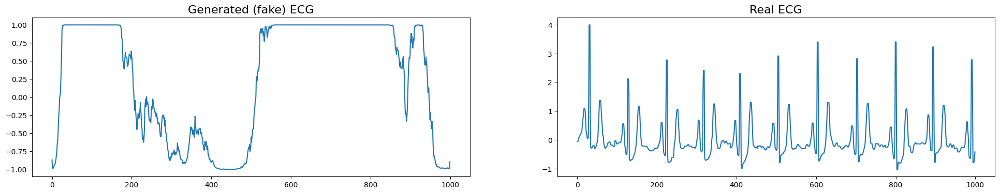

Epoch 3801/5000
Generator loss: 0.9378600120544434
Discriminator loss: 28792562.0
-------------------
Epoch 3802/5000
Generator loss: 0.9061700105667114
Discriminator loss: 29611568.0
-------------------
Epoch 3803/5000
Generator loss: 0.9585781097412109
Discriminator loss: 31066604.0
-------------------
Epoch 3804/5000
Generator loss: 0.9270281791687012
Discriminator loss: 28963618.0
-------------------
Epoch 3805/5000
Generator loss: 0.9046607613563538
Discriminator loss: 27745892.0
-------------------
Epoch 3806/5000
Generator loss: 0.9335447549819946
Discriminator loss: 30739082.0
-------------------
Epoch 3807/5000
Generator loss: 0.9544339776039124
Discriminator loss: 28913660.0
-------------------
Epoch 3808/5000
Generator loss: 0.9064263701438904
Discriminator loss: 30953630.0
-------------------
Epoch 3809/5000
Generator loss: 0.9410524964332581
Discriminator loss: 29989784.0
-------------------
Epoch 3810/5000
Generator loss: 0.9089546203613281
Discriminator loss: 27829610.0


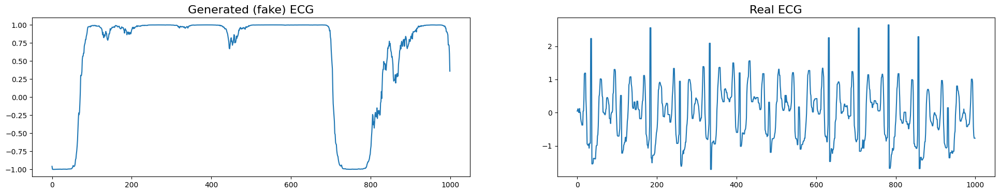

Epoch 3851/5000
Generator loss: 0.907944917678833
Discriminator loss: 27911774.0
-------------------
Epoch 3852/5000
Generator loss: 0.8861639499664307
Discriminator loss: 30273694.0
-------------------
Epoch 3853/5000
Generator loss: 0.8904204368591309
Discriminator loss: 29860940.0
-------------------
Epoch 3854/5000
Generator loss: 0.9449959993362427
Discriminator loss: 29592686.0
-------------------
Epoch 3855/5000
Generator loss: 0.9204006195068359
Discriminator loss: 29297438.0
-------------------
Epoch 3856/5000
Generator loss: 0.9299222230911255
Discriminator loss: 29542316.0
-------------------
Epoch 3857/5000
Generator loss: 0.891560435295105
Discriminator loss: 26751778.0
-------------------
Epoch 3858/5000
Generator loss: 0.9593487977981567
Discriminator loss: 31156598.0
-------------------
Epoch 3859/5000
Generator loss: 0.9064877033233643
Discriminator loss: 28042638.0
-------------------
Epoch 3860/5000
Generator loss: 0.9373475313186646
Discriminator loss: 30204890.0
--

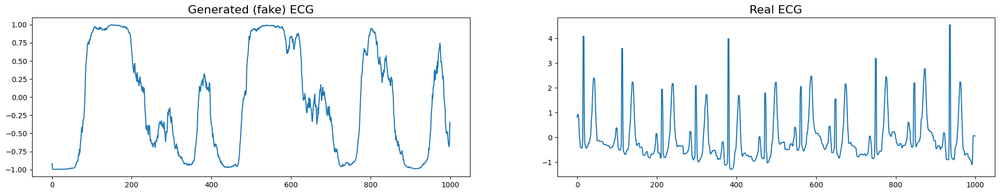

Epoch 3901/5000
Generator loss: 0.8980733752250671
Discriminator loss: 29416952.0
-------------------
Epoch 3902/5000
Generator loss: 0.9181086421012878
Discriminator loss: 29493010.0
-------------------
Epoch 3903/5000
Generator loss: 0.9189804792404175
Discriminator loss: 28403390.0
-------------------
Epoch 3904/5000
Generator loss: 0.885539174079895
Discriminator loss: 28072846.0
-------------------
Epoch 3905/5000
Generator loss: 0.9407047629356384
Discriminator loss: 30773262.0
-------------------
Epoch 3906/5000
Generator loss: 0.9569798707962036
Discriminator loss: 27901190.0
-------------------
Epoch 3907/5000
Generator loss: 0.909072995185852
Discriminator loss: 29676380.0
-------------------
Epoch 3908/5000
Generator loss: 0.9195512533187866
Discriminator loss: 28700588.0
-------------------
Epoch 3909/5000
Generator loss: 0.9468432664871216
Discriminator loss: 27792968.0
-------------------
Epoch 3910/5000
Generator loss: 0.9733718633651733
Discriminator loss: 29815630.0
--

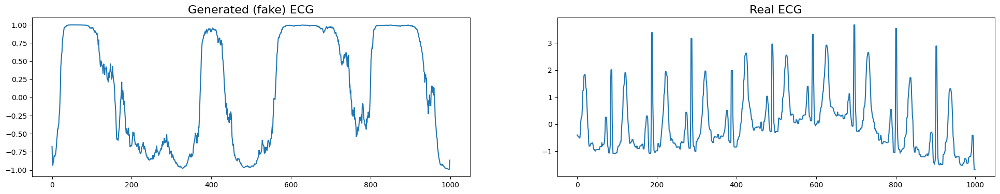

Epoch 3951/5000
Generator loss: 0.9515179395675659
Discriminator loss: 28381682.0
-------------------
Epoch 3952/5000
Generator loss: 0.9265557527542114
Discriminator loss: 28520650.0
-------------------
Epoch 3953/5000
Generator loss: 0.9677831530570984
Discriminator loss: 27464966.0
-------------------
Epoch 3954/5000
Generator loss: 0.9313851594924927
Discriminator loss: 28479334.0
-------------------
Epoch 3955/5000
Generator loss: 0.9389558434486389
Discriminator loss: 29892854.0
-------------------
Epoch 3956/5000
Generator loss: 0.9118176698684692
Discriminator loss: 27431442.0
-------------------
Epoch 3957/5000
Generator loss: 0.893418550491333
Discriminator loss: 29412042.0
-------------------
Epoch 3958/5000
Generator loss: 0.9489821195602417
Discriminator loss: 27902590.0
-------------------
Epoch 3959/5000
Generator loss: 0.8976798057556152
Discriminator loss: 28214250.0
-------------------
Epoch 3960/5000
Generator loss: 0.9609651565551758
Discriminator loss: 28974458.0
-

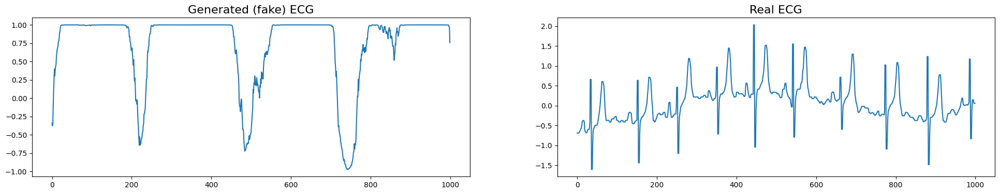

Epoch 4001/5000
Generator loss: 0.9116754531860352
Discriminator loss: 27276394.0
-------------------
Epoch 4002/5000
Generator loss: 0.9362711906433105
Discriminator loss: 29642522.0
-------------------
Epoch 4003/5000
Generator loss: 0.9554901123046875
Discriminator loss: 28415696.0
-------------------
Epoch 4004/5000
Generator loss: 0.953675389289856
Discriminator loss: 30670994.0
-------------------
Epoch 4005/5000
Generator loss: 0.877700686454773
Discriminator loss: 29829956.0
-------------------
Epoch 4006/5000
Generator loss: 0.9266455173492432
Discriminator loss: 29153534.0
-------------------
Epoch 4007/5000
Generator loss: 0.9603829979896545
Discriminator loss: 30759674.0
-------------------
Epoch 4008/5000
Generator loss: 0.9106909036636353
Discriminator loss: 29930168.0
-------------------
Epoch 4009/5000
Generator loss: 0.9328545928001404
Discriminator loss: 27983432.0
-------------------
Epoch 4010/5000
Generator loss: 0.8929071426391602
Discriminator loss: 28023238.0
--

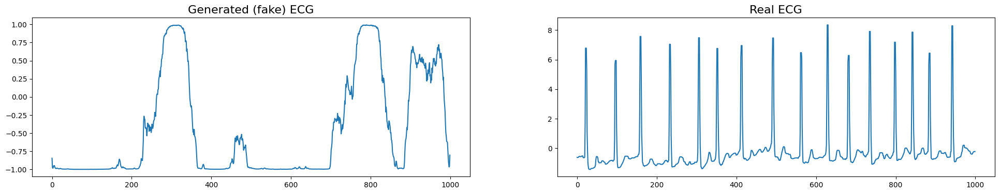

Epoch 4051/5000
Generator loss: 0.9466780424118042
Discriminator loss: 28731910.0
-------------------
Epoch 4052/5000
Generator loss: 0.930081307888031
Discriminator loss: 28031306.0
-------------------
Epoch 4053/5000
Generator loss: 0.9428340792655945
Discriminator loss: 30667994.0
-------------------
Epoch 4054/5000
Generator loss: 0.9384963512420654
Discriminator loss: 29935610.0
-------------------
Epoch 4055/5000
Generator loss: 0.9209494590759277
Discriminator loss: 28087598.0
-------------------
Epoch 4056/5000
Generator loss: 0.9204758405685425
Discriminator loss: 29204960.0
-------------------
Epoch 4057/5000
Generator loss: 0.9499480724334717
Discriminator loss: 29540530.0
-------------------
Epoch 4058/5000
Generator loss: 0.9074273109436035
Discriminator loss: 27616022.0
-------------------
Epoch 4059/5000
Generator loss: 0.9517876505851746
Discriminator loss: 28915400.0
-------------------
Epoch 4060/5000
Generator loss: 0.9353765249252319
Discriminator loss: 29775824.0
-

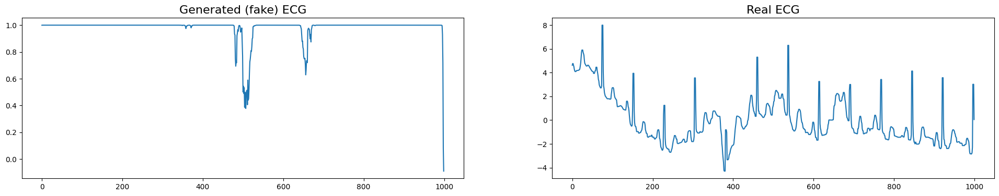

Epoch 4101/5000
Generator loss: 0.9610694646835327
Discriminator loss: 28540460.0
-------------------
Epoch 4102/5000
Generator loss: 0.9162315726280212
Discriminator loss: 29175810.0
-------------------
Epoch 4103/5000
Generator loss: 0.9300770163536072
Discriminator loss: 28037046.0
-------------------
Epoch 4104/5000
Generator loss: 0.9123138189315796
Discriminator loss: 27135714.0
-------------------
Epoch 4105/5000
Generator loss: 0.8862462043762207
Discriminator loss: 27049016.0
-------------------
Epoch 4106/5000
Generator loss: 0.9152446985244751
Discriminator loss: 29655342.0
-------------------
Epoch 4107/5000
Generator loss: 0.924662709236145
Discriminator loss: 30072354.0
-------------------
Epoch 4108/5000
Generator loss: 0.9265866875648499
Discriminator loss: 29090612.0
-------------------
Epoch 4109/5000
Generator loss: 0.9582720398902893
Discriminator loss: 29589338.0
-------------------
Epoch 4110/5000
Generator loss: 0.9538241624832153
Discriminator loss: 28167210.0
-

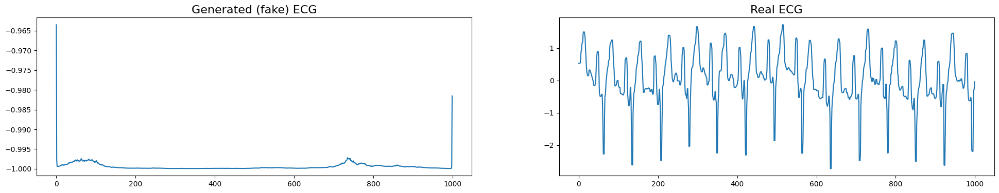

Epoch 4151/5000
Generator loss: 0.8967272043228149
Discriminator loss: 26955666.0
-------------------
Epoch 4152/5000
Generator loss: 0.9346345663070679
Discriminator loss: 28758344.0
-------------------
Epoch 4153/5000
Generator loss: 0.8988503813743591
Discriminator loss: 29827402.0
-------------------
Epoch 4154/5000
Generator loss: 0.9548994302749634
Discriminator loss: 30528776.0
-------------------
Epoch 4155/5000
Generator loss: 0.9354315996170044
Discriminator loss: 29467674.0
-------------------
Epoch 4156/5000
Generator loss: 0.9276522397994995
Discriminator loss: 29973866.0
-------------------
Epoch 4157/5000
Generator loss: 0.9417847394943237
Discriminator loss: 29622886.0
-------------------
Epoch 4158/5000
Generator loss: 0.8845275640487671
Discriminator loss: 27692122.0
-------------------
Epoch 4159/5000
Generator loss: 0.9273617267608643
Discriminator loss: 28525706.0
-------------------
Epoch 4160/5000
Generator loss: 0.941374659538269
Discriminator loss: 29681684.0
-

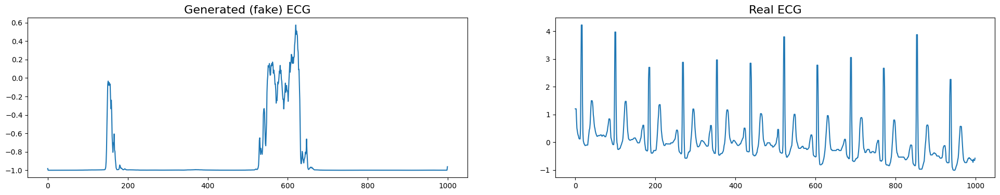

Epoch 4201/5000
Generator loss: 0.9246019124984741
Discriminator loss: 27926546.0
-------------------
Epoch 4202/5000
Generator loss: 0.9022645354270935
Discriminator loss: 27172546.0
-------------------
Epoch 4203/5000
Generator loss: 0.905142605304718
Discriminator loss: 28277638.0
-------------------
Epoch 4204/5000
Generator loss: 0.9051351547241211
Discriminator loss: 28112254.0
-------------------
Epoch 4205/5000
Generator loss: 0.9292225241661072
Discriminator loss: 28281230.0
-------------------
Epoch 4206/5000
Generator loss: 0.9363164901733398
Discriminator loss: 28484048.0
-------------------
Epoch 4207/5000
Generator loss: 0.9497964382171631
Discriminator loss: 29731154.0
-------------------
Epoch 4208/5000
Generator loss: 0.9196794629096985
Discriminator loss: 30910514.0
-------------------
Epoch 4209/5000
Generator loss: 0.8825554847717285
Discriminator loss: 26958770.0
-------------------
Epoch 4210/5000
Generator loss: 0.9031599760055542
Discriminator loss: 29521190.0
-

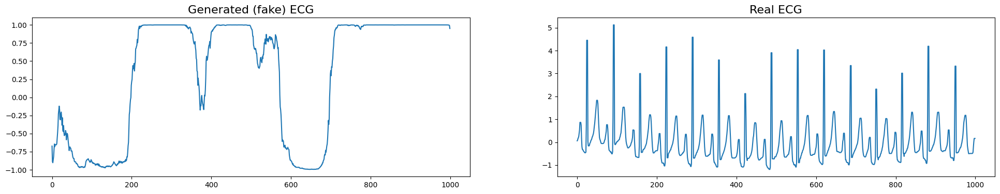

Epoch 4251/5000
Generator loss: 0.9166734218597412
Discriminator loss: 28727774.0
-------------------
Epoch 4252/5000
Generator loss: 0.919347882270813
Discriminator loss: 27818414.0
-------------------
Epoch 4253/5000
Generator loss: 0.9057983160018921
Discriminator loss: 29332126.0
-------------------
Epoch 4254/5000
Generator loss: 0.907528817653656
Discriminator loss: 29265044.0
-------------------
Epoch 4255/5000
Generator loss: 0.9407413005828857
Discriminator loss: 27647858.0
-------------------
Epoch 4256/5000
Generator loss: 0.9383350610733032
Discriminator loss: 29003246.0
-------------------
Epoch 4257/5000
Generator loss: 0.9417824745178223
Discriminator loss: 29258000.0
-------------------
Epoch 4258/5000
Generator loss: 0.9376814365386963
Discriminator loss: 28532110.0
-------------------
Epoch 4259/5000
Generator loss: 0.9025484919548035
Discriminator loss: 28923522.0
-------------------
Epoch 4260/5000
Generator loss: 0.9328975081443787
Discriminator loss: 28348726.0
--

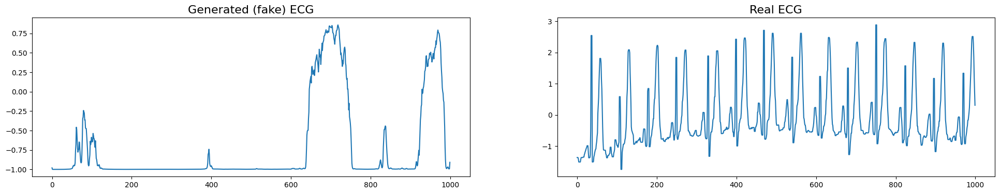

Epoch 4301/5000
Generator loss: 0.9031823873519897
Discriminator loss: 27881734.0
-------------------
Epoch 4302/5000
Generator loss: 0.9241758584976196
Discriminator loss: 28996622.0
-------------------
Epoch 4303/5000
Generator loss: 0.9111315011978149
Discriminator loss: 26135446.0
-------------------
Epoch 4304/5000
Generator loss: 0.894353449344635
Discriminator loss: 28359080.0
-------------------
Epoch 4305/5000
Generator loss: 0.8910665512084961
Discriminator loss: 28363250.0
-------------------
Epoch 4306/5000
Generator loss: 0.9070667028427124
Discriminator loss: 28447982.0
-------------------
Epoch 4307/5000
Generator loss: 0.9241471290588379
Discriminator loss: 29922164.0
-------------------
Epoch 4308/5000
Generator loss: 0.9218260049819946
Discriminator loss: 29716364.0
-------------------
Epoch 4309/5000
Generator loss: 0.9020774364471436
Discriminator loss: 29256742.0
-------------------
Epoch 4310/5000
Generator loss: 0.9312379360198975
Discriminator loss: 29676842.0
-

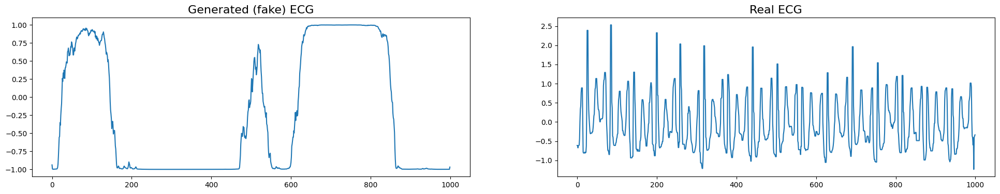

Epoch 4351/5000
Generator loss: 0.9399725794792175
Discriminator loss: 29793476.0
-------------------
Epoch 4352/5000
Generator loss: 0.8829466104507446
Discriminator loss: 28147604.0
-------------------
Epoch 4353/5000
Generator loss: 0.9211472272872925
Discriminator loss: 28961090.0
-------------------
Epoch 4354/5000
Generator loss: 0.9432888031005859
Discriminator loss: 28334336.0
-------------------
Epoch 4355/5000
Generator loss: 0.9100162982940674
Discriminator loss: 29540882.0
-------------------
Epoch 4356/5000
Generator loss: 0.896614670753479
Discriminator loss: 28386290.0
-------------------
Epoch 4357/5000
Generator loss: 0.9020249843597412
Discriminator loss: 29011628.0
-------------------
Epoch 4358/5000
Generator loss: 0.9403050541877747
Discriminator loss: 30996014.0
-------------------
Epoch 4359/5000
Generator loss: 0.9168617725372314
Discriminator loss: 29262230.0
-------------------
Epoch 4360/5000
Generator loss: 0.8905600309371948
Discriminator loss: 29534922.0
-

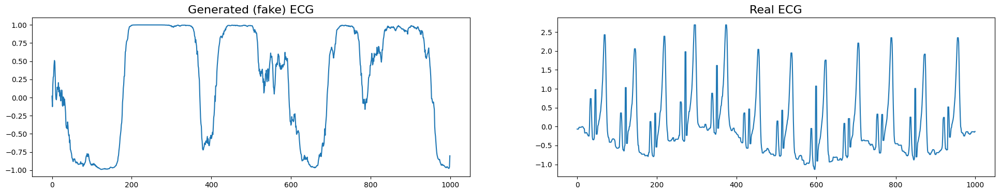

Epoch 4401/5000
Generator loss: 0.8880420923233032
Discriminator loss: 27200402.0
-------------------
Epoch 4402/5000
Generator loss: 0.91729736328125
Discriminator loss: 28337990.0
-------------------
Epoch 4403/5000
Generator loss: 0.918124794960022
Discriminator loss: 29486010.0
-------------------
Epoch 4404/5000
Generator loss: 0.924799919128418
Discriminator loss: 30460208.0
-------------------
Epoch 4405/5000
Generator loss: 0.9664821624755859
Discriminator loss: 29183634.0
-------------------
Epoch 4406/5000
Generator loss: 0.9227381944656372
Discriminator loss: 28887692.0
-------------------
Epoch 4407/5000
Generator loss: 0.9038485288619995
Discriminator loss: 28775094.0
-------------------
Epoch 4408/5000
Generator loss: 0.9356318712234497
Discriminator loss: 28003814.0
-------------------
Epoch 4409/5000
Generator loss: 0.9148733615875244
Discriminator loss: 30767182.0
-------------------
Epoch 4410/5000
Generator loss: 0.9203610420227051
Discriminator loss: 28038914.0
----

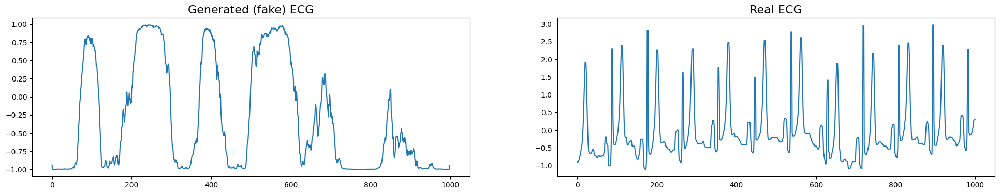

Epoch 4451/5000
Generator loss: 0.9383726119995117
Discriminator loss: 29647712.0
-------------------
Epoch 4452/5000
Generator loss: 0.9298893213272095
Discriminator loss: 29904680.0
-------------------
Epoch 4453/5000
Generator loss: 0.9004100561141968
Discriminator loss: 29354132.0
-------------------
Epoch 4454/5000
Generator loss: 0.9217928647994995
Discriminator loss: 28519886.0
-------------------
Epoch 4455/5000
Generator loss: 0.9319702386856079
Discriminator loss: 30535016.0
-------------------
Epoch 4456/5000
Generator loss: 0.9128953218460083
Discriminator loss: 30267596.0
-------------------
Epoch 4457/5000
Generator loss: 0.9417866468429565
Discriminator loss: 30477260.0
-------------------
Epoch 4458/5000
Generator loss: 0.8872961401939392
Discriminator loss: 28531446.0
-------------------
Epoch 4459/5000
Generator loss: 0.907462477684021
Discriminator loss: 29268158.0
-------------------
Epoch 4460/5000
Generator loss: 0.9160017371177673
Discriminator loss: 30448390.0
-

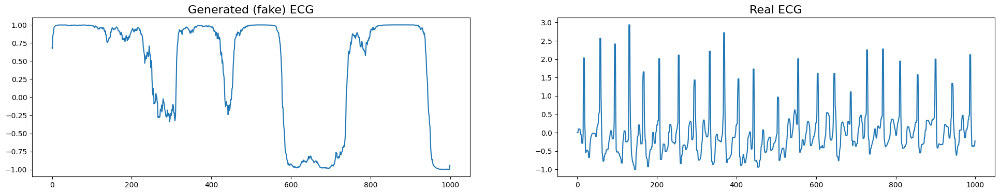

Epoch 4501/5000
Generator loss: 0.9425922632217407
Discriminator loss: 29316582.0
-------------------
Epoch 4502/5000
Generator loss: 0.895419716835022
Discriminator loss: 27080274.0
-------------------
Epoch 4503/5000
Generator loss: 0.9307262897491455
Discriminator loss: 29207192.0
-------------------
Epoch 4504/5000
Generator loss: 0.9355666637420654
Discriminator loss: 30181390.0
-------------------
Epoch 4505/5000
Generator loss: 0.9131474494934082
Discriminator loss: 28989934.0
-------------------
Epoch 4506/5000
Generator loss: 0.9007977247238159
Discriminator loss: 28876460.0
-------------------
Epoch 4507/5000
Generator loss: 0.9069991111755371
Discriminator loss: 28950800.0
-------------------
Epoch 4508/5000
Generator loss: 0.9063287973403931
Discriminator loss: 29167172.0
-------------------
Epoch 4509/5000
Generator loss: 0.8921316862106323
Discriminator loss: 28511444.0
-------------------
Epoch 4510/5000
Generator loss: 0.9675713777542114
Discriminator loss: 28325406.0
-

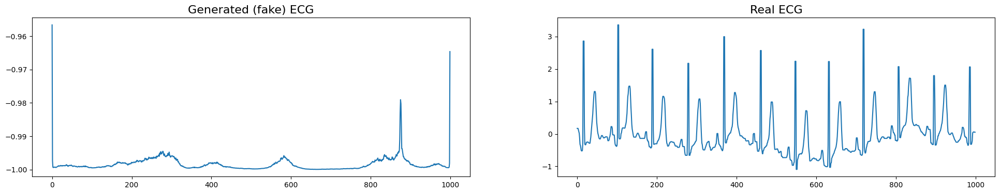

Epoch 4551/5000
Generator loss: 0.9003936052322388
Discriminator loss: 28367202.0
-------------------
Epoch 4552/5000
Generator loss: 0.8881155252456665
Discriminator loss: 27751902.0
-------------------
Epoch 4553/5000
Generator loss: 0.9059798717498779
Discriminator loss: 28700258.0
-------------------
Epoch 4554/5000
Generator loss: 0.9105468988418579
Discriminator loss: 28655060.0
-------------------
Epoch 4555/5000
Generator loss: 0.9282749891281128
Discriminator loss: 28419302.0
-------------------
Epoch 4556/5000
Generator loss: 0.9353984594345093
Discriminator loss: 29119806.0
-------------------
Epoch 4557/5000
Generator loss: 0.9157838225364685
Discriminator loss: 26616020.0
-------------------
Epoch 4558/5000
Generator loss: 0.9057412147521973
Discriminator loss: 27995450.0
-------------------
Epoch 4559/5000
Generator loss: 0.907114565372467
Discriminator loss: 27266732.0
-------------------
Epoch 4560/5000
Generator loss: 0.9247097969055176
Discriminator loss: 28892278.0
-

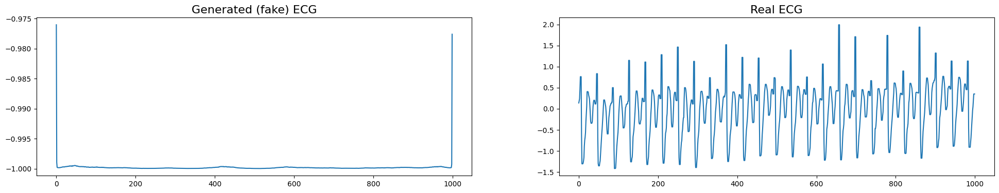

Epoch 4601/5000
Generator loss: 0.9097423553466797
Discriminator loss: 28204220.0
-------------------
Epoch 4602/5000
Generator loss: 0.930252194404602
Discriminator loss: 28926848.0
-------------------
Epoch 4603/5000
Generator loss: 0.9166215658187866
Discriminator loss: 27812174.0
-------------------
Epoch 4604/5000
Generator loss: 0.919142484664917
Discriminator loss: 28023908.0
-------------------
Epoch 4605/5000
Generator loss: 0.9257622957229614
Discriminator loss: 29485194.0
-------------------
Epoch 4606/5000
Generator loss: 0.9289893507957458
Discriminator loss: 27520532.0
-------------------
Epoch 4607/5000
Generator loss: 0.9305213093757629
Discriminator loss: 27406514.0
-------------------
Epoch 4608/5000
Generator loss: 0.9257461428642273
Discriminator loss: 29696732.0
-------------------
Epoch 4609/5000
Generator loss: 0.9389307498931885
Discriminator loss: 29419390.0
-------------------
Epoch 4610/5000
Generator loss: 0.9275177717208862
Discriminator loss: 29334738.0
--

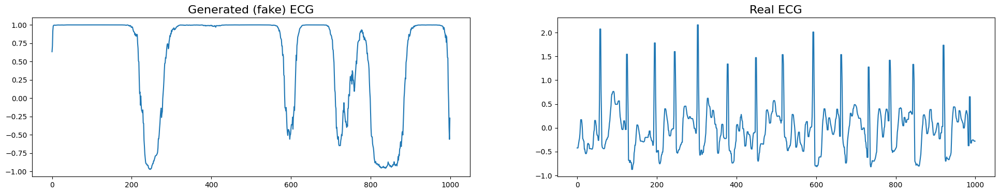

Epoch 4651/5000
Generator loss: 0.9132552146911621
Discriminator loss: 27476738.0
-------------------
Epoch 4652/5000
Generator loss: 0.8880915641784668
Discriminator loss: 28672862.0
-------------------
Epoch 4653/5000
Generator loss: 0.9080700874328613
Discriminator loss: 28821306.0
-------------------
Epoch 4654/5000
Generator loss: 0.9240410327911377
Discriminator loss: 29896724.0
-------------------
Epoch 4655/5000
Generator loss: 0.9423320889472961
Discriminator loss: 28230902.0
-------------------
Epoch 4656/5000
Generator loss: 0.9080723524093628
Discriminator loss: 28438514.0
-------------------
Epoch 4657/5000
Generator loss: 0.8989964723587036
Discriminator loss: 28523354.0
-------------------
Epoch 4658/5000
Generator loss: 0.9326714873313904
Discriminator loss: 28753314.0
-------------------
Epoch 4659/5000
Generator loss: 0.9133663177490234
Discriminator loss: 29574770.0
-------------------
Epoch 4660/5000
Generator loss: 0.9158657193183899
Discriminator loss: 28280072.0


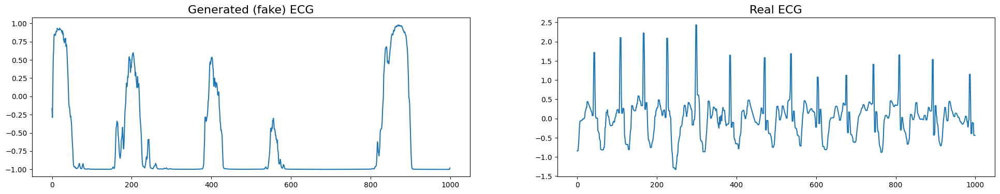

Epoch 4701/5000
Generator loss: 0.8991271257400513
Discriminator loss: 29406200.0
-------------------
Epoch 4702/5000
Generator loss: 0.9503581523895264
Discriminator loss: 28495678.0
-------------------
Epoch 4703/5000
Generator loss: 0.9411239624023438
Discriminator loss: 28798838.0
-------------------
Epoch 4704/5000
Generator loss: 0.9262070059776306
Discriminator loss: 27469726.0
-------------------
Epoch 4705/5000
Generator loss: 0.8891083002090454
Discriminator loss: 25686082.0
-------------------
Epoch 4706/5000
Generator loss: 0.9361026287078857
Discriminator loss: 28234748.0
-------------------
Epoch 4707/5000
Generator loss: 0.9194093942642212
Discriminator loss: 27454238.0
-------------------
Epoch 4708/5000
Generator loss: 0.9098799824714661
Discriminator loss: 30864068.0
-------------------
Epoch 4709/5000
Generator loss: 0.9192479848861694
Discriminator loss: 29497214.0
-------------------
Epoch 4710/5000
Generator loss: 0.9138974547386169
Discriminator loss: 28526396.0


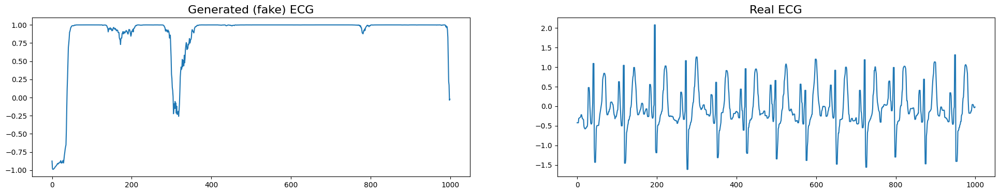

Epoch 4751/5000
Generator loss: 0.9094994068145752
Discriminator loss: 28256178.0
-------------------
Epoch 4752/5000
Generator loss: 0.8981965780258179
Discriminator loss: 29966060.0
-------------------
Epoch 4753/5000
Generator loss: 0.8968324661254883
Discriminator loss: 28770446.0
-------------------
Epoch 4754/5000
Generator loss: 0.9673588275909424
Discriminator loss: 30283834.0
-------------------
Epoch 4755/5000
Generator loss: 0.8993644714355469
Discriminator loss: 29026400.0
-------------------
Epoch 4756/5000
Generator loss: 0.9170138835906982
Discriminator loss: 30031700.0
-------------------
Epoch 4757/5000
Generator loss: 0.9583041071891785
Discriminator loss: 27812970.0
-------------------
Epoch 4758/5000
Generator loss: 0.9040884375572205
Discriminator loss: 28910142.0
-------------------
Epoch 4759/5000
Generator loss: 0.9138159155845642
Discriminator loss: 28920584.0
-------------------
Epoch 4760/5000
Generator loss: 0.9065260887145996
Discriminator loss: 29624300.0


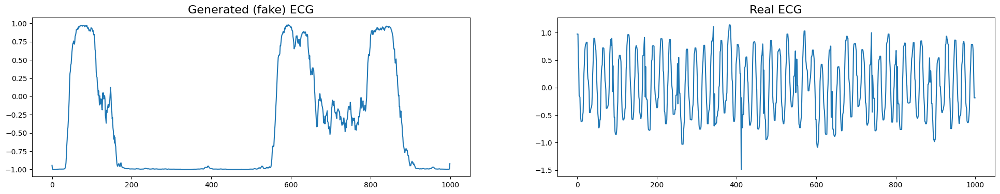

Epoch 4801/5000
Generator loss: 0.9279011487960815
Discriminator loss: 29600554.0
-------------------
Epoch 4802/5000
Generator loss: 0.903671383857727
Discriminator loss: 28762558.0
-------------------
Epoch 4803/5000
Generator loss: 0.9380263090133667
Discriminator loss: 29168582.0
-------------------
Epoch 4804/5000
Generator loss: 0.9206156134605408
Discriminator loss: 29159108.0
-------------------
Epoch 4805/5000
Generator loss: 0.9974582195281982
Discriminator loss: 30794588.0
-------------------
Epoch 4806/5000
Generator loss: 0.9378844499588013
Discriminator loss: 28546490.0
-------------------
Epoch 4807/5000
Generator loss: 0.9181687831878662
Discriminator loss: 28339502.0
-------------------
Epoch 4808/5000
Generator loss: 0.9466447830200195
Discriminator loss: 30170330.0
-------------------
Epoch 4809/5000
Generator loss: 0.9205791354179382
Discriminator loss: 29490356.0
-------------------
Epoch 4810/5000
Generator loss: 0.9272481203079224
Discriminator loss: 27548318.0
-

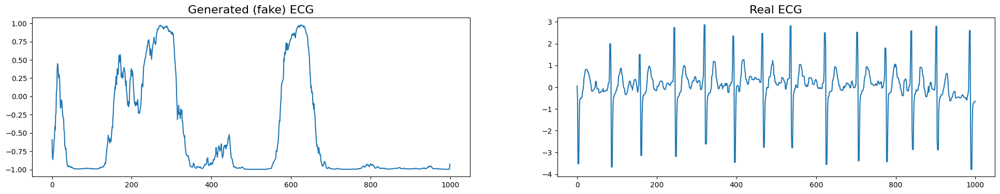

Epoch 4851/5000
Generator loss: 0.914935827255249
Discriminator loss: 29019418.0
-------------------
Epoch 4852/5000
Generator loss: 0.9005072116851807
Discriminator loss: 27670946.0
-------------------
Epoch 4853/5000
Generator loss: 0.9418062567710876
Discriminator loss: 28871534.0
-------------------
Epoch 4854/5000
Generator loss: 0.908180296421051
Discriminator loss: 26649006.0
-------------------
Epoch 4855/5000
Generator loss: 0.907446026802063
Discriminator loss: 27164324.0
-------------------
Epoch 4856/5000
Generator loss: 0.9174929857254028
Discriminator loss: 28653326.0
-------------------
Epoch 4857/5000
Generator loss: 0.9096914529800415
Discriminator loss: 28735592.0
-------------------
Epoch 4858/5000
Generator loss: 0.8977364301681519
Discriminator loss: 30888140.0
-------------------
Epoch 4859/5000
Generator loss: 0.9227931499481201
Discriminator loss: 28587882.0
-------------------
Epoch 4860/5000
Generator loss: 0.9085208177566528
Discriminator loss: 28735112.0
---

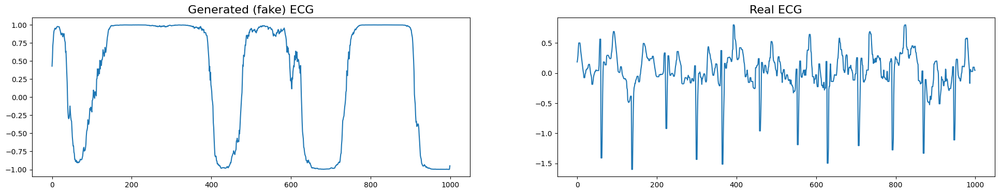

Epoch 4901/5000
Generator loss: 0.8926556706428528
Discriminator loss: 30279032.0
-------------------
Epoch 4902/5000
Generator loss: 0.946138322353363
Discriminator loss: 26508210.0
-------------------
Epoch 4903/5000
Generator loss: 0.9727038145065308
Discriminator loss: 29674082.0
-------------------
Epoch 4904/5000
Generator loss: 0.9446591138839722
Discriminator loss: 28541042.0
-------------------
Epoch 4905/5000
Generator loss: 0.9131662249565125
Discriminator loss: 29682758.0
-------------------
Epoch 4906/5000
Generator loss: 0.9190858006477356
Discriminator loss: 29264786.0
-------------------
Epoch 4907/5000
Generator loss: 0.9092073440551758
Discriminator loss: 28490168.0
-------------------
Epoch 4908/5000
Generator loss: 0.9114704132080078
Discriminator loss: 31929962.0
-------------------
Epoch 4909/5000
Generator loss: 0.9891080260276794
Discriminator loss: 29180806.0
-------------------
Epoch 4910/5000
Generator loss: 0.9044202566146851
Discriminator loss: 30076738.0
-

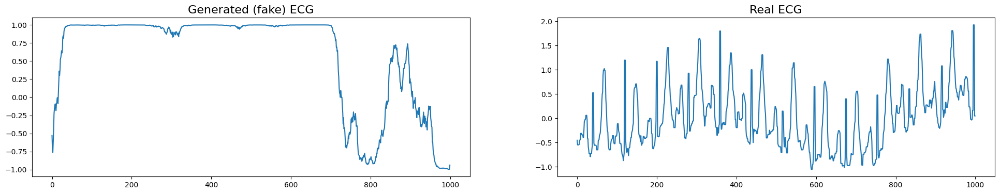

Epoch 4951/5000
Generator loss: 0.9373074173927307
Discriminator loss: 29662418.0
-------------------
Epoch 4952/5000
Generator loss: 0.9529843330383301
Discriminator loss: 27787042.0
-------------------
Epoch 4953/5000
Generator loss: 0.9019742012023926
Discriminator loss: 28389746.0
-------------------
Epoch 4954/5000
Generator loss: 0.9134559631347656
Discriminator loss: 29249192.0
-------------------
Epoch 4955/5000
Generator loss: 0.9245971441268921
Discriminator loss: 29295392.0
-------------------
Epoch 4956/5000
Generator loss: 0.9123817682266235
Discriminator loss: 28804256.0
-------------------
Epoch 4957/5000
Generator loss: 0.9327230453491211
Discriminator loss: 30862446.0
-------------------
Epoch 4958/5000
Generator loss: 0.9317830204963684
Discriminator loss: 29530006.0
-------------------
Epoch 4959/5000
Generator loss: 0.9311696290969849
Discriminator loss: 29704682.0
-------------------
Epoch 4960/5000
Generator loss: 0.909900426864624
Discriminator loss: 28809398.0
-

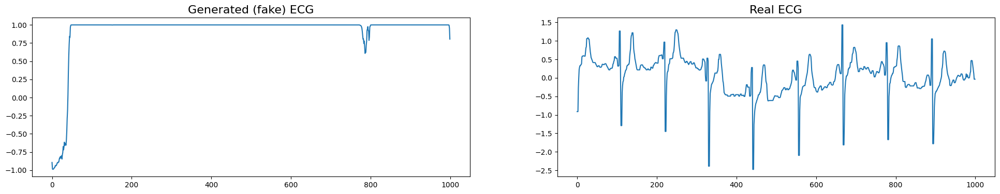

Saved generator weights to: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/inspectionmodel_generator_epoch_5000.weights.h5
Saved discriminator weights to: /home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data/inspectionmodel_discriminator_epoch_5000.weights.h5


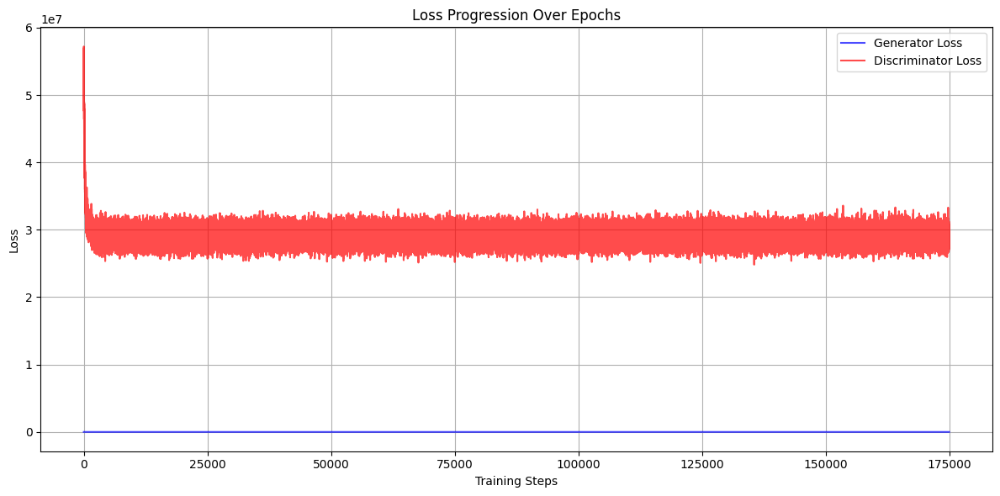

In [46]:
# Ensure TensorFlow sees and utilizes the GPU
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        # Set memory growth to prevent TensorFlow from allocating all GPU memory
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print(f"GPUs available: {len(gpus)}")
    except RuntimeError as e:
        print(f"Error configuring GPUs: {e}")
else:
    print("No GPUs available.")

# Enable logging for device placement (to see operations performed on GPU)
tf.debugging.set_log_device_placement(True)

# Gradient Clipping and Optimizer Definitions
clip_value = 1.0  # Clip gradients to this value

# Define optimizers with gradient clipping
opt_gen = tf.keras.optimizers.Adam(learning_rate=lr_schedule, clipvalue=clip_value)
opt_desc = tf.keras.optimizers.Adam(learning_rate=lr_schedule, clipvalue=clip_value)

# Updated train step
def train_step(real_data, labels):
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate fake data
        generated_data = con_gen([noise, labels], training=True)

        # Get discriminator outputs
        real_output = con_desc([real_data, labels], training=True)
        fake_output = con_desc([generated_data, labels], training=True)

        # Ensure the outputs are in the correct format
        real_output = real_output[0] if isinstance(real_output, list) else real_output
        fake_output = fake_output[0] if isinstance(fake_output, list) else fake_output

        # Smooth labels for training stability
        y_real_smooth = smooth_positive_labels(tf.ones_like(real_output)* 0.9)  # Same shape as real_output
        y_fake_smooth = smooth_negative_labels(tf.zeros_like(fake_output))  # Same shape as fake_output

        # Discriminator Loss
        disc_loss_real = tf.reduce_mean(tf.keras.losses.binary_crossentropy(y_real_smooth, real_output))
        disc_loss_fake = tf.reduce_mean(tf.keras.losses.binary_crossentropy(y_fake_smooth, fake_output))
        
        # Apply gradient penalty (WGAN)
        loss_gp = gradient_penalty_layer(real_data, generated_data, labels)
        disc_loss = disc_loss_real + disc_loss_fake + 3.0 * loss_gp  # Reduced gradient penalty

        # Generator Loss
        gen_loss = tf.reduce_mean(tf.keras.losses.binary_crossentropy(tf.ones_like(fake_output), fake_output))

        # Add Temporal Coherence Loss to Generator Loss
        tc_loss = temporal_coherence_loss(real_data, generated_data)
        gen_loss += tc_loss  # Add temporal coherence loss to the generator's total loss
        gen_loss += feature_matching_loss(real_output, fake_output)

    # Compute Gradients
    gradients_of_gen = gen_tape.gradient(gen_loss, con_gen.trainable_variables)
    gradients_of_disc = disc_tape.gradient(disc_loss, con_desc.trainable_variables)

    # Apply Gradients with clipping
    opt_gen.apply_gradients(zip(gradients_of_gen, con_gen.trainable_variables))
    opt_desc.apply_gradients(zip(gradients_of_disc, con_desc.trainable_variables))

    return gen_loss, disc_loss


# Training Loop with Discriminator-Generator Balance
for epoch in range(epochs):
    print(f"Epoch {epoch + 1}/{epochs}")

    for step in range(steps_per_epoch):
        # Generate real samples
        x_real, y_real = generate_real_samples(ECGs, y_train, batch_size)
        x_real_tensor = tf.convert_to_tensor(x_real, dtype=tf.float32)
        y_real_tensor = tf.convert_to_tensor(y_real, dtype=tf.float32)

        # Perform a training step
        gen_loss, disc_loss = train_step(x_real_tensor, y_real_tensor)

        # Store losses for tracking
        accu_loss_gan.append(gen_loss.numpy())
        accu_loss_desc.append(disc_loss.numpy())

    # Print the losses for the epoch
    print(f"Generator loss: {gen_loss.numpy()}")
    print(f"Discriminator loss: {disc_loss.numpy()}")
    print("-------------------")

    # Call the reduce learning rate callback manually after each epoch
    reduce_lr_gen.on_epoch_end(epoch, logs={'loss': gen_loss.numpy()})
    reduce_lr_desc.on_epoch_end(epoch, logs={'loss': disc_loss.numpy()})

    # Save generator and discriminator models periodically
    if (epoch + 1) % 50 == 0:
        res = con_gen.predict([generate_latent_points(latent_dim, 1), tf.convert_to_tensor(np.array([[0]]), dtype=tf.float32)])
        compare_real_and_gen_ecg(res, ECGs)

    # Save weights every 2000 epochs
    if (epoch + 1) % 5000 == 0:
        gen_save_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', f'inspectionmodel_generator_epoch_{epoch + 1}.weights.h5')
        desc_save_path = os.path.join('/home/arizmahm1/folder1/CGAN/PTBXL-AF-NORM Data', f'inspectionmodel_discriminator_epoch_{epoch + 1}.weights.h5')

        con_gen.save_weights(gen_save_path)
        con_desc.save_weights(desc_save_path)

        print(f'Saved generator weights to: {gen_save_path}')
        print(f'Saved discriminator weights to: {desc_save_path}')

# Plot Losses After Training
plt.figure(figsize=(12, 6))
plt.plot(accu_loss_gan, label='Generator Loss', color='blue', alpha=0.7)
plt.plot(accu_loss_desc, label='Discriminator Loss', color='red', alpha=0.7)
plt.title('Loss Progression Over Epochs')
plt.xlabel('Training Steps')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
